In [1]:
import numpy as np
# import shtns
import pylab as py
import matplotlib
from tqdm import tqdm
import sys
from scipy.signal import savgol_filter

sys.path.append('/data/pbarpanda/python_scripts/modules/')
import logruns as logruns
import save_and_load_hdf5_files as h5saveload
import eulerian_fluxes as eflux
import netcdf_utilities as ncutil
import os
os.environ["HDF5_USE_FILE_LOCKING"] = 'FALSE'
from tqdm import tqdm
import glob
from PIL import Image

import time as ti
import numpy.ma as ma
import math
import string

sys.path.append('/data/pbarpanda/python_scripts/modules/')
import logruns as logruns
import save_and_load_hdf5_files as h5saveload
import eulerian_fluxes as eflux
import netcdf_utilities as ncutil
from obspy.geodetics import kilometers2degrees
import momentum_advection_class as momentum_advect
from PIL import Image
import imageio
from IPython.display import Video
import scipy.special as special
from scipy import integrate
from IPython.display import Image
import matplotlib.ticker as ticker


from datetime import date
today = date.today()

# Month abbreviation, day and year	
today_date = today.strftime("%b-%d-%Y")
print("Today is =", today_date)
print("Have a nice day coding!")



# import cmasher as cmr
# cmap = cmr.rainforest                   # CMasher
# cmap = plt.get_cmap('cmr.rainforest')   # MPL

import matplotlib as mpl
from cycler import cycler

mpl.rcParams['figure.facecolor'] = 'white'
mpl.rcParams['figure.edgecolor'] = 'black'
mpl.rcParams['figure.dpi']       = 100
mpl.rcParams['axes.facecolor']   = 'white'
mpl.rcParams['axes.edgecolor']   = 'black'
mpl.rcParams['xtick.color']      = 'black'
mpl.rcParams['ytick.color']      = 'black'
mpl.rcParams['lines.color']      = 'black'

import os
os.environ["HDF5_USE_FILE_LOCKING"] = 'FALSE'  ### This is because NOAA PSL lab computers are somehow not able to use 

cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "darkred", "darkorange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])

def colorbar(fontsize=20):
    cbar = py.colorbar()
    for t in cbar.ax.get_yticklabels():
         t.set_fontsize(fontsize)
    cbar.ax.yaxis.get_offset_text().set_fontsize(fontsize)
    
def colorbar2(fontsize=20, im=None, AX=None, fig=py, ):
    if im is None:
        cbar = fig.colorbar()
    else:
        cbar = fig.colorbar(im, ax=AX)
    for t in cbar.ax.get_yticklabels():
         t.set_fontsize(fontsize)
    cbar.ax.yaxis.get_offset_text().set_fontsize(fontsize)

            
import warnings
warnings.filterwarnings('ignore')

import os
import glob

def remove_files(direc):
    files = glob.glob(direc, recursive=True)

    for f in files:
        try:
            os.remove(f)
        except OSError as e:
            print("Error: %s : %s" % (f, e.strerror))
            
def fmt(x, pos):
    a, b = ('%1.2e'%(x)).split('e')
    b = int(b)
    return r'${} \times 10^{{{}}}$'.format(a, b)
fmt1 = ticker.FuncFormatter(fmt)


Today is = Sep-22-2022
Have a nice day coding!


In [2]:
!ls /data/pbarpanda/spherical_SWE/evaluate_final_budget/momentum_forcing/Hmean_500_forcing_phase_speed_0_ms/vortcity_forcing_switch_on/H0_3000

equation_data.hdf5  input_file.hdf5  spatial_data.hdf5


In [3]:
bnd2 = 40

def locate(Y, x, gap=None):
    if gap is None:
        gap = 0.5*np.abs(np.diff(Y))[0] 
    index = np.where(np.abs(Y-x) <= gap)[0][0]
    return index

def eddy(X):
    return X-X.mean(axis=-1)[...,None]

def zmean(X):
    return X.mean(axis=-1)[...,None]

def t_eddy(X):
    return X-X.mean(axis=0)[None,...]

def locate(Y, x, gap=0.1):
    index = np.where(np.abs(Y-x) < gap)[0][0]
    return index

def locate(Y, x, gap=None):
    if gap is None:
        gap = 0.5*np.abs(np.diff(Y))[0] 
    index = np.where(np.abs(Y-x) <= gap)[0][0]
    return index

def tropical(field, bnd1=0, bnd2=20, sign=1):
    field = ma.masked_where(   ((( np.abs(latt) < bnd1)  | ( np.abs(latt) > bnd2))   |   (sign*field < 0) ), field)
    return field.filled(np.nan)

##subtropics
def subtropical(field,  bnd1=20, bnd2=40, sign=1):
    field = ma.masked_where(    ((( np.abs(latt) < bnd1)  | ( np.abs(latt) > bnd2))  |   (sign*field < 0) ) , field)
    return field.filled(np.nan)

def extratropical(field,  bnd1=40, bnd2=80, sign = 1):
    field = ma.masked_where(    ((( np.abs(latt) < bnd1)  | ( np.abs(latt) > bnd2)) |   (sign*field < 0) ), field)
    return field.filled(np.nan)

def forcing_region(field, forcing, sign = 1, scale=4):
    
    max_phi = np.max(forcing)/scale
    field   = ma.masked_where( sign*forcing < max_phi, field)
    return field.filled(np.nan)

def return_max_div_location(field, bnd1=0, bnd2=20, sign = 1):
    
    trop_field        = tropical(field, bnd1=bnd1, bnd2=bnd2, sign=sign)
    max_trop_field    = np.nanmax(trop_field*sign)
    index             = np.where(trop_field*sign == max_trop_field)
    la_pos, lo_pos = latt[index], lonn[index]
    return la_pos, lo_pos

def d_by_dx(lat, lon, field, logging_object=None):
    if logging_object is None:
        logging_object = logruns.default_log(logfilename   = 'momentum',  log_directory = './logs/')
    obj_momentum       = momentum_advect.momentum_advection(field, field, lat, lon, logging_object)            
    dudx  = obj_momentum.spher_div_x(field, lat,  lon, ax=-1)
    return np.squeeze(dudx)

def d_by_dy(lat, lon, field, logging_object=None):
    if logging_object is None:
        logging_object = logruns.default_log(logfilename   = 'momentum',  log_directory = './logs/')
    obj_momentum       = momentum_advect.momentum_advection(field, field, lat, lon, logging_object)            
    dvdy  = obj_momentum.spher_div_y(field, lat,  lon, ax=-2)
    return np.squeeze(dvdy)

def tropical_mask(lat, lon, field, bnd1=0, bnd2=bnd2):    
    lonn, latt = np.meshgrid(lon, lat)
    field = ma.masked_where(   ((( np.abs(latt) < bnd1)  | ( np.abs(latt) > bnd2))   ), field)
    return field.filled(np.nan)

def tropical_mask_outside(lat, lon,  field, bnd1=0, bnd2=bnd2):
    lonn, latt = np.meshgrid(lon, lat)
    field = ma.masked_where(   ((( np.abs(latt) > bnd1)  & ( np.abs(latt) < bnd2))   ), field)
    return field.filled(np.nan)

def Lrange(Y, dy=10):
    mini = np.abs(np.min(Y))
    maxi = np.abs(np.max(Y))
#     maxi = np.round((np.max([(mini), (maxi)])), 0)
    maxi = np.ceil((np.max([(mini), (maxi)])))
    range_values = np.linspace(-maxi, maxi, dy)
    return range_values

def div_func(lat, lon, u, v):
    dvdy = d_by_dy(lat, lon, v, logging_object=None)
    dudx = d_by_dx(lat, lon, u, logging_object=None)
    return dudx + dvdy

# def Lrange(Y, dy=10):
#     mini = np.abs(np.min(Y))
#     maxi = np.abs(np.max(Y))
#     maxi = np.ceil((np.max([(mini), (maxi)])))
#     range_values = np.linspace(-maxi, maxi, dy)
#     return range_values


## Load data

In [4]:
!ls /data/pbarpanda/spherical_SWE/evaluate_final_budget/transient_U_propagate_forcing_diff_Heq/dt_150_Q_forcing_10_forcing_y_0_Hmean_500_forcing_phase_speed_0_ms/*/*/

input_file.hdf5  post_process  spatial_data.hdf5  velocity_decomp.hdf5


In [5]:
source = '/data/pbarpanda/spherical_SWE/evaluate_final_budget/transient_U_propagate_forcing_diff_Heq/'

master_dict = {}

for ps in [0]:
    for Hmean in [200, 500]:
        
        master_dict['%s_%s'%(Hmean,ps)] = {}
        
        folder_name         = 'dt_150_Q_forcing_10_forcing_y_0_Hmean_%s_forcing_phase_speed_%s_ms/'%(Hmean, ps)
        source2             =  source+folder_name+'/*/*/post_process/'
        post_process_direc  =  glob.glob(source2)
        
        files = os.listdir(post_process_direc[0])
        
        for file in tqdm(files):
             var = file.split('.')[0]
             master_dict['%s_%s'%(Hmean, ps)][var] = h5saveload.load_dict_from_hdf5( post_process_direc[0]+file)
            

100%|██████████| 7/7 [00:02<00:00,  3.04it/s]


In [6]:
master_dict['500_0']['raw_field_dict']['0'].keys()

dict_keys(['PHI', 'U', 'U_max', 'V', 'cf', 'div', 'dvrt_dt', 'lat', 'lon', 'phi_B', 'phi_T', 'phi_forcing', 'vrt'])

In [7]:
master_dict['500_0']['vrt_budget_dict']['0'].keys()

dict_keys(['D', 'V', 'ZETA_a', 'ZETA_a_D', 'abs_vrt', 'beta_term', 'cf', 'cf_term', 'damping_term', 'div', 'div_mean_winds_vrt', 'div_x', 'div_y', 'dy_ZETA_a', 'hadley_term', 'lat', 'lon', 'tendency_term', 'vrt', 'vrt_x', 'vrt_y', 'zonal_wind_term'])

In [8]:
master_dict['500_0']['vrt_var_name']

{'V': '$ v^{*}$',
 'ZETA_a': '$\\overline{\\zeta_a}$',
 'ZETA_a_D': '$\\overline{\\zeta_a} \\left(D^{*}\\right)$',
 'beta_term': '$-v^{*}\\left(\\partial_y{\\overline{\\zeta_a}}\\right)$',
 'damping_term': '$-\\left(\\zeta^{*} / \\kappa_M \\right)$',
 'div': '$R \\overrightarrow{\\nabla}.{\\overrightarrow{u}^{\\ *}}$ [m/s]',
 'div_x': '$R \\dfrac{du^{*}}{dx}$ [m/s]',
 'div_y': '$R \\dfrac{dv^{*}}{dy}$ [m/s]',
 'dy_ZETA_a': '$\\left(\\partial_y{\\overline{\\zeta_a}}\\right)$',
 'hadley_term': '$-\\partial_y\\left({\\overline{V}\\zeta^{*}}\\right)$',
 'tendency_term': '$-\\partial_t\\left(\\zeta^{*}\\right)  / \\overline{\\zeta_a}$',
 'zonal_wind_term': '$-\\partial_x\\left({\\overline{U}\\zeta^{*}}\\right)$'}

## Look at the mean state changes (Figure 1)

In [13]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

def plot_mean_values(dicti = master_dict['500_0'], step=4, filename='mean_state_500.pdf', save=False):

        grav = 9.8
        R = 6371e3 
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "maroon", "darkorange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])

        fig, axs = py.subplots(2, 2, figsize=(16,10), constrained_layout=True)

        axs = axs.flatten()
        
        umax_values = np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())])[::step]
        H0_values   = np.sort([int(np.max(dicti['raw_field_dict'][str(key)]['phi_T']/grav)) for key in umax_values])

        UMAX = umax_values
        keys     = ['U', 'V', 'PHI', 'ZETA_a']
        labels   = ['(a)', '(b)', '(c)', '(d)']
    
        var_name = [r'$\overline{U} \ cos\theta$', r'$\overline{V}$', r'$\overline{\phi}$', r'$R(f-\partial_y{\overline{U}})$' ]
        units    = [r'm/s', r'm/s', r'm$^2$/s$^2$', r'm/s']   

        cmap2=py.get_cmap("rainbow")

        R= 6371e3
        c = -1
        for key in tqdm(keys):  
            c = c+1       
            AX = axs[c]   
            for Umax, H0 in zip(UMAX, H0_values) :
                ds     = dicti['raw_field_dict'][str(Umax)]
                de     = dicti['vrt_budget_dict'][str(Umax)]
                SCALE  = R
                LRANGE = np.arange(-0.3, 0.32, 0.02); 

                norm = float(Umax)/np.max(UMAX)
                
                if key == 'U':
                    factor = np.cos(np.deg2rad(ds['lat']))
                else:
                    factor = 1
                    
                if key == 'ZETA_a':
                    plotting_field = de[key]
                    factor = R**1
                else:
                    plotting_field = ds[key]
                    
                im = AX.plot( ds['lat'],  np.nanmean(plotting_field, axis=-1)*factor, c = cmap2(norm), lw=2, alpha=0.8)   
    
            if key == 'ZETA_a':
                AX.set_ylim(-200,200)
                AX.set_xlim(-20,20)
            
            else:
                AX.set_xlim(-80,80)
                        
            AX.text(0.03, 1.05,labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22)
            AX.tick_params(labelsize=18)
            AX.set_xlabel(None, size=22,  labelpad=0.9)
            AX.set_ylabel(units[c], size=22,  labelpad=0.6)
            AX.set_title(var_name[c], fontsize=22, color='maroon')
        
    
        #######################################
        ## Add a colorbar for line plots ##
        value          = umax_values
        dvalue         = np.diff(value)[0]
        TICKS          = np.arange(value.min()+(dvalue/2), value.max()+(dvalue/2)+dvalue, dvalue)
        TICKS_mappable = np.arange(value.min()           , value.max()+dvalue*2         , dvalue)
        TICKS_STR      = ['%1d'%(v) for v in TICKS-dvalue/2]
                
        sm   = mpl.cm.ScalarMappable(cmap=cmap2, norm=mpl.colors.BoundaryNorm(TICKS_mappable, cmap2.N))
        cbar = fig.colorbar(sm, ax=axs.ravel().tolist(), location='right', aspect=30, shrink=0.9, ticks = value, pad=0.001)
        cbar.set_ticks(TICKS)
        cbar.set_ticklabels(TICKS_STR)
        #######################################
                
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(20)
        ## Add a colorbar ##

        ### To set common x and y axis ###
        py.setp(axs[:],  xlabel='latitude',)

        cbar.set_label(r'U$_{\textrm{jet}}$ [m/s]', \
                       labelpad=-48, y=1.05, rotation=0, fontsize=22, color='k')

        fig.show()
        
        if save:
            h5saveload.make_sure_path_exists(('./%s_figures/'%(today_date)))
            py.savefig(('./%s_figures/'%(today_date))+filename, pad_inches=0.5, bbox_inches='tight')


In [19]:
# dicti = master_dict['500_0']
# umax_values = (np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())]))[::4]
# print (umax_values)

# # print (umax_values[::4])

100%|██████████| 4/4 [00:00<00:00, 58.29it/s]


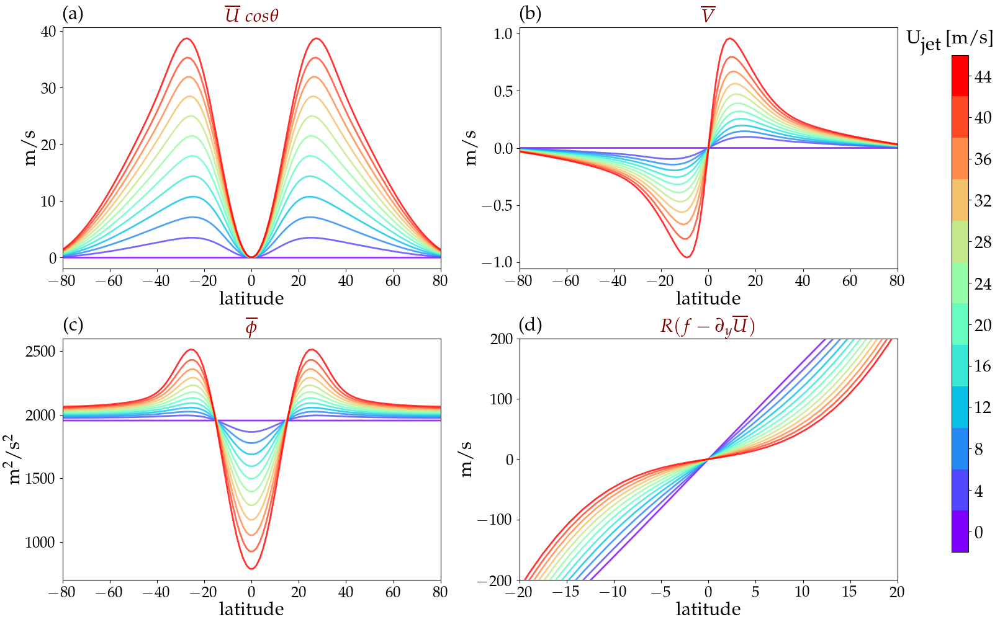

In [20]:
plot_mean_values(dicti = master_dict['200_0'], step=2, filename='mean_state_200.pdf', save=True)

In [21]:
# plot_mean_values(dicti = master_dict['200_0'], step=2, filename='mean_state_200.pdf' )

In [22]:
# grav = 9.8
# R = 6371e3 
# dicti =  master_dict['500_0']
# umax_values = np.sort([int(i) for i in dicti['raw_field_dict'].keys()][::1])
# H0_values   = np.sort([int(np.max(dicti['raw_field_dict'][key]['phi_T']/grav)) for key in list(dicti['raw_field_dict'].keys())[::1]])
# py.plot(H0_values, umax_values, 'o-')

## Look at the steady state eddies (Figure 2)

In [24]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      ["maroon", "orangered", "sandybrown", "bisque",  "white", "lightcyan", "skyblue", "dodgerblue", "indigo"][::-1])

def vectors(uu, vv, lonn, latt, AX, mag, vector_scale):   
    Q    = AX.quiver(lonn, latt, uu, vv, mag, cmap='gray', \
                     alpha=0.6, headwidth=4, headlength=6, width=0.00015*16, scale=vector_scale, \
                     minlength=0)
    AX.quiverkey(Q, 0.1, 0.85, mag, r'%1.1f $m/s$'%(mag), labelpos='N', coordinates='axes', fontproperties = {'size':20}, labelcolor='k',  linewidth = 2)
    return Q, mag


def plot_steady_eddies(dicti = master_dict['500_0'], filename='raw_eddies_500.pdf', save=False, figsize=(20,20),  umax_values=[0, 10, 20, 30, 40, 50, 60, 70]):

        grav = 9.8
        R = 6371e3 
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "indianred", "orange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])
        
        umax_values = umax_values ###np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())])[::step]
#         H0_values   = np.sort([int(np.max(dicti['raw_field_dict'][str(key)]['phi_T']/grav)) for key in umax_values])

        col = 2
        row = len(umax_values)//col
        fig, axss = py.subplots(row, col, figsize=figsize, constrained_layout=True, sharex=True, sharey=True)

        axs = axss.T.flatten()

        UMAX = umax_values
        alphabet = list(string.ascii_lowercase)
        labels   = [('('+alpha+')') for alpha in alphabet]
        grav = 10

           
        var_name = '' #[r'$\overline{U} \ cos\theta$', r'$\overline{V}$', r'$\overline{\phi}$', r'$R(f-\partial_y{\overline{U}})$' ]
        units    = '' #[r'$m/s$', r'$m/s$', r'$m^2/s^2$', r'$m/s$']   


        R= 6371e3
        c = -1   
        for Umax, AX in zip(UMAX, axs) :

            var_name = r'U$_{\textrm{jet}}$ = %1d m/s'%(Umax)
            c = c+1       
            ds     = dicti['raw_field_dict'][str(Umax)]
            de     = dicti['vrt_budget_dict'][str(Umax)]
            SCALE  = R
            
            field = eddy(ds['PHI'])
            LRANGE = Lrange(field, 20) #np.arange(-0.3, 0.32, 0.02)*8; 
            ticks = [np.min(LRANGE),   \
                     np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.25, \
                     np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.50, \
                     np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.75, \
                     np.max(LRANGE)]
            
            im = AX.contourf( ds['lon'],  ds['lat'], eddy(ds['PHI']), LRANGE,  cmap=cmap2, extend='both', alpha=0.8) 
            
            
            field  = eddy(ds['phi_forcing'])
            LRANGE = Lrange(field, 20) #np.arange(-0.3, 0.32, 0.02)*8; 
            phi_ticks = [np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.00, \
                         np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.25, \
                         np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.75, \
                         np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*1.00,]

            
            AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[2]],  colors='brown',         linewidths=5, linestyles='solid', alpha=0.5) 
            AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[1]],  colors='forestgreen',   linewidths=5, linestyles='solid', alpha=0.6) 
            
            if c>0 :            
                field  = np.nanmean(ds['U'], axis=-1)[:,None]+ds['U']*0
                AX.contour( ds['lon'],  ds['lat'], field,  [np.nanmax(field)/(1+1e-7)],  colors='gray',   linewidths=2, linestyles='dotted', alpha=0.7) 
            
            
            lo = 12; la=4
            uu     =  eddy(ds['U'])
            vv     =  eddy(ds['V'])
            u_mag  =  np.sqrt(uu**2 + vv**2)
            vector_max   = 0.2 #np.max(u_mag)
            vector_scale = 2
            
            Q, mag = vectors(uu[::la, ::lo], vv[::la, ::lo], ds['lon'][::lo], ds['lat'][::la], AX, vector_max, vector_scale)
                                    
            cbar = fig.colorbar(im, ax=AX, location='right', aspect=30, shrink=1, ticks=ticks)
            for t in cbar.ax.get_yticklabels():
                t.set_fontsize(20)
                
            AX.set_ylim(-60,60)
                                    
            AX.text(0.03, 1.05,labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22)
            AX.tick_params(labelsize=18)
            AX.set_xlabel(None, size=22,  labelpad=0.9)
            AX.set_ylabel(None, size=22,  labelpad=0.6)
            AX.set_title(var_name, fontsize=22, color='maroon', y=1.05)

        ### To set common x and y axis ###
        py.setp(axss[row-1,:],  xlabel='longitude',)
        py.setp(axss[:,0],      ylabel='latitude',)

        fig.show()
        
        if save:
            h5saveload.make_sure_path_exists(('./%s_figures/'%(today_date)))
            py.savefig(('./%s_figures/'%(today_date))+filename, pad_inches=0.5, bbox_inches='tight')


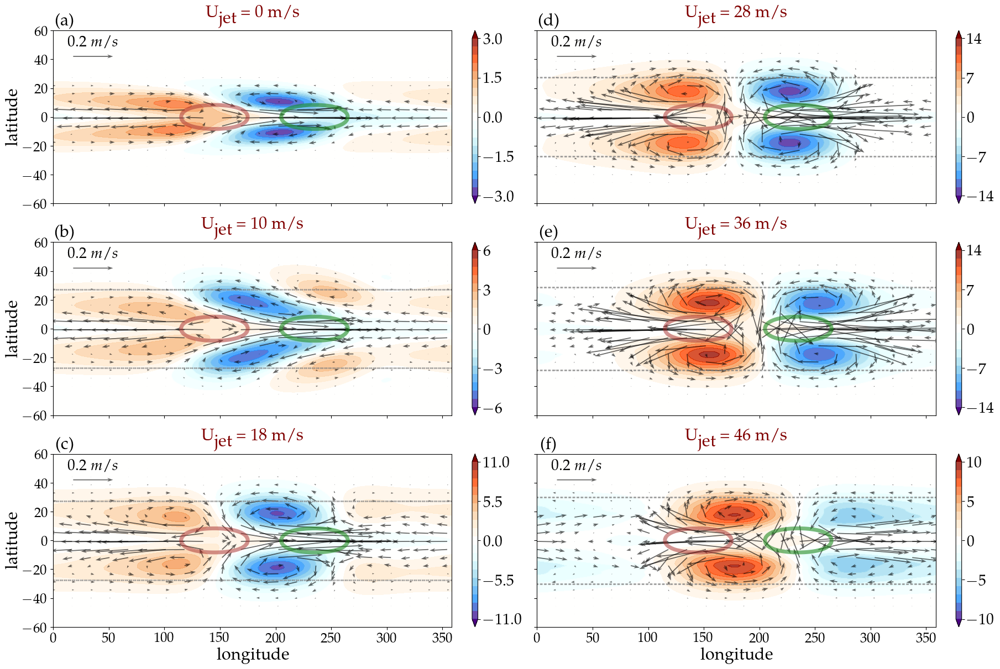

In [32]:
plot_steady_eddies(dicti = master_dict['200_0'], filename='raw_eddies_200.pdf', save=True, figsize=(18,12), umax_values=[0,  10, 18, 28, 36, 46])

## Divergence map (Figure 3)

In [33]:
master_dict['500_0']['veloc_decomp_dict']['0'].keys()

dict_keys(['div', 'lat', 'lon', 'sf', 'uD', 'uR', 'vD', 'vR', 'vp', 'vrt'])

In [36]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      ["maroon", "orangered", "sandybrown", "bisque",  "white", "lightcyan", "skyblue", "dodgerblue", "indigo"][::-1])

def vectors(uu, vv, lonn, latt, AX, mag, vector_scale):   
    Q    = AX.quiver(lonn, latt, uu, vv, mag, cmap='gray', \
                     alpha=0.5, headwidth=4, headlength=6, width=0.00015*16, scale=vector_scale, \
                     minlength=0)
    AX.quiverkey(Q, 0.15, 1.03, mag, r'%1.2f $m/s$'%(mag), labelpos='E', coordinates='axes', fontproperties = {'size':20}, labelcolor='k',  linewidth = 2)
    return Q, mag


def plot_steady_divergence_eddies(dicti = master_dict['500_0'],  filename='raw_eddies_500.pdf', save=False, figsize=(20,18), umax_values=[0,  14,  28, 42, 56, 70]):
    
    
        def Lrange(Y, dy=10):
            mini = np.abs(np.min(Y))
            maxi = np.abs(np.max(Y))
            maxi = np.round((np.max([(mini), (maxi)])), 1)
            range_values = np.linspace(-maxi, maxi, dy)
            return range_values


        grav = 9.8
        R = 6371e3 
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "indianred", "orange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])
        
        umax_values = umax_values #np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())])[::step]
#         H0_values   = np.sort([int(np.max(dicti['raw_field_dict'][str(key)]['phi_T']/grav)) for key in umax_values])

        col = 2
        row = len(umax_values)//col
        fig, axss = py.subplots(row, col, figsize=figsize, constrained_layout=True, sharex=True, sharey=True)

        axs = axss.T.flatten()

        UMAX = umax_values
        alphabet = list(string.ascii_lowercase)
        labels   = [('('+alpha+')') for alpha in alphabet]
        grav = 10

           
        var_name = '' #[r'$\overline{U} \ cos\theta$', r'$\overline{V}$', r'$\overline{\phi}$', r'$R(f-\partial_y{\overline{U}})$' ]
        units    = '' #[r'$m/s$', r'$m/s$', r'$m^2/s^2$', r'$m/s$']   


        R= 6371e3
        c = -1   
        for Umax, AX in zip(UMAX, axs) :

            var_name = r'U$_{\textrm{jet}}$ = %1d m/s'%(Umax)
            c = c+1       
            ds     = dicti['raw_field_dict'][str(Umax)]
            de     = dicti['veloc_decomp_dict'][str(Umax)]
            SCALE  = R
            
            field = eddy(de['div'])
            LRANGE = np.arange(-0.28, 0.30, 0.02)*2 ##Lrange(field, 20) #np.arange(-0.3, 0.32, 0.02)*8; 
            ticks = [np.min(LRANGE),   \
                     np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.25, \
                     np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.50, \
                     np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.75, \
                     np.max(LRANGE)]
            
            im = AX.contourf( ds['lon'],  ds['lat'], field, LRANGE,  cmap=cmap2, extend='both', alpha=0.8)
#             cbar = fig.colorbar(im, ax=AX, location='right', aspect=30, shrink=1, ticks=ticks)
#             for t in cbar.ax.get_yticklabels():
#                 t.set_fontsize(20)
            
            
            field  = eddy(ds['phi_forcing'])
            LRANGE = Lrange(field, 20) #np.arange(-0.3, 0.32, 0.02)*8; 
            phi_ticks = [np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.00, \
                         np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.25, \
                         np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.75, \
                         np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*1.00,]

            
            AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[2]],  colors='brown',         linewidths=5, linestyles='solid', alpha=0.5) 
            AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[1]],  colors='forestgreen',   linewidths=5, linestyles='solid', alpha=0.6) 
            
            if c>0 :            
                field  = np.nanmean(ds['U'], axis=-1)[:,None]+ds['U']*0
                AX.contour( ds['lon'],  ds['lat'], field,  [np.nanmax(field)/(1+1e-7)],  colors='gray',   linewidths=2, linestyles='dotted', alpha=0.7) 
            
            
            lo = 8; la=4
            uu     =  eddy(de['uD'])
            vv     =  eddy(de['vD'])
            u_mag  =  np.sqrt(uu**2 + vv**2)
            vector_max   = 0.04 #np.max(u_mag)
            vector_scale = 0.6
            
            Q, mag = vectors(uu[::la, ::lo], vv[::la, ::lo], ds['lon'][::lo], ds['lat'][::la], AX, vector_max, vector_scale)
                                    
                
            AX.set_ylim(-60,60)
                                    
            AX.text(0.03, 1.05,labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22)
            AX.tick_params(labelsize=18)
            AX.set_xlabel(None, size=22,  labelpad=0.9)
            AX.set_ylabel(None, size=22,  labelpad=0.6)
            AX.set_title(var_name, fontsize=22, color='maroon', y=1.05)
            

        cbar = fig.colorbar(im, ax=axs.ravel().tolist(), location='right', aspect=30, shrink=0.8, ticks=ticks)
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(22)

        ### To set common x and y axis ###
        py.setp(axss[row-1,:],  xlabel='longitude',)
        py.setp(axss[:,0],      ylabel='latitude',)

        fig.show()
        
        if save:
            h5saveload.make_sure_path_exists(('./%s_figures/'%(today_date)))
            py.savefig(('./%s_figures/'%(today_date))+filename, pad_inches=0.5, bbox_inches='tight')


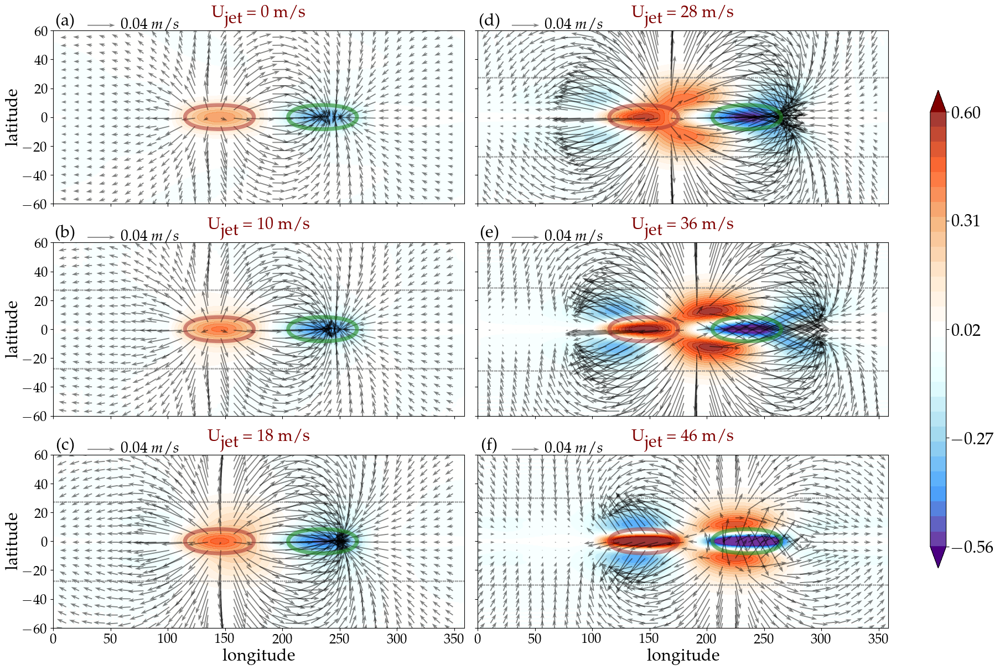

In [37]:
plot_steady_divergence_eddies(dicti = master_dict['200_0'], filename='divergence_eddies_200.pdf', save=True, figsize=(18,12), umax_values=[0,  10, 18, 28, 36, 46])

## Kelvin and Rossby mode decomposition (Figure 4)

### Implement PCF mode decomposition

In [18]:
def Dn(n, zeta):
    from scipy.special import hermite as He
    Hn    = He(n)(zeta)
    gauss = np.exp(-(zeta**2)/2)
    pi    = np.pi
    norm  = 2**(-n/2)   #/((np.sqrt(pi)*math.factorial(n))**(1/2.0))
    PCF   = Hn*gauss*norm
    return PCF

def func_2d(n, field, zeta):
    pcf_2d    = Dn(n, zeta)[:, None]
    field_2dd = field[None, :]*pcf_2d ### Only the gaussian thing for now. 
    return field_2dd

def project1d(n, field, zeta):
    rsphere    = 6371e3 
    pcf_2d     = Dn(n, zeta)[:,None]
    field_2dd  = field*pcf_2d ### 
    Norm_Const = (np.sqrt(np.pi)*math.factorial(n))
    project_integrate = integrate.trapz( field_2dd[::-1,:], zeta[::-1], axis=0)/ (Norm_Const)
    return project_integrate

def project2d(n, field, zeta):
    rsphere    = 6371e3 
    pcf_2d     = Dn(n, zeta)[:,None]
    field_2dd  = field*pcf_2d ### 
    Norm_Const = (np.sqrt(np.pi)*math.factorial(n))
    project_integrate = integrate.trapz( field_2dd[::-1,:], zeta[::-1], axis=0)/ (Norm_Const)
    return func_2d(n, project_integrate, zeta)

def mode_decompose(field, mode_nums = [0, 2, 4, 6, 8], zeta=None):
    qms=[]; qmDms=[];
    for m in mode_nums:
        qm   = project1d(m, field, zeta)
        qmDm = project2d(m, field, zeta)        
        qms.append(qm)
        qmDms.append(qmDm)    
    return np.stack(qms), np.stack(qmDms)
        
def lrange(field, NN=25):
       maxi   =  np.nanmax ([ np.abs(np.nanmin(field)), np.abs(np.nanmax(field)) ])
       mini   = -maxi
       eddy_lrange =  np.linspace(mini, maxi, NN)
       return eddy_lrange

#def evaluate_u_v_phi_modes(UMAX = 0.001,  dicti=transient_U, ntrunc_max = 30):

def evaluate_u_v_phi_modes(dicti=master_dict['500_0']['raw_field_dict']['0'], ntrunc_max = 30):
                    
    grav   = 10; 
    Hmean  = ((dicti['PHI']).mean(axis=-1))/grav

    lat = (dicti['lat'])
    lats = np.deg2rad(lat)

    Hmean_tropics = (Hmean[np.abs(lat)<20]).mean()
    R      = 6371e3
    c      = np.sqrt(grav*Hmean_tropics)

    rsphere  = 6371e3
    beta     = 2*(7.29*1e-5/rsphere)  #*np.cos(dicti['lats'])

    ### Calculate second_order_derivatie of U
    U_mean     = (dicti['U']).mean(axis=-1)
    du_dy      = np.gradient(U_mean*np.cos(lats), (lats), axis=0)/(np.cos(lats)*rsphere)
    d2u_dy2    = np.gradient(du_dy, (lats), axis=0)/rsphere
    dU2d2y     = np.polyfit(lats[50:-50]*rsphere, (dicti['U'][50:-50, ...]).mean(axis=-1), 2)[0]

    beta_eff = beta - dU2d2y
    yT   = (np.sqrt(c/beta_eff))/R
    zeta = np.deg2rad(dicti['lat'])/yT

    q      = eddy(dicti['U']) + eddy(dicti['PHI'])/c
    r      = eddy(dicti['U']) - eddy(dicti['PHI'])/c
    v      = eddy(dicti['V'])

    qms, qmDms = mode_decompose(field=q, mode_nums = np.arange(0, ntrunc_max+1, 1), zeta=zeta)
    rms, rmDms = mode_decompose(field=r, mode_nums = np.arange(0, ntrunc_max+1, 1), zeta=zeta)
    vms, vmDms = mode_decompose(field=v, mode_nums = np.arange(0, ntrunc_max+1, 1), zeta=zeta)

    #### Only have symmetric modes in the system
    #### So every alternate mode values should be 0

    u_modes   = []
    v_modes   = []
    phi_modes = []

    for m in np.arange(-1, ntrunc_max-1, 1):

        if m == -1: ### corresponds to Kelvin mode
            u_m   = 1*qmDms[m+1,...]/2
            v_m   = 0*vmDms[m+1,...]  ### Because v component of Kelvin wind is 0
            phi_m = c*qmDms[m+1,...]/2

        elif m == 0: ### corresponds to Kelvin mode
            u_m   = 1*qmDms[m+1,...]/2
            v_m   =     vmDms[m,...]  ### v component of MRG mode
            phi_m = c*qmDms[m+1,...]/2

        else:  ### for n>=1 mode
            u_m   =   (qmDms[m+1,...] + rmDms[m-1,...])/2
            v_m   =   (vmDms[m,...])
            phi_m = c*(qmDms[m+1,...] - rmDms[m-1,...])/2

        u_modes.append(u_m)
        v_modes.append(v_m)
        phi_modes.append(phi_m)

    u_modes   = np.stack(u_modes)
    v_modes   = np.stack(v_modes)
    phi_modes = np.stack(phi_modes)

    fields = {'u_modes' : u_modes, 'v_modes':v_modes, 'phi_modes':phi_modes, \
              'trapping_scale' : np.rad2deg(yT), 'c': c, \
              'beta_eff' : beta_eff, 'dU2d2y': dU2d2y, 'zeta': zeta, \
              'lon':(dicti['lon']), 'lat':(dicti['lat']), \
              'u': eddy(dicti['U']), 'v':eddy(dicti['V']), 'phi':eddy(dicti['PHI']), 
              'mode_nums':np.arange(0, ntrunc_max-1, 1)}  
    return fields
        
        
def eval_modes_for_diff_Umax(dicti=master_dict['500_0'], ntrunc_max = 30):
    
    umax_values = np.sort([int(i) for i in dicti['raw_field_dict'].keys()])    
        
    U_max_dict  = {}
    for UU in tqdm(umax_values):
        ds     = dicti['raw_field_dict'][str(UU)]
        fields = evaluate_u_v_phi_modes(dicti=ds, ntrunc_max = ntrunc_max)
        U_max_dict['%1d'%(UU)] = fields
    return U_max_dict

In [19]:
for key in master_dict.keys():
    print (key)
    master_dict[key]['mode_decomposition'] = eval_modes_for_diff_Umax(dicti = master_dict[key], ntrunc_max = 30)

  0%|          | 0/24 [00:00<?, ?it/s]

200_0


  0%|          | 0/40 [00:00<?, ?it/s]

500_0


100%|██████████| 40/40 [00:12<00:00,  3.15it/s]


In [20]:
master_dict['200_0']['mode_decomposition']['0'].keys()

dict_keys(['u_modes', 'v_modes', 'phi_modes', 'trapping_scale', 'c', 'beta_eff', 'dU2d2y', 'zeta', 'lon', 'lat', 'u', 'v', 'phi', 'mode_nums'])

In [21]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      ["maroon", "orangered", "sandybrown", "bisque",  "white", "lightcyan", "skyblue", "dodgerblue", "indigo"][::-1])

def vectors(uu, vv, lonn, latt, AX, mag, vector_scale):   
    Q    = AX.quiver(lonn, latt, uu, vv, mag, cmap='gray', \
                     alpha=0.6, headwidth=4, headlength=6, width=0.00015*16, scale=vector_scale, \
                     minlength=0)
    AX.quiverkey(Q, 0.1, 0.85, mag, r'%1.1f $m/s$'%(mag), labelpos='N', coordinates='axes', fontproperties = {'size':20}, labelcolor='k',  linewidth = 2)
    return Q, mag


def plot_steady_modes(dicti = master_dict['500_0'], MODE_num = -1, filename='Kelvin_eddies_500.pdf', save=False, LRANGE = np.arange(-4, 4.2, 0.2), vector_scale = 1, figsize=(20,18), umax_values=[0,  14,  28, 42, 56, 70]):

        MODE_num = MODE_num+1
        
        grav = 9.8
        R = 6371e3 
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "indianred", "orange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])
        
        umax_values = umax_values #np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())])[::step]
        H0_values   = np.sort([int(np.max(dicti['raw_field_dict'][str(key)]['phi_T']/grav)) for key in umax_values])

        col = 2
        row = len(umax_values)//col
        fig, axss = py.subplots(row, col, figsize= figsize, constrained_layout=True, sharex=True, sharey=True)

        axs = axss.T.flatten()

        UMAX = umax_values
        alphabet = list(string.ascii_lowercase)
        labels   = [('('+alpha+')') for alpha in alphabet]
        grav = 10

           
        var_name = '' #[r'$\overline{U} \ cos\theta$', r'$\overline{V}$', r'$\overline{\phi}$', r'$R(f-\partial_y{\overline{U}})$' ]
        units    = '' #[r'$m/s$', r'$m/s$', r'$m^2/s^2$', r'$m/s$']   


        R= 6371e3
        c = -1   
        for Umax, AX in zip(UMAX, axs) :

            var_name = r'U$_{\textrm{jet}}$ = %1d m/s'%(Umax)
            c = c+1       
            ds       = dicti['raw_field_dict']   [str(Umax)]
            de       = dicti['vrt_budget_dict']  [str(Umax)]
            ds_modes = dicti['mode_decomposition'][str(Umax)]
            SCALE  = R
            
            field = eddy(ds_modes['phi_modes'][MODE_num,...])
            if LRANGE is None:
                LRANGE = Lrange(field, 20) #np.arange(-0.3, 0.32, 0.02)*8; 
            ticks = [np.min(LRANGE),   \
                     np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.25, \
                     np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.50, \
                     np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.75, \
                     np.max(LRANGE)]
            
            im = AX.contourf( ds['lon'],  ds['lat'], field, LRANGE,  cmap=cmap2, extend='both', alpha=0.8) 
#             cbar = fig.colorbar(im, ax=AX, location='right', aspect=30, shrink=1, ticks=ticks)
#             for t in cbar.ax.get_yticklabels():
#                 t.set_fontsize(20)            
            
            
            lo = 12; la=4
            uu     =  eddy(ds_modes['u_modes'][MODE_num,...])
            vv     =  eddy(ds_modes['v_modes'][MODE_num,...])
            u_mag  =  np.sqrt(uu**2 + vv**2)
            vector_max   = 0.2 #np.max(u_mag)
            vector_scale = vector_scale
            
            Q, mag = vectors(uu[::la, ::lo], vv[::la, ::lo], ds['lon'][::lo], ds['lat'][::la], AX, vector_max, vector_scale)
                                    

            ####################### PHI Forcing and location of jet ######################
            field  = eddy(ds['phi_forcing'])
            LRANGE_phi = Lrange(field, 20) #np.arange(-0.3, 0.32, 0.02)*8; 
            phi_ticks = [np.min(LRANGE_phi)+(np.max(LRANGE_phi) - np.min(LRANGE_phi))*0.00, \
                         np.min(LRANGE_phi)+(np.max(LRANGE_phi) - np.min(LRANGE_phi))*0.25, \
                         np.min(LRANGE_phi)+(np.max(LRANGE_phi) - np.min(LRANGE_phi))*0.75, \
                         np.min(LRANGE_phi)+(np.max(LRANGE_phi) - np.min(LRANGE_phi))*1.00,]

            
            AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[2]],  colors='brown',         linewidths=5, linestyles='solid', alpha=0.5) 
            AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[1]],  colors='forestgreen',   linewidths=5, linestyles='solid', alpha=0.6) 
            
            if c>0 :            
                field  = np.nanmean(ds['U'], axis=-1)[:,None]+ds['U']*0
                AX.contour( ds['lon'],  ds['lat'], field,  [np.nanmax(field)/(1+1e-7)],  colors='gray',   linewidths=2, linestyles='dotted', alpha=0.7) 
            ####################### PHI Forcing and location of jet #######################

                
            AX.set_ylim(-60,60)
                                    
            AX.text(0.03, 1.05,labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22)
            AX.tick_params(labelsize=18)
            AX.set_xlabel(None, size=22,  labelpad=0.9)
            AX.set_ylabel(None, size=22,  labelpad=0.6)
            AX.set_title(var_name, fontsize=22, color='maroon', y=1.05)
            
        cbar = fig.colorbar(im, ax=axs.ravel().tolist(), location='right', aspect=40, shrink=0.9, ticks=ticks)
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(22)

        ### To set common x and y axis ###
        py.setp(axss[row-1,:],  xlabel='longitude',)
        py.setp(axss[:,0],      ylabel='latitude',)

        fig.show()
        
        if save:
            h5saveload.make_sure_path_exists(('./%s_figures/'%(today_date)))
            py.savefig(('./%s_figures/'%(today_date))+filename, pad_inches=0.5, bbox_inches='tight')


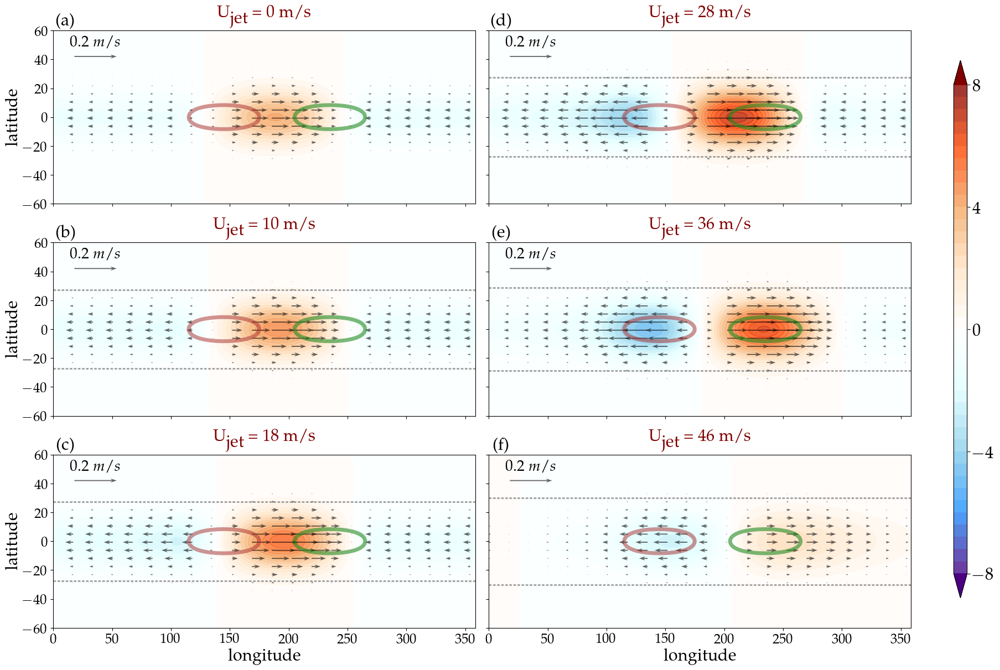

In [22]:
plot_steady_modes(dicti = master_dict['200_0'], MODE_num = -1, filename='Kelvin_eddies_200.pdf', save=True, vector_scale=2, \
                  LRANGE = np.arange(-4, 4.2, 0.2)*2, figsize=(18,12), umax_values=[0,  10, 18, 28, 36, 46])


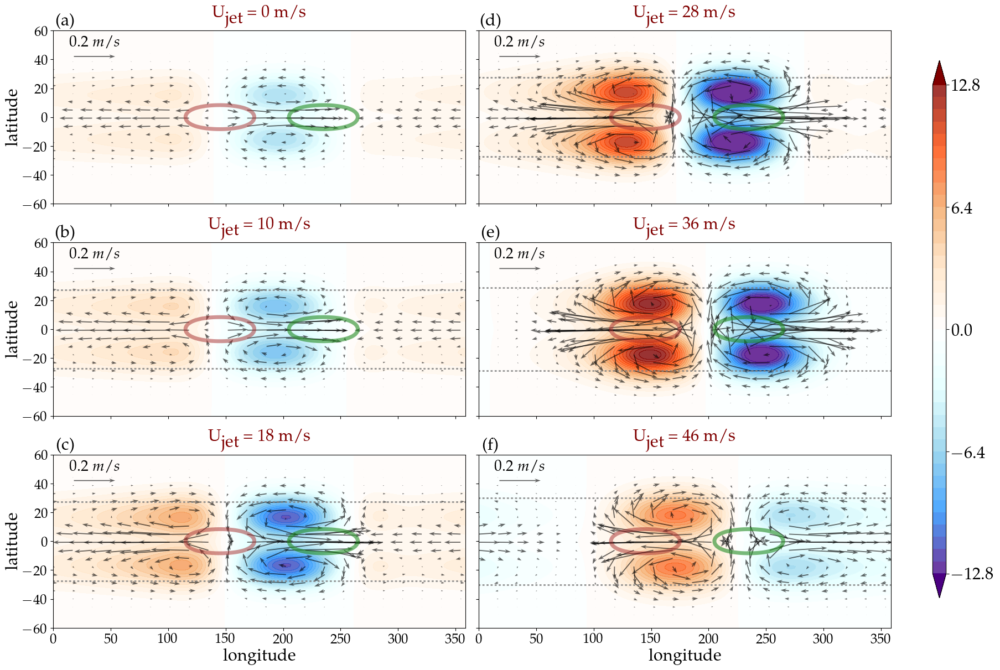

In [23]:
plot_steady_modes(dicti = master_dict['200_0'], MODE_num = 1, filename='Rossby_eddies_200.pdf', save=True, LRANGE = np.arange(-4, 4.2, 0.2)*3.2,  \
                  figsize=(18,12), umax_values=[0,  10, 18, 28, 36, 46], vector_scale=2)


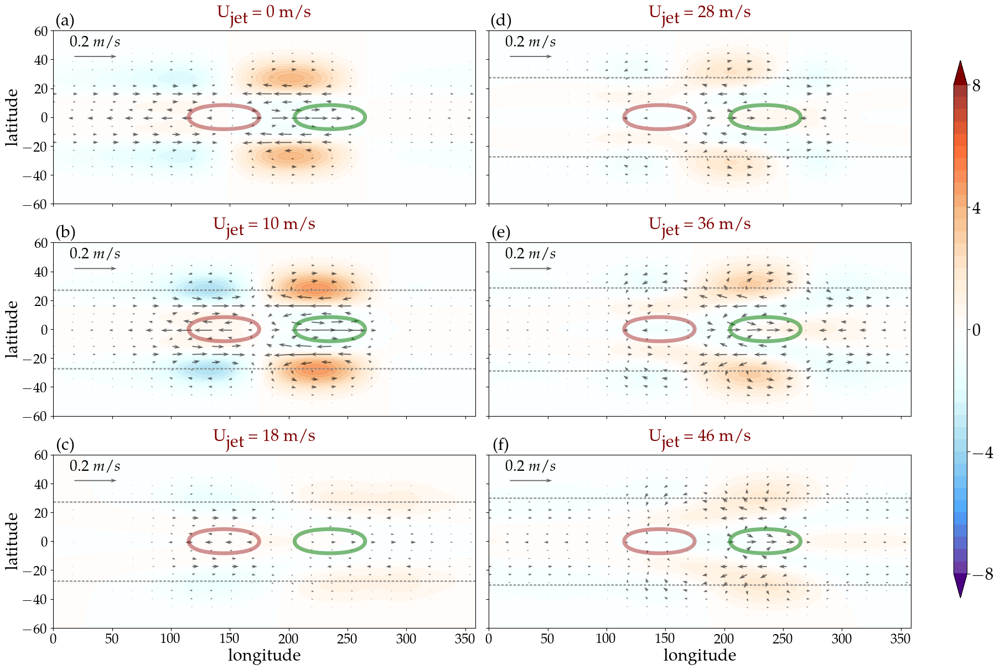

In [24]:
plot_steady_modes(dicti = master_dict['200_0'], MODE_num = 3,  filename='n=3_eddies_200.pdf', save=True, LRANGE = np.arange(-4, 4.2, 0.2)*2, \
                 figsize=(18,12), umax_values=[0,  10, 18, 28, 36, 46], vector_scale=2)

In [29]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      ["maroon", "orangered", "sandybrown", "bisque",  "white", "lightcyan", "skyblue", "dodgerblue", "indigo"][::-1])

def vectors(uu, vv, lonn, latt, AX, mag, vector_scale):   
    Q    = AX.quiver(lonn, latt, uu, vv, mag, cmap='gray', \
                     alpha=0.6, headwidth=4, headlength=6, width=0.00015*16, scale=vector_scale, \
                     minlength=0)
    AX.quiverkey(Q, 0.1, 0.85, mag, r'%1.1f $m/s$'%(mag), labelpos='N', coordinates='axes', fontproperties = {'size':20}, labelcolor='k',  linewidth = 2)
    return Q, mag


def plot_residue_modes(dicti = master_dict['500_0'], MODE_num = -1,  filename='Residue_eddies_500.pdf', save=False, LRANGE = np.arange(-4, 4.2, 0.2), vector_scale = 1, figsize=(16,12), umax_values=[0,  14,  28, 42, 56, 70]):

        MODE_num = MODE_num+1
        
        grav = 9.8
        R = 6371e3 
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "indianred", "orange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])
        
        umax_values = umax_values #np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())])[::step]
        #H0_values   = np.sort([int(np.max(dicti['raw_field_dict'][str(key)]['phi_T']/grav)) for key in umax_values])

        col = 2
        row = len(umax_values)//col
        fig, axss = py.subplots(row, col, figsize=figsize, constrained_layout=True, sharex=True, sharey=True)

        axs = axss.T.flatten()

        UMAX = umax_values
        alphabet = list(string.ascii_lowercase)
        labels   = [('('+alpha+')') for alpha in alphabet]
        grav = 10

           
        var_name = '' #[r'$\overline{U} \ cos\theta$', r'$\overline{V}$', r'$\overline{\phi}$', r'$R(f-\partial_y{\overline{U}})$' ]
        units    = '' #[r'$m/s$', r'$m/s$', r'$m^2/s^2$', r'$m/s$']   


        R= 6371e3
        c = -1   
        for Umax, AX in zip(UMAX, axs) :

            var_name = r'U$_{\textrm{jet}}$ = %1d m/s'%(Umax)
            c = c+1       
            ds       = dicti['raw_field_dict']   [str(Umax)]
            de       = dicti['vrt_budget_dict']  [str(Umax)]
            ds_modes = dicti['mode_decomposition'][str(Umax)]
            SCALE  = R
            
            field = eddy(ds['PHI']) - eddy(ds_modes['phi_modes'][[0,2],...]).sum(axis=0)
            if LRANGE is None:
                LRANGE = Lrange(field, 20) #np.arange(-0.3, 0.32, 0.02)*8; 
            ticks = [np.min(LRANGE),   \
                     np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.25, \
                     np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.50, \
                     np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.75, \
                     np.max(LRANGE)]
            
            im = AX.contourf( ds['lon'],  ds['lat'], field, LRANGE,  cmap=cmap2, extend='both', alpha=0.8) 
            
            
            lo = 12; la=4
            uu     =  eddy(ds['U']) - eddy(ds_modes['u_modes'][[0,2],...]).sum(axis=0)
            vv     =  eddy(ds['V']) - eddy(ds_modes['v_modes'][[0,2],...]).sum(axis=0)
            u_mag  =  np.sqrt(uu**2 + vv**2)
            vector_max   = 0.1 #np.max(u_mag)
            vector_scale = vector_scale
            
            Q, mag = vectors(uu[::la, ::lo], vv[::la, ::lo], ds['lon'][::lo], ds['lat'][::la], AX, vector_max, vector_scale)
                                    

            ####################### PHI Forcing and location of jet ######################
            field  = eddy(ds['phi_forcing'])
            LRANGE_phi = Lrange(field, 20) #np.arange(-0.3, 0.32, 0.02)*8; 
            phi_ticks = [np.min(LRANGE_phi)+(np.max(LRANGE_phi) - np.min(LRANGE_phi))*0.00, \
                         np.min(LRANGE_phi)+(np.max(LRANGE_phi) - np.min(LRANGE_phi))*0.25, \
                         np.min(LRANGE_phi)+(np.max(LRANGE_phi) - np.min(LRANGE_phi))*0.75, \
                         np.min(LRANGE_phi)+(np.max(LRANGE_phi) - np.min(LRANGE_phi))*1.00,]

            
            AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[2]],  colors='brown',         linewidths=5, linestyles='solid', alpha=0.5) 
            AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[1]],  colors='forestgreen',   linewidths=5, linestyles='solid', alpha=0.6) 
            
            if c>0 :            
                field  = np.nanmean(ds['U'], axis=-1)[:,None]+ds['U']*0
                AX.contour( ds['lon'],  ds['lat'], field,  [np.nanmax(field)/(1+1e-7)],  colors='gray',   linewidths=2, linestyles='dotted', alpha=0.7) 
            ####################### PHI Forcing and location of jet #######################

                
            AX.set_ylim(-60,60)
                                    
            AX.text(0.03, 1.05,labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22)
            AX.tick_params(labelsize=18)
            AX.set_xlabel(None, size=22,  labelpad=0.9)
            AX.set_ylabel(None, size=22,  labelpad=0.6)
            AX.set_title(var_name, fontsize=22, color='maroon',y=1.05)
            
        cbar = fig.colorbar(im, ax=axs.ravel().tolist(), location='right', aspect=40, shrink=0.9, ticks=ticks)
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(22)

        ### To set common x and y axis ###
        py.setp(axss[row-1,:],  xlabel='longitude',)
        py.setp(axss[:,0],      ylabel='latitude',)

        fig.show()
        
        if save:
            h5saveload.make_sure_path_exists(('./%s_figures/'%(today_date)))
            py.savefig(('./%s_figures/'%(today_date))+filename, pad_inches=0.5, bbox_inches='tight')


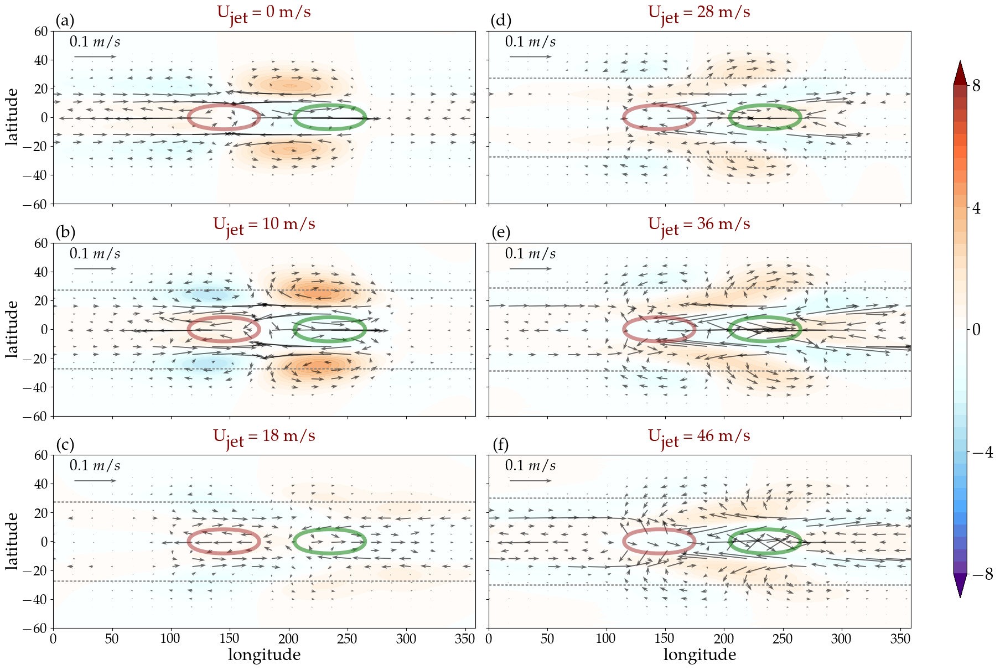

In [31]:
plot_residue_modes( dicti = master_dict['200_0'], filename='Residue_eddies_200.pdf', save=True, \
                   LRANGE = np.arange(-4, 4.2, 0.2)*2, vector_scale = 1, figsize=(18,12), umax_values=[0,  10, 18, 28, 36, 46])

In [32]:
R = 6371e3
def rms_near_equator(lat, lon, field, lat_bnd=10):
    forcing_region_field = tropical_mask(lat, lon, R*field,  0, lat_bnd)
    rms_div              = np.sqrt(np.nanmean(np.nanmean((forcing_region_field**2), axis=-1), axis=-1))
    return rms_div

## Plot divergence into zonal and meridional components

In [33]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

def plot_div_decomposed_curves(dicti = master_dict['500_0'], step=4, filename='mean_state_500.pdf', save=False, figsize=(20,7)):

        grav = 9.8
        R = 6371e3 
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "maroon", "darkorange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])
        
        fig, axs = py.subplots(1, 3, figsize=figsize, constrained_layout=True, sharex=True, sharey=True)

        axs = axs.flatten()
        
        umax_values = np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())])[::step]
        H0_values   = np.sort([int(np.max(dicti['raw_field_dict'][str(key)]['phi_T']/grav)) for key in umax_values])

        UMAX     = umax_values
        keys     = ['div', 'div_x', 'div_y']
        alphabet = list(string.ascii_lowercase)
        labels   = [('('+alpha+')') for alpha in alphabet]
    
        var_name = [r'$R \mathbf{\nabla}.{\mathbf{v}}^{*}$', r'$R ({du^{*}}/{dx})$', r'$R ({dv^{*}}/{dy})$']
        units    = [r'$m/s$', r'$m/s$', r'$m/s$', r'$m/s$']   

        cmap2=py.get_cmap("rainbow")

        R= 6371e3
        c = -1
        for key in tqdm(keys):  
            c = c+1       
            AX = axs[c]   
            for Umax, H0 in zip(UMAX, H0_values) :
                ds     = dicti['raw_field_dict'][str(Umax)]
                de     = dicti['vrt_budget_dict'][str(Umax)]
                SCALE  = R
                LRANGE = np.arange(-0.3, 0.32, 0.02); 

                norm = float(Umax)/np.max(UMAX)
                
                plotting_field = forcing_region( SCALE*eddy((de[key])), ds['phi_forcing'], sign=1, scale=1000)   
                im = AX.plot( ds['lat'],  np.nanmean(plotting_field, axis=-1), c = cmap2(norm), lw=4) 
     
            AX.set_xlim(-20,20)
            AX.text(0.03, 1.05,labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22)
            AX.tick_params(labelsize=18)
            AX.set_xlabel(None, size=22,  labelpad=0.9)
            AX.set_ylabel(None, size=22,  labelpad=0.6)
            AX.set_title(var_name[c],  fontsize=22, color='maroon')
            AX.axhline(0, color='k')
        
    
        #######################################
        ## Add a colorbar for line plots ##
        value          = umax_values
        dvalue         = np.diff(value)[0]
        TICKS          = np.arange(value.min()+(dvalue/2), value.max()+(dvalue/2)+dvalue, dvalue)
        TICKS_mappable = np.arange(value.min()           , value.max()+dvalue*2         , dvalue)
        TICKS_STR      = ['%1d'%(v) for v in TICKS-dvalue/2]
                
        sm   = mpl.cm.ScalarMappable(cmap=cmap2, norm=mpl.colors.BoundaryNorm(TICKS_mappable, cmap2.N))
        cbar = fig.colorbar(sm, ax=axs.ravel().tolist(), location='bottom', aspect=40, shrink=0.9, ticks = value, pad=0.1)
        cbar.set_ticks(TICKS)
        cbar.set_ticklabels(TICKS_STR)
        #######################################
                
        for t in cbar.ax.get_xticklabels():
            t.set_fontsize(20)
        ## Add a colorbar ##

        ### To set common x and y axis ###
        py.setp(axs[:],  xlabel='latitude',)
        py.setp(axs[0],  ylabel='m/s',)

        cbar.set_label(r'U$_{\textrm{jet}}$ [m/s]', \
                       y=1.05, rotation=0, fontsize=22, color='k')

        fig.show()
        
        if save:
            h5saveload.make_sure_path_exists(('./%s_figures/'%(today_date)))
            py.savefig(('./%s_figures/'%(today_date))+filename, pad_inches=0.5, bbox_inches='tight')


100%|██████████| 3/3 [00:00<00:00, 18.74it/s]


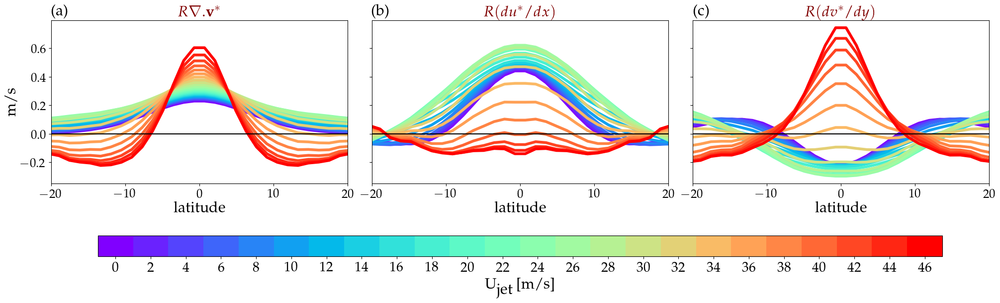

In [63]:
plot_div_decomposed_curves(dicti = master_dict['200_0'], step=1, filename='div_divx_divy_200.pdf', save=True, figsize=(20,6))

In [64]:
print (master_dict['200_0']['vrt_budget_dict']['0'].keys())

dict_keys(['D', 'V', 'ZETA_a', 'ZETA_a_D', 'abs_vrt', 'beta_term', 'cf', 'cf_term', 'damping_term', 'div', 'div_mean_winds_vrt', 'div_x', 'div_y', 'dy_ZETA_a', 'hadley_term', 'lat', 'lon', 'tendency_term', 'vrt', 'vrt_x', 'vrt_y', 'zonal_wind_term'])


In [65]:
# from scipy.signal import savgol_filter
# yhat = savgol_filter(, 51, 3) # window size 51, polynomial order 3

In [66]:
# savgol_filter??

## Plot divergence maps

In [67]:
master_dict['200_0']['vrt_var_name'].keys()

dict_keys(['V', 'ZETA_a', 'ZETA_a_D', 'beta_term', 'damping_term', 'div', 'div_x', 'div_y', 'dy_ZETA_a', 'hadley_term', 'tendency_term', 'zonal_wind_term'])

In [79]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      ["maroon", "orangered", "sandybrown", "bisque",  "white", "lightcyan", "skyblue", "dodgerblue", "indigo"][::-1])

def vectors(uu, vv, lonn, latt, AX, mag, vector_scale):   
    Q    = AX.quiver(lonn, latt, uu, vv, mag, cmap='gray', \
                     alpha=0.5, headwidth=4, headlength=6, width=0.00015*16, scale=vector_scale, \
                     minlength=0)
    AX.quiverkey(Q, 0.15, 1.03, mag, r'%1.2f $m/s$'%(mag), labelpos='E', coordinates='axes', fontproperties = {'size':20}, labelcolor='k',  linewidth = 2)
    return Q, mag


def plot_divergence_budget_decomposition(dicti = master_dict['500_0'], step=4, filename='raw_eddies_500.pdf', save=False, start=0, end=-1, N=10, figsize=(25,8), vector=False, UMAX  = [20, 60]):
    
    
        def Lrange(Y, dy=10):
            mini = np.abs(np.min(Y))
            maxi = np.abs(np.max(Y))
            maxi = np.round((np.max([(mini), (maxi)])), 1)
            range_values = np.linspace(-maxi, maxi, dy)
            return range_values


        grav = 9.8
        R = 6371e3 
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "indianred", "orange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])
        
#         cmap2 = py.cm.seismic
        
        umax_values = UMAX #np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())])[start:end][::step]
        H0_values   = np.sort([int(np.max(dicti['raw_field_dict'][str(key)]['phi_T']/grav)) for key in umax_values])

        col = 4
        row = len(umax_values)
        fig, axss = py.subplots(row, col, figsize=figsize, constrained_layout=True, sharex=True, sharey=True)

        axs = axss.flatten()
        
        
        UMAX     = UMAX #umax_values
        U_names  = ['weak jet', 'strong jet']
        keys     = ['ZETA_a_D', 'beta_term', 'hadley_term', 'zonal_wind_term']
        alphabet = list(string.ascii_lowercase)
        roman_numerals = ['i', 'ii', 'iii', 'iv']
#         roman_numerals = ['- term 1', '- term 2', '- term 3', '- term 4']
        
        labels = []
        for alpha in alphabet :
            for rn in roman_numerals:
                labels.append( '('+alpha+'-'+rn+')' ) # [('('+alpha+')') for alpha in alphabet]
    
        deno = '/'+dicti['vrt_var_name']['ZETA_a']
#         var_names = [dicti['vrt_var_name']['div'], r'$R$'+dicti['vrt_var_name']['beta_term']+r'$R$'+deno, dicti['vrt_var_name']['hadley_term']+r'$R$'+deno,   r'$R$'+dicti['vrt_var_name']['zonal_wind_term']+r'$R$'+deno] #. ##[r'$R \overrightarrow{\nabla}.{\overrightarrow{u}}^{*}$', r'$R ({du^{*}}/{dx})$', r'$R ({dv^{*}}/{dy})$']
        var_names = ['Eddy divergence', 'Sverdrup effect', 'Hadley Cell advection', 'Zonal wind advection' ] #. ##[r'$R \overrightarrow{\nabla}.{\overrightarrow{u}}^{*}$', r'$R ({du^{*}}/{dx})$', r'$R ({dv^{*}}/{dy})$']
        units    = [r'$m/s$', r'$m/s$', r'$m/s$', r'$m/s$']   

          
        var_name = '' #[r'$\overline{U} \ cos\theta$', r'$\overline{V}$', r'$\overline{\phi}$', r'$R(f-\partial_y{\overline{U}})$' ]
        units    = '' #[r'$m/s$', r'$m/s$', r'$m^2/s^2$', r'$m/s$']   


        R= 6371e3
        c = -1 ; r=-1  
        for Umax in (UMAX) :
            r =r+1
            
            co = -1
            for KEY in keys:
                
                co = co+1
                c = c+1
                AX = axs[c]
                
                U_name   = r'U$_{\textrm{jet}}$ = %1d m/s'%(Umax)  #U_names[r] #
                var_name = var_names[co]
                ds     = dicti['raw_field_dict'][str(Umax)]
                de     = dicti['vrt_budget_dict'][str(Umax)]
                dv_decomp   = dicti['veloc_decomp_dict'][str(Umax)]
                ds_modes    = dicti['mode_decomposition'][str(Umax)] 
                SCALE  = R


                field  = SCALE*eddy(de[KEY]/de['ZETA_a'])
                
                if Umax < 32:
                    LRANGE = np.arange(-0.42, 0.46, 0.04)*2  #np.arange(-0.3, 0.34, 0.04)*1.5  #Lrange( SCALE*eddy(de['ZETA_a_D'])/de['ZETA_a'], 20) #np.arange(-0.3, 0.32, 0.02)*8;  np.arange(-0.15, 0.17, 0.02)*2.0 #
                else:
                    LRANGE = np.arange(-0.3, 0.34, 0.04)*3 #Lrange( SCALE*eddy(de['ZETA_a_D'])/de['ZETA_a'], 20)*2
                ticks = [np.min(LRANGE),   \
                         np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.25, \
                         np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.50, \
                         np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.75, \
                         np.max(LRANGE)]

                
                smooth_field = savgol_filter(field, N, 3, axis=0)
#                 AX.contour( ds['lon'],  ds['lat'], smooth_field, LRANGE,  colors='gray')

                im = AX.contourf( ds['lon'],  ds['lat'], smooth_field, LRANGE,  cmap=cmap2, extend='both', alpha=0.8)
                AX.contour( ds['lon'],  ds['lat'], smooth_field, LRANGE[::1],  colors='gray', alpha=0.3)

        
        
                if vector:
                    if co == 0:
                        lo = 8; la=4
                        uuD     =  eddy(ds_modes['u_modes'][0,...])
                        vvD     =  eddy(ds_modes['v_modes'][0,...])
                        vector_max   = 0.04 #np.max(u_mag)
                        vector_scale = 1

                        Q, mag = vectors(uuD[::la, ::lo], vvD[::la, ::lo], ds['lon'][::lo], ds['lat'][::la], AX, vector_max, vector_scale)


                    if co == 1:
                        lo = 8; la=4
                        uuR     =  -eddy(ds_modes['u_modes'][2,...])
                        vvR     =  -eddy(ds_modes['v_modes'][2,...])
                        vector_max   = 0.04 #np.max(u_mag)
                        vector_scale = 1

                        Q, mag = vectors(uuR[::la, ::lo], vvR[::la, ::lo], ds['lon'][::lo], ds['lat'][::la], AX, vector_max, vector_scale)




                field  = eddy(ds['phi_forcing'])
                LRANGE = Lrange(field, 20) #np.arange(-0.3, 0.32, 0.02)*8; 
                phi_ticks = [np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.00, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.25, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.75, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*1.00,]


                AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[2]],  colors='brown',         linewidths=5, linestyles='solid', alpha=0.5) 
                AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[1]],  colors='forestgreen',   linewidths=5, linestyles='solid', alpha=0.6) 

                if Umax>0 :            
                    field  = np.nanmean(ds['U'], axis=-1)[:,None]+ds['U']*0
                    AX.contour( ds['lon'],  ds['lat'], field,  [np.nanmax(field)/(1+1e-7)],  colors='gray',   linewidths=2, linestyles='dotted', alpha=0.7) 


                AX.set_ylim(-40,40)

                AX.text(0.15, 0.85, labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22)
                AX.tick_params(labelsize=18)
                AX.set_xlabel(None, size=22,  labelpad=0.9)
                AX.set_ylabel(None, size=22,  labelpad=0.6)
                
                axss[0,co].text(0.5,1.15, var_name, horizontalalignment='center', verticalalignment='center', transform = axss[0,co].transAxes, fontsize=25, rotation=0, color='maroon')
#                 AX.set_title(var_name, fontsize=22, color='maroon')
             
            axss[r,0].text(-0.25, 0.5, U_name, horizontalalignment='center', verticalalignment='center', transform = axss[r,0].transAxes, fontsize=25, rotation=90, color='maroon')

            
#             cbar = fig.colorbar(im, ax=axss[r,3], location='right', aspect=15, shrink=1, ticks=ticks)
#             for t in cbar.ax.get_yticklabels():
#                 t.set_fontsize(20)

        cbar = fig.colorbar(im, ax=axs.ravel().tolist(), location='right', aspect=30, shrink=1, ticks=ticks)
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(22)

        ### To set common x and y axis ###
        py.setp(axss[row-1,:],  xlabel='longitude',)
        py.setp(axss[:,0],      ylabel='latitude',)

        fig.show()
        
        if save:
            h5saveload.make_sure_path_exists(('./%s_figures/'%(today_date)))
            py.savefig(('./%s_figures/'%(today_date))+filename, pad_inches=0.5, bbox_inches='tight')


In [76]:
# [0,  10, 18, 28, 36, 46]

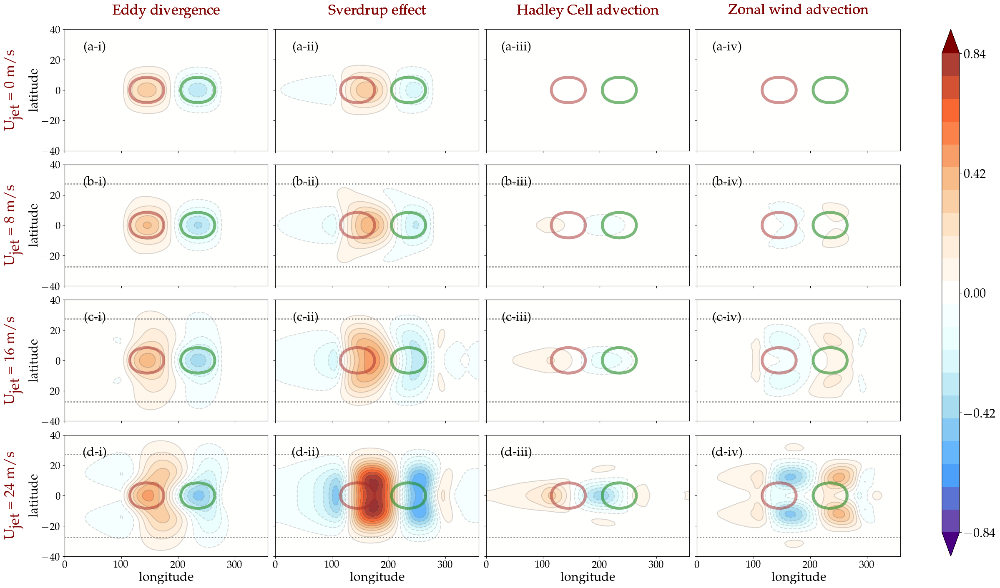

In [77]:
plot_divergence_budget_decomposition(dicti = master_dict['200_0'], step=25, \
                                     filename='div_eddies_decomp_200_weak_jet.pdf', \
                                     save = True, start=5, end=-1, N=19, figsize=(24,14), \
                                     vector = False, UMAX= [0,  8,  16, 24]) # 28, 36, 46

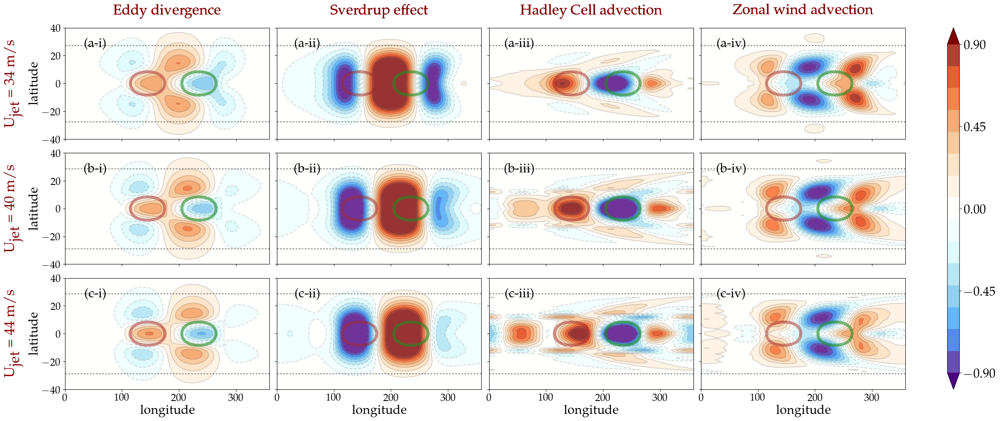

In [80]:
plot_divergence_budget_decomposition(dicti = master_dict['200_0'], step=25, \
                                     filename='div_eddies_decomp_200_strong_jet.pdf', \
                                     save = True, start=5, end=-1, N=19, figsize=(24,3*14//4), \
                                     vector = False, UMAX= [34, 40, 44])

In [78]:
pwd

'/data/pbarpanda/spherical_SWE/jupyter_notebooks/2022_Paper_figures_July'

In [12]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
        ["maroon", "orangered", "sandybrown", "bisque",  "white", "lightcyan", "skyblue", "dodgerblue", "indigo"][::-1])

def vectors(uu, vv, lonn, latt, AX, mag, vector_scale, cmap='gray', alpha=0.5,):   
    Q    = AX.quiver(lonn, latt, uu, vv, mag, cmap=cmap, \
                     alpha=alpha, headwidth=4, headlength=6, width=0.00015*16, scale=vector_scale, \
                     minlength=0)
    AX.quiverkey(Q, 0.15, 1.03, mag, r'%1.2f $m/s$'%(mag), labelpos='E', coordinates='axes', fontproperties = {'size':20}, labelcolor='k',  linewidth = 2)
    return Q, mag


def plot_divergence_budget_decomposition_rot_div_for_small_U(dicti = master_dict['500_0'], umax=10, \
                                                             filename='raw_eddies_500.pdf', save=False, N=10, \
                                                             figsize=(25,8), vector=False, vector_scale=0.8, lo = 10, la=2, vector_max=0.06):
    
    
        def Lrange(Y, dy=10):
            mini = np.abs(np.min(Y))
            maxi = np.abs(np.max(Y))
            maxi = np.round((np.max([(mini), (maxi)])), 1)
            range_values = np.linspace(-maxi, maxi, dy)
            return range_values


        grav = 9.8
        R = 6371e3 
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "indianred", "orange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])
                
        umax_values = (umax) #np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())])[start:end][::step]
        H0_values   = np.sort([int(np.max(dicti['raw_field_dict'][str(key)]['phi_T']/grav)) for key in umax_values])

        col = 2
        row = 1 #len(umax_values)
        fig, axss = py.subplots(row, col, figsize=figsize, constrained_layout=True, sharex=True, sharey=True)

        axs = axss.flatten()
        
        
        UMAX     = umax_values
        keys     = ['beta_term_rot', 'beta_term_div', ]
        
        alphabet = list(string.ascii_lowercase)
        roman_numerals = [''] #'i', 'ii', 'iii'
#         labels = alphabet
        
        labels = []
        for alpha in alphabet :
            for rn in roman_numerals:
                labels.append( '('+alpha+''+rn+')' )
    
        deno = '/'+dicti['vrt_var_name']['ZETA_a']
        extra = r'(U$_{\textrm{jet}}=%d$m/s)'%(umax[0])
        var_names = ['Rotational Sverdrup effect '+extra, 'Divergent Sverdrup effect '+extra]
        units    = [r'$m/s$', r'$m/s$', r'$m/s$', r'$m/s$']   

          
        R= 6371e3
        c = -1 ; r=-1 
        for Umax in (UMAX) :
            r =r+1
            
            co = -1
            for KEY in keys:
                
                co = co+1
                c = c+1
                AX = axs[c]
                
                U_name         = r'U$_{\textrm{jet}}$ = %1d m/s'%(Umax)  
                ds             = dicti['raw_field_dict'][str(Umax)]
                de             = dicti['vrt_budget_dict'][str(Umax)]
                dv_decomp      = dicti['veloc_decomp_dict'][str(Umax)]
                ds_modes       = dicti['mode_decomposition'][str(Umax)] 
                de_rot_div     = dicti['vrt_budget_rot_div_dict'][str(Umax)]
                SCALE  = R
                
                if Umax < 40:
                    LRANGE = np.arange(-0.3, 0.34, 0.04)*2  
                else:
                    LRANGE = np.arange(-0.3, 0.34, 0.04)*4 
                ticks = [np.min(LRANGE),   \
                         np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.25, \
                         np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.50, \
                         np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.75, \
                         np.max(LRANGE)]

                field  = SCALE*eddy(de_rot_div[KEY]/de['ZETA_a'])
                smooth_field = savgol_filter(field, N, 3, axis=0)
                im = AX.contourf( ds['lon'],  ds['lat'], smooth_field, LRANGE,  cmap=cmap2, extend='both', alpha=0.6)
                
                
                field0  = SCALE*eddy(de_rot_div['ZETA_a_D']/de['ZETA_a'])
                smooth_field0 = savgol_filter(field0, N, 3, axis=0)                
                AX.contour( ds['lon'],  ds['lat'], smooth_field0, LRANGE[::1],  colors='gray', alpha=0.4)
        
        
                field  = eddy(ds['phi_forcing'])
                LRANGE = Lrange(field, 20) 
                phi_ticks = [np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.00, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.25, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.75, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*1.00,]


                AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[2]],  colors='brown',         linewidths=5, linestyles='solid', alpha=0.5) 
                AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[1]],  colors='forestgreen',   linewidths=5, linestyles='solid', alpha=0.6) 

                if Umax>0 :            
                    field  = np.nanmean(ds['U'], axis=-1)[:,None]+ds['U']*0
                    AX.contour( ds['lon'],  ds['lat'], field,  [np.nanmax(field)/(1+1e-7)],  colors='gray',   linewidths=2, linestyles='dotted', alpha=0.7) 


                AX.set_ylim(-40,40)

                AX.text(0.03, 1.05, labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=20)
                AX.tick_params(labelsize=18)
                AX.set_xlabel(None, size=22,  labelpad=0.9)
                AX.set_ylabel(None, size=22,  labelpad=0.6)
                
                
                        
                if co == 1:
                    lo = lo; la=la
                    uuD     =  -eddy(dv_decomp ['uD'])
                    vvD     =  -eddy(dv_decomp ['vD'])
                    vector_max   = 0.03 #np.max(u_mag)
                    vector_scale = vector_scale

                    Q, mag = vectors(uuD[::la, ::lo], vvD[::la, ::lo], ds['lon'][::lo], ds['lat'][::la], AX, vector_max, vector_scale, cmap=py.cm.Greens_r, alpha=0.3)
        
        
                if co == 0:
                    lo = lo; la=la
                    uuR     =  -eddy(dv_decomp ['uR'])
                    vvR     =  -eddy(dv_decomp ['vR'])
                    vector_max   = vector_max #np.max(u_mag)
                    vector_scale = vector_scale

                    Q, mag = vectors(uuR[::la, ::lo], vvR[::la, ::lo], ds['lon'][::lo], ds['lat'][::la], AX, vector_max, vector_scale, cmap=py.cm.Greens_r, alpha=0.3)

                          
                
        cbar = fig.colorbar(im, ax=axs.ravel().tolist(), location='right', aspect=15, shrink=1, ticks=ticks)
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(20)
                
        for AX, vname in zip(axss[:], var_names):
            AX.text(0.5,1.16, vname, horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22, rotation=0, color='maroon')
            
        ### To set common x and y axis ###
        py.setp(axss,     xlabel='longitude',)
        py.setp(axss[0],  ylabel='latitude',)

        fig.show()
        
        if save:
            h5saveload.make_sure_path_exists(('./%s_figures/'%(today_date)))
            py.savefig(('./%s_figures/'%(today_date))+filename, pad_inches=0.5, bbox_inches='tight')


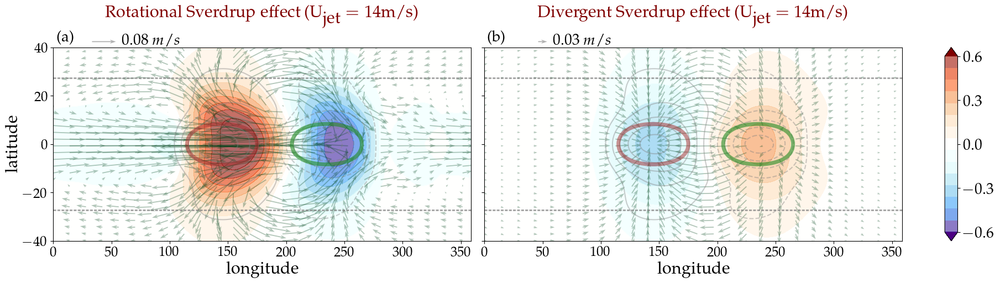

In [82]:
plot_divergence_budget_decomposition_rot_div_for_small_U(dicti = master_dict['200_0'], umax=[14], \
                                     filename='div_sverdrup_decomp_rot_div_200_20ms.pdf', \
                                     save=False, N=19, figsize=(18,5), vector=False, vector_scale=1.4, lo = 10, la=2, vector_max=0.08 )

In [55]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
        ["maroon", "orangered", "sandybrown", "bisque",  "white", "lightcyan", "skyblue", "dodgerblue", "indigo"][::-1])

def vectors(uu, vv, lonn, latt, AX, mag, vector_scale, cmap='gray', alpha=0.5,):   
    Q    = AX.quiver(lonn, latt, uu, vv, mag, cmap=cmap, \
                     alpha=alpha, headwidth=4, headlength=6, width=0.00015*16, scale=vector_scale, \
                     minlength=0)
    AX.quiverkey(Q, 0.15, 1.03, mag, r'%1.2f $m/s$'%(mag), labelpos='E', coordinates='axes', fontproperties = {'size':20}, labelcolor='k',  linewidth = 2)
    return Q, mag


def plot_divergence_budget_decomposition_Kelvin_Rossby_for_small_U(dicti = master_dict['500_0'], umax=[10], \
                                                             filename='raw_eddies_500.pdf', save=False, N=19, \
                                                             figsize=(25,8), vector=False, vector_scale=0.8, lo = 10, la=2, vector_max=0.06,\
                                                             LRANGEs = [np.arange(-0.3, 0.34, 0.04)*1]  ):
    
    
        def Lrange(Y, dy=10):
            mini = np.abs(np.min(Y))
            maxi = np.abs(np.max(Y))
            maxi = np.round((np.max([(mini), (maxi)])), 1)
            range_values = np.linspace(-maxi, maxi, dy)
            return range_values


        grav = 9.8
        R = 6371e3 
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "indianred", "orange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])
                
        umax_values = (umax) #np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())])[start:end][::step]
        H0_values   = np.sort([int(np.max(dicti['raw_field_dict'][str(key)]['phi_T']/grav)) for key in umax_values])

        col = 3
        row = 2 #len(umax_values)
        fig, axss = py.subplots(row, col, figsize=figsize, constrained_layout=True, sharex=True, sharey=True)

        axs = axss.flatten()
        
        
        UMAX     = umax_values
        keys     = [r'Kelvin (n=$-1$)', 'Rossby (n=1)', r'Higher-order modes (n$\geq$2)'] #, 'sum of modes' #r'Higher-order modes (n$\geq$2)'
        Y_names  = [r'$\Delta$(Divergence)', r'$\Delta$ (Sverdrup effect)']
        
        
        alphabet = list(string.ascii_lowercase)
        roman_numerals = ['i', 'ii', 'iii']
        
        
        labels = []
        for alpha in alphabet :
            for rn in roman_numerals:
                labels.append( '('+alpha+'-'+rn+')' )
    
        deno = '/'+dicti['vrt_var_name']['ZETA_a']
        extra = r'(U$_{\textrm{jet}}=%d$m/s)'%(umax[0])
        var_names = keys ##['Rossby Sverdrup effect '+extra, 'Kelvin Sverdrup effect '+extra]
        units    = [r'$m/s$', r'$m/s$', r'$m/s$', r'$m/s$'] 
        
        def tick_func(LRANGE0):
            ticks = [np.min(LRANGE0),   \
                     np.min(LRANGE0)+(np.max(LRANGE0)- np.min(LRANGE0))*0.25, \
                     np.min(LRANGE0)+(np.max(LRANGE0)- np.min(LRANGE0))*0.50, \
                     np.min(LRANGE0)+(np.max(LRANGE0)- np.min(LRANGE0))*0.75, \
                     np.max(LRANGE0)]
            return ticks
        
#         LRANGE0 = LRANGE0
#         ticks = tick_func(LRANGE0)
        
        R= 6371e3
        SCALE = R
        
        Umax = UMAX[0]
        U_name         = r'U$_{\textrm{jet}}$ = %1d m/s'%(Umax)  
        ds             = dicti['raw_field_dict']         [str(Umax)]
        de             = dicti['vrt_budget_dict']        [str(Umax)]
        dv_decomp      = dicti['veloc_decomp_dict']      [str(Umax)]
        ds_modes       = dicti['mode_decomposition']     [str(Umax)] 
        de_rot_div     = dicti['vrt_budget_rot_div_dict'][str(Umax)]

        
        def return_u_v(Umax):
            U_name         = r'U$_{\textrm{jet}}$ = %1d m/s'%(Umax)  
            ds             = dicti['raw_field_dict']         [str(Umax)]
            de             = dicti['vrt_budget_dict']        [str(Umax)]
            dv_decomp      = dicti['veloc_decomp_dict']      [str(Umax)]
            ds_modes       = dicti['mode_decomposition']     [str(Umax)] 
            de_rot_div     = dicti['vrt_budget_rot_div_dict'][str(Umax)]
            SCALE  = R

            vRossby = (ds_modes['v_modes'][2,...])
            uRossby = (ds_modes['u_modes'][2,...])
            vKelvin = ds_modes['v_modes'][0,...]
            uKelvin = ds_modes['u_modes'][0,...]

            uHigher = (ds_modes['u_modes'][3:-5,...]).sum(axis=0)
            vHigher = (ds_modes['v_modes'][3:-5,...]).sum(axis=0)

            sum_v   = (ds_modes['v_modes']).sum(axis=0)
            sum_u   = (ds_modes['u_modes']).sum(axis=0)
            
            return vRossby, vKelvin, vHigher, sum_v, \
                   uRossby, uKelvin, uHigher, sum_u, de, ds
        
        def plot_modes_div(KEY, sverdrup_term = True,):
             
            vRossby1, vKelvin1, vHigher1, sum_v1, uRossby1, uKelvin1, uHigher1, sum_u1, de1, ds1 = return_u_v(UMAX[0]) 
            vRossby2, vKelvin2, vHigher2, sum_v2, uRossby2, uKelvin2, uHigher2, sum_u2, de2, ds2 = return_u_v(UMAX[1])   
                           
            if KEY ==  'Rossby (n=1)':
                uu2, uu1, vv2, vv1  = (uRossby2 , uRossby1,  vRossby2 , vRossby1)

            elif KEY == r'Kelvin (n=$-1$)':
                uu2, uu1, vv2, vv1  = (uKelvin2 , uKelvin1,  vKelvin2 , vKelvin1)

            elif KEY == r'Higher-order modes (n$\geq$2)':
                uu2, uu1, vv2, vv1  = (uHigher2 , uHigher1,  vHigher2 , vHigher1)

            else:
                uu2, uu1, vv2, vv1  = (sum_u2 , sum_u1,  sum_v2 , sum_v1)
                key =  'sum of modes'            
                        
            if sverdrup_term :
                field2  = SCALE*eddy(eddy(vv2)*(de2['beta_term']/de2['ZETA_a']) / eddy(ds2['V']))     
                field1  = SCALE*eddy(eddy(vv1)*(de1['beta_term']/de1['ZETA_a']) / eddy(ds1['V'])) 
                field   = field2 - field1
            else:
                field2 = SCALE*div_func(ds['lat'], ds['lon'], uu2, vv2 )
                field1 = SCALE*div_func(ds['lat'], ds['lon'], uu1, vv1 )
                field  = field2 - field1
 
            uu = uu2 - uu1
            vv = vv2 - vv1
            return uu, vv, field
  
        r  = -1
        co = -1
        c  = -1
        
        for sverdrup_term in [False, True]:
            r = r+1
            
            LRANGE0 = LRANGEs[r]
            ticks = tick_func(LRANGE0)
            
            for KEY in keys:  

                co = co+1
                c  = c+1
                AX = axs[c]

                uu, vv, field = plot_modes_div(KEY, sverdrup_term = sverdrup_term)
                smooth_field = savgol_filter(field, N, 3, axis=0)

                im = AX.contourf( ds['lon'],  ds['lat'], smooth_field, LRANGE0,  cmap=cmap2, extend='both', alpha=0.6) 

                u0, v0, div0  = plot_modes_div('sum of modes', sverdrup_term = False) 
                field0        = div0
                smooth_field0 = savgol_filter(field0, N, 3, axis=0)                
                AX.contour( ds['lon'],  ds['lat'], field0, LRANGEs[0][::2]*1.5,  colors='gray', alpha=0.4)

                field  = eddy(ds['phi_forcing'])
                LRANGE = Lrange(field, 20) 

                phi_ticks = [np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.00, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.25, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.75, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*1.00,]

                AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[2]],  colors='brown',         linewidths=5, linestyles='solid', alpha=0.5) 
                AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[1]],  colors='forestgreen',   linewidths=5, linestyles='solid', alpha=0.6) 

                if Umax>0 :            
                    field  = np.nanmean(ds['U'], axis=-1)[:,None]+ds['U']*0
                    AX.contour( ds['lon'],  ds['lat'], field,  [np.nanmax(field)/(1+1e-7)],  colors='gray',   linewidths=2, linestyles='dotted', alpha=0.7) 

                AX.set_ylim(-40,40)

                AX.text(0.03, 1.05, labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=20)
                AX.tick_params(labelsize=18)
                AX.set_xlabel(None, size=22,  labelpad=0.9)
                AX.set_ylabel(None, size=22,  labelpad=0.6)
                


                if vector:
                    lo = lo; la=la
                    vector_max   = vector_max #np.max(u_mag)
                    vector_scale = vector_scale                 
                    Q, mag = vectors(uu[::la, ::lo], vv[::la, ::lo], ds['lon'][::lo], ds['lat'][::la], AX, vector_max, vector_scale, cmap=py.cm.Greens_r, alpha=0.3)
                
            cbar = fig.colorbar(im, ax=axss[r,:], location='right', aspect=15, shrink=1, ticks=ticks, pad=0.01)
            for t in cbar.ax.get_yticklabels():
                t.set_fontsize(20)
            
            
#         cbar = fig.colorbar(im, ax=axs.ravel().tolist(), location='right', aspect=15, shrink=1, ticks=ticks)
#         for t in cbar.ax.get_yticklabels():
#             t.set_fontsize(20)
                
        for AX, vname in zip(axss[0,:], var_names):
            AX.text(0.5,1.16, vname, horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22, rotation=0, color='maroon')
        
        for AX, yname in zip(axss[:,0], Y_names):
            AX.text(-0.25, 0.5, yname, horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22, rotation=90, color='maroon')

        
        ### To set common x and y axis ###
        py.setp(axss[1,:],  xlabel='longitude',)
        py.setp(axss[:,0],  ylabel='latitude',)

        fig.show()
        
        if save:
            h5saveload.make_sure_path_exists(('./%s_figures/'%(today_date)))
            py.savefig(('./%s_figures/'%(today_date))+filename, pad_inches=0.5, bbox_inches='tight')


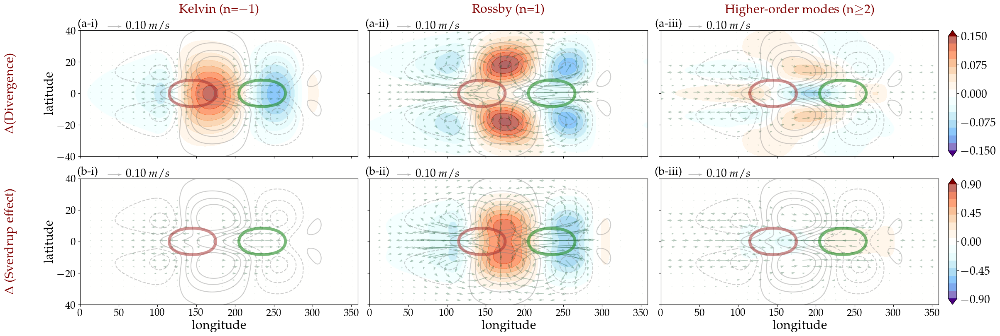

In [71]:
plot_divergence_budget_decomposition_Kelvin_Rossby_for_small_U(dicti  = master_dict['200_0'], umax=[0, 24], \
                                                               filename = 'div_mode_decompositon_increase_0_24.pdf', save=True, N=19, \
                                                               figsize  = (24,8), vector=True, vector_scale=2, lo = 10, la=3, vector_max=0.1, \
                                                               LRANGEs  = [np.arange(-0.3, 0.34, 0.04)/2, np.arange(-0.3, 0.34, 0.04)*3])

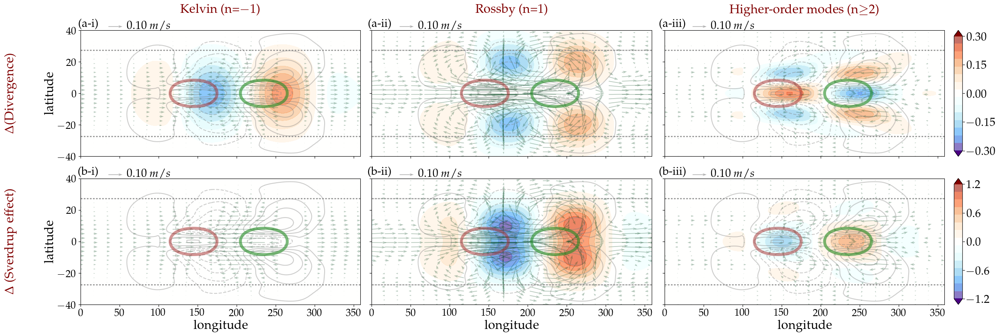

In [72]:
plot_divergence_budget_decomposition_Kelvin_Rossby_for_small_U(dicti  = master_dict['200_0'], umax=[34, 46], \
                                                               filename = 'div_mode_decompositon_decrease_34_46.pdf', save=True,  N=19, \
                                                               figsize  = (24,8), vector=True, vector_scale=2, lo = 12, la=2, vector_max=0.1, \
                                                               LRANGEs  = [np.arange(-0.3, 0.34, 0.04)/1, np.arange(-0.3, 0.34, 0.04)*4])

In [73]:
# master_dict['500_0']['mode_decomposition']['0'].keys()

## Divergence RMS with modes decomposition

$\overline{\left[\phi\right]}D_{rms}^{*}\approx F_{\phi}^{*}\vert_{rms}$

In [34]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      ["maroon", "orangered", "sandybrown", "bisque",  "white", "lightcyan", "skyblue", "dodgerblue", "indigo"][::-1])

R = 6371e3
def rms_near_equator(lat, lon, field, lat_bnd=10):
    forcing_region_field = tropical_mask(lat, lon, field,  0, lat_bnd)
    rms_div              = np.sqrt(np.nanmean(np.nanmean((forcing_region_field**2), axis=-1), axis=-1))
    return rms_div

def latmean_near_equator(lat, lon, field, lat_bnd=10):
    forcing_region_field = tropical_mask(lat, lon, field,  0, lat_bnd)
    rms_div              = (np.nanmean(np.nanmean((forcing_region_field), axis=-1), axis=-1))
    return rms_div

def forcing_region(field, forcing, sign = 1, scale=4):    
    max_phi = np.max(forcing)/scale
    field   = ma.masked_where( sign*forcing < max_phi, field)
    return np.nanmean(field.filled(np.nan))    
    

def return_divergence_change_with_Umax(dicti = master_dict['500_0']):
    
        div_line_data = {}
    
        grav = 9.8
        R = 6371e3 
        umax_values = np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())]) #[::step]
        UMAX = umax_values
        grav = 10

        R= 6371e3
        
        DIV_rms  = []
        DIV_rms_estimate = []
        DIV_modes_rms = []
        DIV_sum_modes_rms = []
        DIV_high_pcf_rms  = []
        
        
        DIV_force           = []
        DIV_modes_force     = []
        DIV_sum_modes_force = []
        DIV_high_pcf_force  = []
        
        c = -1
        for Umax in (UMAX) :
            
            var_name = r'U$_{\textrm{jet}}$ = %1d m/s'%(Umax)    
            ds       = dicti['raw_field_dict'][str(Umax)]
            de       = dicti['vrt_budget_dict'][str(Umax)]
            ds_modes = dicti['mode_decomposition'][str(Umax)] 
            
            SCALE    = R 
            
            forcing  = ds['phi_forcing']/(10*24*3600)
            PHI_mean = latmean_near_equator(ds['lat'], ds['lon'], ds['PHI'])
            field    = SCALE*eddy(de['div']) 
            DIV_rms  .append( rms_near_equator(ds['lat'], ds['lon'], field) )
            DIV_rms_estimate.append( SCALE* rms_near_equator(ds['lat'], ds['lon'], forcing)/PHI_mean )  ######################################
            DIV_force.append( forcing_region(field, forcing, sign = 1, scale=4) )
            
            div_modes = SCALE*div_func(ds['lat'], ds['lon'], ds_modes['u_modes'], ds_modes['v_modes'])
            
            div_modes_forcing = np.zeros(div_modes.shape[0])
            div_modes_rms     = np.zeros(div_modes.shape[0])
            for m in range(div_modes.shape[0]):
                div_modes_rms[m]     = (rms_near_equator(ds['lat'], ds['lon'], div_modes[m,...]) )
                div_modes_forcing[m] = (forcing_region(div_modes[m,...], forcing, sign = 1, scale=4))
            
            
            DIV_high_pcf_rms.append((rms_near_equator(ds['lat'], ds['lon'], div_modes[3:,...].sum(axis=0)) )) 
            DIV_high_pcf_force.append( (forcing_region(div_modes[3:,...].sum(axis=0), forcing, sign = 1, scale=4)) )
            
            DIV_sum_modes_rms.append((rms_near_equator(ds['lat'], ds['lon'], div_modes.sum(axis=0)) )) 
            DIV_sum_modes_force.append( (forcing_region(div_modes.sum(axis=0), forcing, sign = 1, scale=4)) ) 
            
            DIV_modes_rms.append(div_modes_rms)
            DIV_modes_force.append(div_modes_forcing)
    
        
        div_line_data['DIV_rms']             = np.stack(DIV_rms)
        div_line_data['DIV_rms_estimate']    = np.stack(DIV_rms_estimate)
        div_line_data['DIV_force']           = np.stack(DIV_force)
        div_line_data['DIV_sum_modes_rms']   = np.stack(DIV_sum_modes_rms)
        div_line_data['DIV_sum_modes_force'] = np.stack(DIV_sum_modes_force)
        
        div_line_data['DIV_high_pcf_rms']    = np.stack(DIV_high_pcf_rms)
        div_line_data['DIV_high_pcf_force']  = np.stack(DIV_high_pcf_force)

        div_line_data['DIV_modes_rms']       = np.stack(DIV_modes_rms).T
        div_line_data['DIV_modes_force']     = np.stack(DIV_modes_force).T
        div_line_data['Umax']                = UMAX
        
        dicti['div_line_data']               = div_line_data
        
        return dicti

        

In [35]:
master_dict['500_0'] = return_divergence_change_with_Umax(dicti = master_dict['500_0'])
master_dict['200_0'] = return_divergence_change_with_Umax(dicti = master_dict['200_0'])

In [31]:
# master_dict['500_0']['div_line_data']['DIV_rms'].shape

In [46]:
py.rcParams.update( { "text.usetex": True,
                      "font.family": "serif",
                     "font.serif": ["Palatino"] } )

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      ["maroon", "orangered", "sandybrown", "bisque",  "white", "lightcyan", "skyblue", "dodgerblue", "indigo"][::-1])

R = 6371e3
    
def plot_divergence_change_with_Umax(dicti = master_dict['500_0'], step=1, filename='div_line_eddies_500.pdf', save=False, Uc=50, figsize=(20,7), YLIM=(0.01,0.06)):
    
        div_line_data = dicti['div_line_data']
    
        grav = 9.8
        R = 6371e3 
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              ["indianred", "orange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])
        
        umax_values = np.sort([int(i) for i in list(div_line_data['Umax'])])[::step]

        col = 2
        row = 1
        fig, axss = py.subplots(row, col, figsize=figsize, constrained_layout=True, sharex=True, sharey=False)

        axs = axss.T.flatten()

        UMAX     = umax_values
        alphabet = list(string.ascii_lowercase)
        labels   = [('('+alpha+')') for alpha in alphabet]
        grav     = 10
        
        
        c = 0
        AX = axss[c]
        AX.plot(div_line_data['Umax'], div_line_data['DIV_rms'],   'c-' ,          lw=6, label='model result')
        AX.plot(div_line_data['Umax'], div_line_data['DIV_rms_estimate'],  '-.' , c='orange', lw=3, label='linear approx.')
        AX.plot(div_line_data['Umax'], div_line_data['DIV_sum_modes_rms'], 'k--' , lw=2, label='sum of all modes')
        AX.tick_params(labelsize=20)
        AX.set_title(r'Tropical $ \left( R\sqrt {\overline{(\mathbf{\nabla}.\mathbf{v}^{*})^2}} \right)$', fontsize=22)
        AX.set_ylabel('RMS divergence [m/s]', fontsize=25)
        AX.set_xlabel(r'$U_{\textrm{jet}}$ [m/s]', fontsize=25)
        AX.legend(loc='best', fontsize=20)
        AX.text(0.03, 1.05, labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22)
        AX.axvline(Uc, color='k')

        
        c = 1
        AX = axss[c]
        MODES_NUM = div_line_data['DIV_modes_rms'].shape[0]
        value  = np.arange(0, MODES_NUM, 2)
        value  = value[:len(value)//2+5]
        dvalue = value[1]-value[0]
        cmap2  = py.get_cmap(py.cm.gist_stern)
               
        AX.plot(div_line_data['Umax'], div_line_data['DIV_modes_rms'][::2,:][0, :], '-', c='black',       lw=6,   label='Kelvin', alpha=0.5)
        AX.plot(div_line_data['Umax'], div_line_data['DIV_modes_rms'][::2,:][1, :], '-', c='dodgerblue',  lw=6,   label='Rossby' )
        AX.plot(div_line_data['Umax'], div_line_data['DIV_high_pcf_rms'],           '-', c='red',         lw=6,   label='Higher-order modes', alpha=0.5)
        AX.set_ylim(*YLIM)  
    
        AX.text(0.03, 1.05, labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22)
        AX.legend(loc='best', fontsize=20)
#         AX.legend(bbox_to_anchor=(1.01, 1.0), loc='upper left', fontsize=15)

        AX.tick_params(labelsize=25)
        AX.set_title(r'Tropical $ \left( R\sqrt {\overline{(\mathbf{\nabla}.\mathbf{v}^{*})^2}} \right)$ decomposed into modes', fontsize=22)
        AX.set_xlabel(r'U$_{\textrm{jet}}$ [m/s]', fontsize=25)
        AX.axvline(Uc, color='k')
        
        if save:
            h5saveload.make_sure_path_exists(('./%s_figures/'%(today_date)))
            py.savefig(('./%s_figures/'%(today_date))+filename, pad_inches=0.5, bbox_inches='tight')


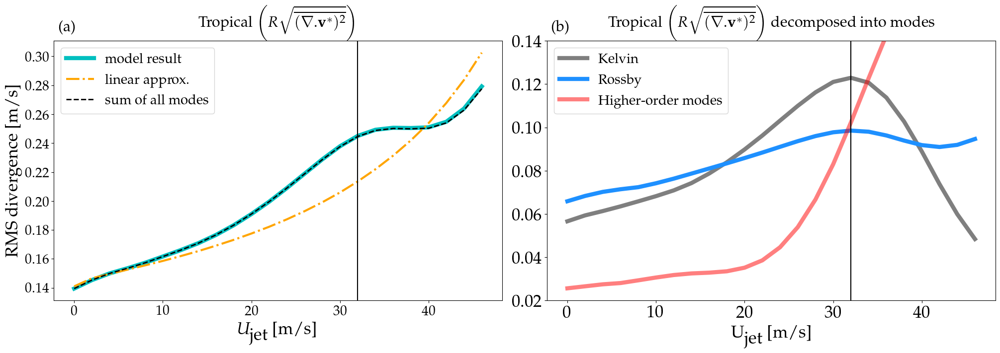

In [81]:
plot_divergence_change_with_Umax(dicti = master_dict['200_0'], step=1, filename='thermal_forcing_div_line_eddies_200.pdf', save=True, Uc=32, YLIM=(0.02,0.14))

In [42]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
        ["maroon", "orangered", "sandybrown", "bisque",  "white", "lightcyan", "skyblue", "dodgerblue", "indigo"][::-1])

def vectors(uu, vv, lonn, latt, AX, mag, vector_scale, cmap='gray', alpha=0.5,):   
    Q    = AX.quiver(lonn, latt, uu, vv, mag, cmap=cmap, \
                     alpha=alpha, headwidth=4, headlength=6, width=0.00015*16, scale=vector_scale, \
                     minlength=0)
    AX.quiverkey(Q, 0.15, 1.03, mag, r'%1.2f $m/s$'%(mag), labelpos='E', coordinates='axes', fontproperties = {'size':20}, labelcolor='k',  linewidth = 2)
    return Q, mag


def plot_divergence_budget_decomposition_Kelvin_Rossby_for_small_U(dicti = master_dict['500_0'], umax=[10], \
                                                             filename='raw_eddies_500.pdf', save=False, N=19, \
                                                             figsize=(25,8), vector=False, vector_scale=0.8, lo = 10, la=2, vector_max=0.06,\
                                                             LRANGEs = [np.arange(-0.3, 0.34, 0.04)*1]  ):
    
    
        def Lrange(Y, dy=10):
            mini = np.abs(np.min(Y))
            maxi = np.abs(np.max(Y))
            maxi = np.round((np.max([(mini), (maxi)])), 1)
            range_values = np.linspace(-maxi, maxi, dy)
            return range_values


        grav = 9.8
        R = 6371e3 
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "indianred", "orange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])
                
        umax_values = (umax) #np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())])[start:end][::step]
        H0_values   = np.sort([int(np.max(dicti['raw_field_dict'][str(key)]['phi_T']/grav)) for key in umax_values])

        col = 2
        row = 2 #len(umax_values)
        fig, axss = py.subplots(row, col, figsize=figsize, constrained_layout=True, sharex=True, sharey=True)

        axs = axss.flatten()
        
        
        UMAX     = umax_values
        keys     = [r'Kelvin (n=$-1$)', 'Rossby (n=1)'] #, 'sum of modes' #r'Higher-order modes (n$\geq$2)'
        
        alphabet = list(string.ascii_lowercase)
        roman_numerals = ['i', 'ii']
        
        labels = []
        for alpha in alphabet :
            for rn in roman_numerals:
                labels.append( '('+alpha+'-'+rn+')' )
    
        deno = '/'+dicti['vrt_var_name']['ZETA_a']
        extra = r'(U$_{\textrm{jet}}=%d$m/s)'%(umax[0])
        var_names = keys ##['Rossby Sverdrup effect '+extra, 'Kelvin Sverdrup effect '+extra]
        units    = [r'$m/s$', r'$m/s$', r'$m/s$', r'$m/s$'] 
        
        def tick_func(LRANGE0):
            ticks = [np.min(LRANGE0),   \
                     np.min(LRANGE0)+(np.max(LRANGE0)- np.min(LRANGE0))*0.25, \
                     np.min(LRANGE0)+(np.max(LRANGE0)- np.min(LRANGE0))*0.50, \
                     np.min(LRANGE0)+(np.max(LRANGE0)- np.min(LRANGE0))*0.75, \
                     np.max(LRANGE0)]
            return ticks
        
#         LRANGE0 = LRANGE0
#         ticks = tick_func(LRANGE0)
        
        R= 6371e3
        SCALE = R
        
        Umax = UMAX[0]
        U_name         = r'U$_{\textrm{jet}}$ = %1d m/s'%(Umax)  
        ds             = dicti['raw_field_dict']         [str(Umax)]
        de             = dicti['vrt_budget_dict']        [str(Umax)]
        dv_decomp      = dicti['veloc_decomp_dict']      [str(Umax)]
        ds_modes       = dicti['mode_decomposition']     [str(Umax)] 
        de_rot_div     = dicti['vrt_budget_rot_div_dict'][str(Umax)]

        
        def return_u_v(Umax):
            U_name         = r'U$_{\textrm{jet}}$ = %1d m/s'%(Umax)  
            ds             = dicti['raw_field_dict']         [str(Umax)]
            de             = dicti['vrt_budget_dict']        [str(Umax)]
            dv_decomp      = dicti['veloc_decomp_dict']      [str(Umax)]
            ds_modes       = dicti['mode_decomposition']     [str(Umax)] 
            de_rot_div     = dicti['vrt_budget_rot_div_dict'][str(Umax)]
            SCALE  = R

            vRossby = (ds_modes['v_modes'][2,...])
            uRossby = (ds_modes['u_modes'][2,...])
            vKelvin = ds_modes['v_modes'][0,...]
            uKelvin = ds_modes['u_modes'][0,...]

            uHigher = (ds_modes['u_modes'][3:-5,...]).sum(axis=0)
            vHigher = (ds_modes['v_modes'][3:-5,...]).sum(axis=0)

            sum_v   = (ds_modes['v_modes']).sum(axis=0)
            sum_u   = (ds_modes['u_modes']).sum(axis=0)
            
            return vRossby, vKelvin, vHigher, sum_v, \
                   uRossby, uKelvin, uHigher, sum_u, de, ds
        
        def plot_modes_div(KEY, sverdrup_term = True,):
             
            vRossby1, vKelvin1, vHigher1, sum_v1, uRossby1, uKelvin1, uHigher1, sum_u1, de1, ds1 = return_u_v(UMAX[0]) 
            vRossby2, vKelvin2, vHigher2, sum_v2, uRossby2, uKelvin2, uHigher2, sum_u2, de2, ds2 = return_u_v(UMAX[1])   
                           
            if KEY ==  'Rossby (n=1)':
                uu2, uu1, vv2, vv1  = (uRossby2 , uRossby1,  vRossby2 , vRossby1)

            elif KEY == r'Kelvin (n=$-1$)':
                uu2, uu1, vv2, vv1  = (uKelvin2 , uKelvin1,  vKelvin2 , vKelvin1)

            elif KEY == r'Higher-order modes (n$\geq$2)':
                uu2, uu1, vv2, vv1  = (uHigher2 , uHigher1,  vHigher2 , vHigher1)

            else:
                uu2, uu1, vv2, vv1  = (sum_u2 , sum_u1,  sum_v2 , sum_v1)
                key =  'sum of modes'            
                        
            if sverdrup_term :
                field2  = SCALE*eddy(eddy(vv2)*(de2['beta_term']/de2['ZETA_a']) / eddy(ds2['V']))     
                field1  = SCALE*eddy(eddy(vv1)*(de1['beta_term']/de1['ZETA_a']) / eddy(ds1['V'])) 
                field   = field2 - field1
            else:
                field2 = SCALE*div_func(ds['lat'], ds['lon'], uu2, vv2 )
                field1 = SCALE*div_func(ds['lat'], ds['lon'], uu1, vv1 )
                field  = field2 - field1
 
            uu = uu2 - uu1
            vv = vv2 - vv1
            return uu, vv, field
  
        r  = -1
        co = -1
        c  = -1
        
        for sverdrup_term in [False, True]:
            r = r+1
            
            LRANGE = LRANGEs[r]
            ticks = tick_func(LRANGE)
            
            for KEY in keys:  

                co = co+1
                c  = c+1
                AX = axs[c]

                uu, vv, field = plot_modes_div(KEY, sverdrup_term = sverdrup_term)
                smooth_field = savgol_filter(field, N, 3, axis=0)

                im = AX.contourf( ds['lon'],  ds['lat'], smooth_field, LRANGE0,  cmap=cmap2, extend='both', alpha=0.6) 

                u0, v0, div0  = plot_modes_div(KEY, sverdrup_term = False)
                field0        = div0
                smooth_field0 = savgol_filter(field0, N, 3, axis=0)                
                AX.contour( ds['lon'],  ds['lat'], smooth_field0, LRANGE0[::1],  colors='gray', alpha=0.4)

                field  = eddy(ds['phi_forcing'])
                LRANGE = Lrange(field, 20) 

                phi_ticks = [np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.00, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.25, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.75, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*1.00,]

                AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[2]],  colors='brown',         linewidths=5, linestyles='solid', alpha=0.5) 
                AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[1]],  colors='forestgreen',   linewidths=5, linestyles='solid', alpha=0.6) 

                if Umax>0 :            
                    field  = np.nanmean(ds['U'], axis=-1)[:,None]+ds['U']*0
                    AX.contour( ds['lon'],  ds['lat'], field,  [np.nanmax(field)/(1+1e-7)],  colors='gray',   linewidths=2, linestyles='dotted', alpha=0.7) 

                AX.set_ylim(-40,40)

                AX.text(0.03, 1.05, labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=20)
                AX.tick_params(labelsize=18)
                AX.set_xlabel(None, size=22,  labelpad=0.9)
                AX.set_ylabel(None, size=22,  labelpad=0.6)
                


                if vector:
                    lo = lo; la=la
                    vector_max   = vector_max #np.max(u_mag)
                    vector_scale = vector_scale                 
                    Q, mag = vectors(uu[::la, ::lo], vv[::la, ::lo], ds['lon'][::lo], ds['lat'][::la], AX, vector_max, vector_scale, cmap=py.cm.Greens_r, alpha=0.3)
                
            cbar = fig.colorbar(im, ax=axss[r,:], location='right', aspect=15, shrink=1, ticks=ticks)
            for t in cbar.ax.get_yticklabels():
                t.set_fontsize(20)
            
            
#         cbar = fig.colorbar(im, ax=axs.ravel().tolist(), location='right', aspect=15, shrink=1, ticks=ticks)
#         for t in cbar.ax.get_yticklabels():
#             t.set_fontsize(20)
                
        for AX, vname in zip(axss[0,:], var_names):
            AX.text(0.5,1.16, vname, horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22, rotation=0, color='maroon')
            
        ### To set common x and y axis ###
        py.setp(axss[1,:],  xlabel='longitude',)
        py.setp(axss[:,0],  ylabel='latitude',)

        fig.show()
        
        if save:
            h5saveload.make_sure_path_exists(('./%s_figures/'%(today_date)))
            py.savefig(('./%s_figures/'%(today_date))+filename, pad_inches=0.5, bbox_inches='tight')


In [114]:
pwd

'/data/pbarpanda/spherical_SWE/jupyter_notebooks/2022_Paper_figures_July'

In [39]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
        ["maroon", "orangered", "sandybrown", "bisque",  "white", "lightcyan", "skyblue", "dodgerblue", "indigo"][::-1])

def vectors(uu, vv, lonn, latt, AX, mag, vector_scale, cmap='gray', alpha=0.5,):   
    Q    = AX.quiver(lonn, latt, uu, vv, mag, cmap=cmap, \
                     alpha=alpha, headwidth=4, headlength=6, width=0.00015*16, scale=vector_scale, \
                     minlength=0)
    AX.quiverkey(Q, 0.15, 1.03, mag, r'%1.2f $m/s$'%(mag), labelpos='E', coordinates='axes', fontproperties = {'size':20}, labelcolor='k',  linewidth = 2)
    return Q, mag


def plot_divergence_budget_decomposition_Kelvin_Rossby_for_small_U(dicti = master_dict['500_0'], umax=10, \
                                                             filename='raw_eddies_500.pdf', save=False, N=10, \
                                                             figsize=(25,8), vector=False, vector_scale=0.8, lo = 10, la=2, vector_max=0.06,\
                                                             LRANGE0 = np.arange(-0.3, 0.34, 0.04)*1  ):
    
    
        def Lrange(Y, dy=10):
            mini = np.abs(np.min(Y))
            maxi = np.abs(np.max(Y))
            maxi = np.round((np.max([(mini), (maxi)])), 1)
            range_values = np.linspace(-maxi, maxi, dy)
            return range_values


        grav = 9.8
        R = 6371e3 
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "indianred", "orange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])
                
        umax_values = (umax) #np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())])[start:end][::step]
        H0_values   = np.sort([int(np.max(dicti['raw_field_dict'][str(key)]['phi_T']/grav)) for key in umax_values])

        col = 3
        row = 1 #len(umax_values)
        fig, axss = py.subplots(row, col, figsize=figsize, constrained_layout=True, sharex=True, sharey=True)

        axs = axss.flatten()
        
        
        UMAX     = umax_values
        keys     = [r'Kelvin (n=$-1$)', 'Rossby (n=1)', r'Higher-order modes (n$\geq$2)'] #, 'sum of modes'
        
        alphabet = list(string.ascii_lowercase)
        roman_numerals = [''] #'i', 'ii', 'iii'
#         labels = alphabet
        
        labels = []
        for alpha in alphabet :
            for rn in roman_numerals:
                labels.append( '('+alpha+''+rn+')' )
    
        deno = '/'+dicti['vrt_var_name']['ZETA_a']
        extra = r'(U$_{\textrm{jet}}=%d$m/s)'%(umax[0])
        var_names = keys ##['Rossby Sverdrup effect '+extra, 'Kelvin Sverdrup effect '+extra]
        units    = [r'$m/s$', r'$m/s$', r'$m/s$', r'$m/s$']   

          
        R= 6371e3
        c = -1 ; r=-1 
        for Umax in (UMAX) :
            r =r+1
            
            co = -1
            for KEY in keys:
                
                co = co+1
                c = c+1
                AX = axs[c]
                
                U_name         = r'U$_{\textrm{jet}}$ = %1d m/s'%(Umax)  
                ds             = dicti['raw_field_dict']         [str(Umax)]
                de             = dicti['vrt_budget_dict']        [str(Umax)]
                dv_decomp      = dicti['veloc_decomp_dict']      [str(Umax)]
                ds_modes       = dicti['mode_decomposition']     [str(Umax)] 
                de_rot_div     = dicti['vrt_budget_rot_div_dict'][str(Umax)]
                SCALE  = R
                
                LRANGE0 = LRANGE0
                ticks = [np.min(LRANGE0),   \
                         np.min(LRANGE0)+(np.max(LRANGE0)- np.min(LRANGE0))*0.25, \
                         np.min(LRANGE0)+(np.max(LRANGE0)- np.min(LRANGE0))*0.50, \
                         np.min(LRANGE0)+(np.max(LRANGE0)- np.min(LRANGE0))*0.75, \
                         np.max(LRANGE0)]

                
                
                
                vRossby = (ds_modes['v_modes'][2:3,...]).sum(axis=0)
                uRossby = (ds_modes['u_modes'][2:3,...]).sum(axis=0)
                vKelvin = ds_modes['v_modes'][0,...]
                uKelvin = ds_modes['u_modes'][0,...]
                
                uHigher = (ds_modes['u_modes'][4:-5,...]).sum(axis=0)
                vHigher = (ds_modes['v_modes'][4:-5,...]).sum(axis=0)
                
                sum_v   = (ds_modes['v_modes']).sum(axis=0)
                sum_u   = (ds_modes['u_modes']).sum(axis=0)
                
                if KEY ==  'Rossby (n=1)':
                    field  = SCALE*eddy(   eddy(vRossby)*(de['beta_term']/de['ZETA_a']) / eddy(ds['V'])  )
                    uu,vv  = uRossby, vRossby 
                    
                elif KEY == r'Kelvin (n=$-1$)':
                    field  = SCALE*eddy(   eddy(vKelvin)*(de['beta_term']/de['ZETA_a']) / eddy(ds['V'])  )
                    uu,vv  = uKelvin, vKelvin
                    
                elif KEY == r'Higher-order modes (n$\geq$2)':
                    field  = SCALE*eddy(   eddy(vHigher)*(de['beta_term']/de['ZETA_a']) / eddy(ds['V'])  )
                    uu,vv  = uHigher, vHigher
                    
                else:
                    field  = SCALE*eddy(   eddy(sum_v)*(de['beta_term']/de['ZETA_a']) / eddy(ds['V'])  )
                    uu,vv  = sum_u, sum_v
                    key =  'sum of modes'
                
                smooth_field = savgol_filter(field, N, 3, axis=0)
                im = AX.contourf( ds['lon'],  ds['lat'], smooth_field, LRANGE0,  cmap=cmap2, extend='both', alpha=0.6)                
                
                field0  = SCALE*eddy(de_rot_div['ZETA_a_D']/de['ZETA_a'])
                smooth_field0 = savgol_filter(field0, N, 3, axis=0)                
                AX.contour( ds['lon'],  ds['lat'], smooth_field0, LRANGE0[::1],  colors='gray', alpha=0.4)
        
        
                field  = eddy(ds['phi_forcing'])
                LRANGE = Lrange(field, 20) 
                
                phi_ticks = [np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.00, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.25, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.75, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*1.00,]

                AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[2]],  colors='brown',         linewidths=5, linestyles='solid', alpha=0.5) 
                AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[1]],  colors='forestgreen',   linewidths=5, linestyles='solid', alpha=0.6) 

                if Umax>0 :            
                    field  = np.nanmean(ds['U'], axis=-1)[:,None]+ds['U']*0
                    AX.contour( ds['lon'],  ds['lat'], field,  [np.nanmax(field)/(1+1e-7)],  colors='gray',   linewidths=2, linestyles='dotted', alpha=0.7) 

                AX.set_ylim(-40,40)

                AX.text(0.03, 1.05, labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=20)
                AX.tick_params(labelsize=18)
                AX.set_xlabel(None, size=22,  labelpad=0.9)
                AX.set_ylabel(None, size=22,  labelpad=0.6)

                
                lo = lo; la=la
                vector_max   = vector_max #np.max(u_mag)
                vector_scale = vector_scale                 
                Q, mag = vectors(-uu[::la, ::lo], -vv[::la, ::lo], ds['lon'][::lo], ds['lat'][::la], AX, vector_max, vector_scale, cmap=py.cm.Greens_r, alpha=0.3)
                
                          
        cbar = fig.colorbar(im, ax=axs.ravel().tolist(), location='right', aspect=15, shrink=1, ticks=ticks)
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(20)
                
        for AX, vname in zip(axss[:], var_names):
            AX.text(0.5,1.16, vname, horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22, rotation=0, color='maroon')
            
        ### To set common x and y axis ###
        py.setp(axss,     xlabel='longitude',)
        py.setp(axss[0],  ylabel='latitude',)

        fig.show()
        
        if save:
            h5saveload.make_sure_path_exists(('./%s_figures/'%(today_date)))
            py.savefig(('./%s_figures/'%(today_date))+filename, pad_inches=0.5, bbox_inches='tight')


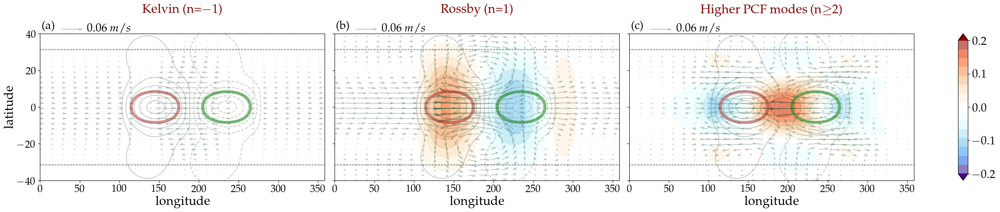

In [88]:
plot_divergence_budget_decomposition_Kelvin_Rossby_for_small_U(dicti = master_dict['500_0'], umax=[20], \
                                                             filename='Sverdrup_effect_500_20ms.pdf', save=True, N=19, \
                                                             figsize=(24,5), vector=False, vector_scale=0.8, lo = 10, la=2, vector_max=0.06, \
                                                             LRANGE0 = np.arange(-0.3, 0.34, 0.04)/1.5)

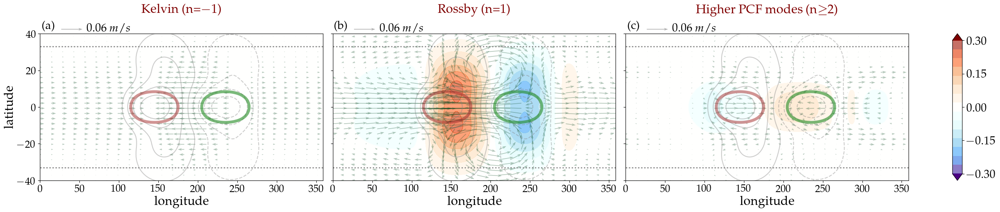

In [90]:
plot_divergence_budget_decomposition_Kelvin_Rossby_for_small_U(dicti = master_dict['500_0'], umax=[30], \
                                                             filename='Sverdrup_effect_500_30ms.pdf', save=True, N=19, \
                                                             figsize=(24,5), vector=False, vector_scale=0.8, lo = 10, la=2, vector_max=0.06, \
                                                             LRANGE0 = np.arange(-0.3, 0.34, 0.04)/1)

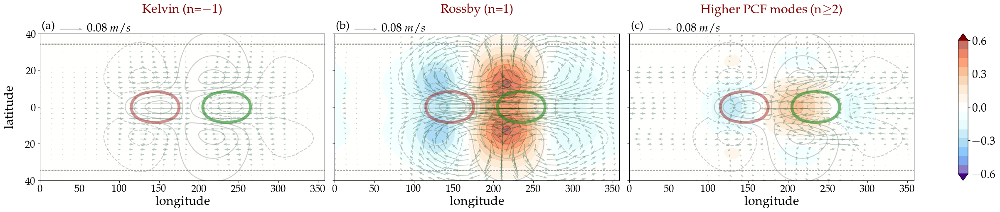

In [94]:
plot_divergence_budget_decomposition_Kelvin_Rossby_for_small_U(dicti = master_dict['500_0'], umax=[60], \
                                                             filename='Sverdrup_effect_500_60ms.pdf', save=True, N=19, \
                                                             figsize=(24,5), vector=False, vector_scale=1, lo = 10, la=2, vector_max=0.08, \
                                                             LRANGE0 = np.arange(-0.3, 0.34, 0.04)*2)

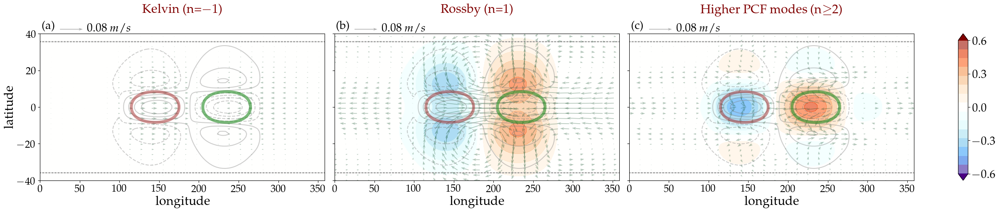

In [96]:
plot_divergence_budget_decomposition_Kelvin_Rossby_for_small_U(dicti = master_dict['500_0'], umax=[78], \
                                                             filename='Sverdrup_effect_500_78ms.pdf', save=True, N=19, \
                                                             figsize=(24,5), vector=False, vector_scale=1, lo = 10, la=2, vector_max=0.08, \
                                                             LRANGE0 = np.arange(-0.3, 0.34, 0.04)*2)

In [180]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
        ["maroon", "orangered", "sandybrown", "bisque",  "white", "lightcyan", "skyblue", "dodgerblue", "indigo"][::-1])

def vectors(uu, vv, lonn, latt, AX, mag, vector_scale, cmap='gray', alpha=0.5,):   
    Q    = AX.quiver(lonn, latt, uu, vv, mag, cmap=cmap, \
                     alpha=alpha, headwidth=4, headlength=6, width=0.00015*16, scale=vector_scale, \
                     minlength=0)
    AX.quiverkey(Q, 0.15, 1.03, mag, r'%1.2f $m/s$'%(mag), labelpos='E', coordinates='axes', fontproperties = {'size':20}, labelcolor='k',  linewidth = 2)
    return Q, mag


def plot_divergence_budget_decomposition_Kelvin_Rossby_for_small_U(dicti = master_dict['500_0'], umax=[10], \
                                                             filename='raw_eddies_500.pdf', save=False, N=19, \
                                                             figsize=(25,8), vector=False, vector_scale=0.8, lo = 10, la=2, vector_max=0.06,\
                                                             LRANGEs = [np.arange(-0.3, 0.34, 0.04)*1]  ):
    
    
        def Lrange(Y, dy=10):
            mini = np.abs(np.min(Y))
            maxi = np.abs(np.max(Y))
            maxi = np.round((np.max([(mini), (maxi)])), 1)
            range_values = np.linspace(-maxi, maxi, dy)
            return range_values


        grav = 9.8
        R = 6371e3 
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "indianred", "orange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])
                
        umax_values = (umax) #np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())])[start:end][::step]
        H0_values   = np.sort([int(np.max(dicti['raw_field_dict'][str(key)]['phi_T']/grav)) for key in umax_values])

        col = 2
        row = 2 #len(umax_values)
        fig, axss = py.subplots(row, col, figsize=figsize, constrained_layout=True, sharex=True, sharey=True)

        axs = axss.flatten()
        
        
        UMAX     = umax_values
        keys     = [r'Kelvin (n=$-1$)', 'Rossby (n=1)'] #, 'sum of modes' #r'Higher-order modes (n$\geq$2)'
        
        alphabet = list(string.ascii_lowercase)
        roman_numerals = ['i', 'ii']
        
        labels = []
        for alpha in alphabet :
            for rn in roman_numerals:
                labels.append( '('+alpha+'-'+rn+')' )
    
        deno = '/'+dicti['vrt_var_name']['ZETA_a']
        extra = r'(U$_{\textrm{jet}}=%d$m/s)'%(umax[0])
        var_names = keys ##['Rossby Sverdrup effect '+extra, 'Kelvin Sverdrup effect '+extra]
        units    = [r'$m/s$', r'$m/s$', r'$m/s$', r'$m/s$'] 
        
        def tick_func(LRANGE0):
            ticks = [np.min(LRANGE0),   \
                     np.min(LRANGE0)+(np.max(LRANGE0)- np.min(LRANGE0))*0.25, \
                     np.min(LRANGE0)+(np.max(LRANGE0)- np.min(LRANGE0))*0.50, \
                     np.min(LRANGE0)+(np.max(LRANGE0)- np.min(LRANGE0))*0.75, \
                     np.max(LRANGE0)]
            return ticks
        
#         LRANGE0 = LRANGE0
#         ticks = tick_func(LRANGE0)
        
        R= 6371e3
        SCALE = R
        
        Umax = UMAX[0]
        U_name         = r'U$_{\textrm{jet}}$ = %1d m/s'%(Umax)  
        ds             = dicti['raw_field_dict']         [str(Umax)]
        de             = dicti['vrt_budget_dict']        [str(Umax)]
        dv_decomp      = dicti['veloc_decomp_dict']      [str(Umax)]
        ds_modes       = dicti['mode_decomposition']     [str(Umax)] 
        de_rot_div     = dicti['vrt_budget_rot_div_dict'][str(Umax)]

        
        def return_u_v(Umax):
            U_name         = r'U$_{\textrm{jet}}$ = %1d m/s'%(Umax)  
            ds             = dicti['raw_field_dict']         [str(Umax)]
            de             = dicti['vrt_budget_dict']        [str(Umax)]
            dv_decomp      = dicti['veloc_decomp_dict']      [str(Umax)]
            ds_modes       = dicti['mode_decomposition']     [str(Umax)] 
            de_rot_div     = dicti['vrt_budget_rot_div_dict'][str(Umax)]
            SCALE  = R

            vRossby = (ds_modes['v_modes'][2,...])
            uRossby = (ds_modes['u_modes'][2,...])
            vKelvin = ds_modes['v_modes'][0,...]
            uKelvin = ds_modes['u_modes'][0,...]

            uHigher = (ds_modes['u_modes'][3:-5,...]).sum(axis=0)
            vHigher = (ds_modes['v_modes'][3:-5,...]).sum(axis=0)

            sum_v   = (ds_modes['v_modes']).sum(axis=0)
            sum_u   = (ds_modes['u_modes']).sum(axis=0)
            
            return vRossby, vKelvin, vHigher, sum_v, \
                   uRossby, uKelvin, uHigher, sum_u, de, ds
        
        def plot_modes_div(KEY, sverdrup_term = True,):
             
            vRossby1, vKelvin1, vHigher1, sum_v1, uRossby1, uKelvin1, uHigher1, sum_u1, de1, ds1 = return_u_v(UMAX[0]) 
            vRossby2, vKelvin2, vHigher2, sum_v2, uRossby2, uKelvin2, uHigher2, sum_u2, de2, ds2 = return_u_v(UMAX[1])   
                           
            if KEY ==  'Rossby (n=1)':
                uu2, uu1, vv2, vv1  = (uRossby2 , uRossby1,  vRossby2 , vRossby1)

            elif KEY == r'Kelvin (n=$-1$)':
                uu2, uu1, vv2, vv1  = (uKelvin2 , uKelvin1,  vKelvin2 , vKelvin1)

            elif KEY == r'Higher-order modes (n$\geq$2)':
                uu2, uu1, vv2, vv1  = (uHigher2 , uHigher1,  vHigher2 , vHigher1)

            else:
                uu2, uu1, vv2, vv1  = (sum_u2 , sum_u1,  sum_v2 , sum_v1)
                key =  'sum of modes'            
                        
            if sverdrup_term :
                field2  = SCALE*eddy(eddy(vv2)*(de2['beta_term']/de2['ZETA_a']) / eddy(ds2['V']))     
                field1  = SCALE*eddy(eddy(vv1)*(de1['beta_term']/de1['ZETA_a']) / eddy(ds1['V'])) 
                field   = field2 - field1
            else:
                field2 = SCALE*div_func(ds['lat'], ds['lon'], uu2, vv2 )
                field1 = SCALE*div_func(ds['lat'], ds['lon'], uu1, vv1 )
                field  = field2 - field1
 
            uu = uu2 - uu1
            vv = vv2 - vv1
            return uu, vv, field
  
        r  = -1
        co = -1
        c  = -1
        
        for sverdrup_term in [False, True]:
            r = r+1
            
            LRANGE = LRANGEs[r]
            ticks = tick_func(LRANGE)
            
            for KEY in keys:  

                co = co+1
                c  = c+1
                AX = axs[c]

                uu, vv, field = plot_modes_div(KEY, sverdrup_term = sverdrup_term)
                smooth_field = savgol_filter(field, N, 3, axis=0)

                im = AX.contourf( ds['lon'],  ds['lat'], smooth_field, LRANGE0,  cmap=cmap2, extend='both', alpha=0.6) 

                u0, v0, div0  = plot_modes_div(KEY, sverdrup_term = False)
                field0        = div0
                smooth_field0 = savgol_filter(field0, N, 3, axis=0)                
                AX.contour( ds['lon'],  ds['lat'], smooth_field0, LRANGE0[::1],  colors='gray', alpha=0.4)

                field  = eddy(ds['phi_forcing'])
                LRANGE = Lrange(field, 20) 

                phi_ticks = [np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.00, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.25, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.75, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*1.00,]

                AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[2]],  colors='brown',         linewidths=5, linestyles='solid', alpha=0.5) 
                AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[1]],  colors='forestgreen',   linewidths=5, linestyles='solid', alpha=0.6) 

                if Umax>0 :            
                    field  = np.nanmean(ds['U'], axis=-1)[:,None]+ds['U']*0
                    AX.contour( ds['lon'],  ds['lat'], field,  [np.nanmax(field)/(1+1e-7)],  colors='gray',   linewidths=2, linestyles='dotted', alpha=0.7) 

                AX.set_ylim(-40,40)

                AX.text(0.03, 1.05, labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=20)
                AX.tick_params(labelsize=18)
                AX.set_xlabel(None, size=22,  labelpad=0.9)
                AX.set_ylabel(None, size=22,  labelpad=0.6)
                


                if vector:
                    lo = lo; la=la
                    vector_max   = vector_max #np.max(u_mag)
                    vector_scale = vector_scale                 
                    Q, mag = vectors(uu[::la, ::lo], vv[::la, ::lo], ds['lon'][::lo], ds['lat'][::la], AX, vector_max, vector_scale, cmap=py.cm.Greens_r, alpha=0.3)
                
            cbar = fig.colorbar(im, ax=axss[r,:], location='right', aspect=15, shrink=1, ticks=ticks)
            for t in cbar.ax.get_yticklabels():
                t.set_fontsize(20)
            
            
#         cbar = fig.colorbar(im, ax=axs.ravel().tolist(), location='right', aspect=15, shrink=1, ticks=ticks)
#         for t in cbar.ax.get_yticklabels():
#             t.set_fontsize(20)
                
        for AX, vname in zip(axss[0,:], var_names):
            AX.text(0.5,1.16, vname, horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22, rotation=0, color='maroon')
            
        ### To set common x and y axis ###
        py.setp(axss[1,:],  xlabel='longitude',)
        py.setp(axss[:,0],  ylabel='latitude',)

        fig.show()
        
        if save:
            h5saveload.make_sure_path_exists(('./%s_figures/'%(today_date)))
            py.savefig(('./%s_figures/'%(today_date))+filename, pad_inches=0.5, bbox_inches='tight')


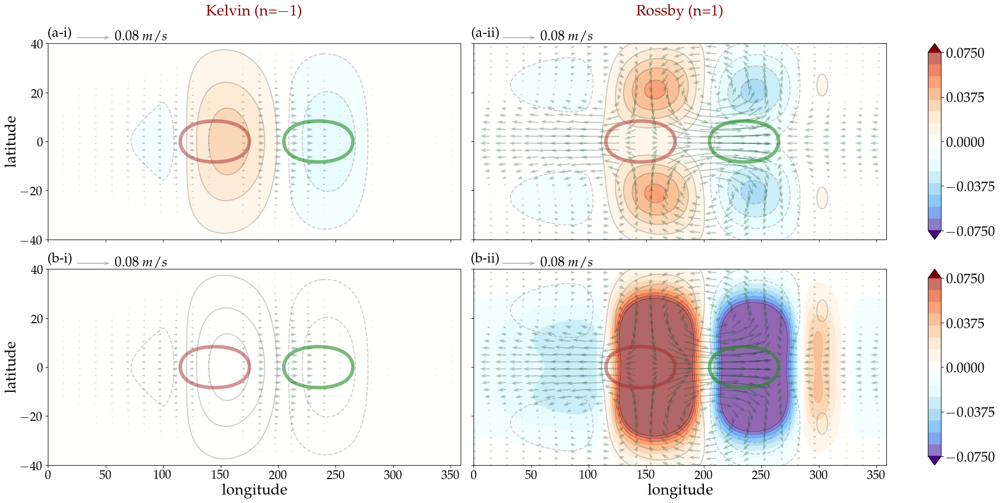

In [179]:
plot_divergence_budget_decomposition_Kelvin_Rossby_for_small_U(dicti  = master_dict['500_0'], umax=[0, 30], \
                                                             filename = 'div_mode_decompositon.pdf', save=False, N=19, \
                                                             figsize  = (20,10), vector=True, vector_scale=1, lo = 10, la=2, vector_max=0.08, \
                                                             LRANGEs  = [np.arange(-0.3, 0.34, 0.04)*1, np.arange(-0.3, 0.34, 0.04)*2])

In [240]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
        ["maroon", "orangered", "sandybrown", "bisque",  "white", "lightcyan", "skyblue", "dodgerblue", "indigo"][::-1])

def vectors(uu, vv, lonn, latt, AX, mag, vector_scale):   
    Q    = AX.quiver(lonn, latt, uu, vv, mag, cmap='gray', \
                     alpha=0.5, headwidth=4, headlength=6, width=0.00015*16, scale=vector_scale, \
                     minlength=0)
    AX.quiverkey(Q, 0.15, 1.03, mag, r'%1.2f $m/s$'%(mag), labelpos='E', coordinates='axes', fontproperties = {'size':20}, labelcolor='k',  linewidth = 2)
    return Q, mag


def plot_divergence_budget_decomposition_rot_div(dicti = master_dict['500_0'], umax=10, filename='raw_eddies_500.pdf', save=False, N=10, figsize=(25,8), vector=False):
    
    
        def Lrange(Y, dy=10):
            mini = np.abs(np.min(Y))
            maxi = np.abs(np.max(Y))
            maxi = np.round((np.max([(mini), (maxi)])), 1)
            range_values = np.linspace(-maxi, maxi, dy)
            return range_values


        grav = 9.8
        R = 6371e3 
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "indianred", "orange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])
                
        umax_values = (umax) #np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())])[start:end][::step]
        H0_values   = np.sort([int(np.max(dicti['raw_field_dict'][str(key)]['phi_T']/grav)) for key in umax_values])

        col = 3
        row = 2 #len(umax_values)
        fig, axss = py.subplots(row, col, figsize=figsize, constrained_layout=True, sharex=True, sharey=True)

        axs = axss.flatten()
        
        
        UMAX     = umax_values
        keys     = ['beta_term_rot', 'hadley_term_rot', 'zonal_wind_term_rot',\
                    'beta_term_div', 'hadley_term_div', 'zonal_wind_term_div',]
        
        alphabet = list(string.ascii_lowercase)
        roman_numerals = ['i', 'ii', 'iii']
#         labels = alphabet
        
        labels = []
        for alpha in alphabet :
            for rn in roman_numerals:
                labels.append( '('+alpha+'-'+rn+')' )
    
        deno = '/'+dicti['vrt_var_name']['ZETA_a']
        var_names = ['Sverdrup effect', 'Hadley Cell advection', 'Zonal wind advection' ]
        units    = [r'$m/s$', r'$m/s$', r'$m/s$', r'$m/s$']   

          
        R= 6371e3
        c = -1 ; r=-1 
        for Umax in (UMAX) :
            r =r+1
            
            co = -1
            for KEY in keys:
                
                co = co+1
                c = c+1
                AX = axs[c]
                
                U_name         = r'U$_{\textrm{jet}}$ = %1d m/s'%(Umax)  
                ds             = dicti['raw_field_dict'][str(Umax)]
                de             = dicti['vrt_budget_dict'][str(Umax)]
                dv_decomp      = dicti['veloc_decomp_dict'][str(Umax)]
                ds_modes       = dicti['mode_decomposition'][str(Umax)] 
                de_rot_div     = dicti['vrt_budget_rot_div_dict'][str(Umax)]
                SCALE  = R
                
                if Umax < 40:
                    LRANGE = np.arange(-0.3, 0.34, 0.04)*1  
                else:
                    LRANGE = np.arange(-0.3, 0.34, 0.04)*2 
                ticks = [np.min(LRANGE),   \
                         np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.25, \
                         np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.50, \
                         np.min(LRANGE)+(np.max(LRANGE)- np.min(LRANGE))*0.75, \
                         np.max(LRANGE)]

                field  = SCALE*eddy(de_rot_div[KEY]/de['ZETA_a'])
                smooth_field = savgol_filter(field, N, 3, axis=0)
                im = AX.contourf( ds['lon'],  ds['lat'], smooth_field, LRANGE,  cmap=cmap2, extend='both', alpha=0.6)
                
                
                field0  = SCALE*eddy(de_rot_div['ZETA_a_D']/de['ZETA_a'])
                smooth_field0 = savgol_filter(field0, N, 3, axis=0)                
                AX.contour( ds['lon'],  ds['lat'], smooth_field0, LRANGE[::1],  colors='gray', alpha=0.4)
        
        
                field  = eddy(ds['phi_forcing'])
                LRANGE = Lrange(field, 20) 
                phi_ticks = [np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.00, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.25, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*0.75, \
                             np.min(LRANGE)+(np.max(LRANGE) - np.min(LRANGE))*1.00,]


                AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[2]],  colors='brown',         linewidths=5, linestyles='solid', alpha=0.5) 
                AX.contour( ds['lon'],  ds['lat'], field,  [phi_ticks[1]],  colors='forestgreen',   linewidths=5, linestyles='solid', alpha=0.6) 

                if Umax>0 :            
                    field  = np.nanmean(ds['U'], axis=-1)[:,None]+ds['U']*0
                    AX.contour( ds['lon'],  ds['lat'], field,  [np.nanmax(field)/(1+1e-7)],  colors='gray',   linewidths=2, linestyles='dotted', alpha=0.7) 


                AX.set_ylim(-40,40)

                AX.text(0.15, 0.85, labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=20)
                AX.tick_params(labelsize=18)
                AX.set_xlabel(None, size=22,  labelpad=0.9)
                AX.set_ylabel(None, size=22,  labelpad=0.6)
                
                
        cbar = fig.colorbar(im, ax=axs.ravel().tolist(), location='right', aspect=15, shrink=1, ticks=ticks)
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(20)
                
        for AX, vname in zip(axss[0,:], var_names):
            AX.text(0.5,1.15, vname, horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=25, rotation=0, color='maroon')
            
        axss[0,0].text(-0.25, 0.5, 'Rotational winds',   horizontalalignment='center', verticalalignment='center', transform = axss[0,0].transAxes, fontsize=25, rotation=90, color='maroon')
        axss[1,0].text(-0.25, 0.5, 'Divergent winds', horizontalalignment='center', verticalalignment='center', transform = axss[1,0].transAxes, fontsize=25, rotation=90, color='maroon')

        ### To set common x and y axis ###
        py.setp(axss[row-1,:],  xlabel='longitude',)
        py.setp(axss[:,0],      ylabel='latitude',)

        fig.show()
        
        if save:
            h5saveload.make_sure_path_exists(('./%s_figures/'%(today_date)))
            py.savefig(('./%s_figures/'%(today_date))+filename, pad_inches=0.5, bbox_inches='tight')


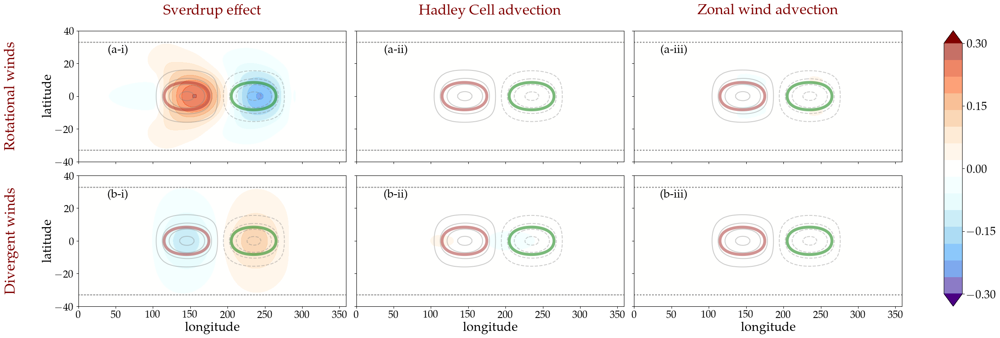

In [241]:
plot_divergence_budget_decomposition_rot_div(dicti = master_dict['500_0'], umax=[10], \
                                     filename='div_eddies_decomp_rot_div_500_10ms.pdf', \
                                     save=True, N=19, figsize=(24,8), vector=False, )

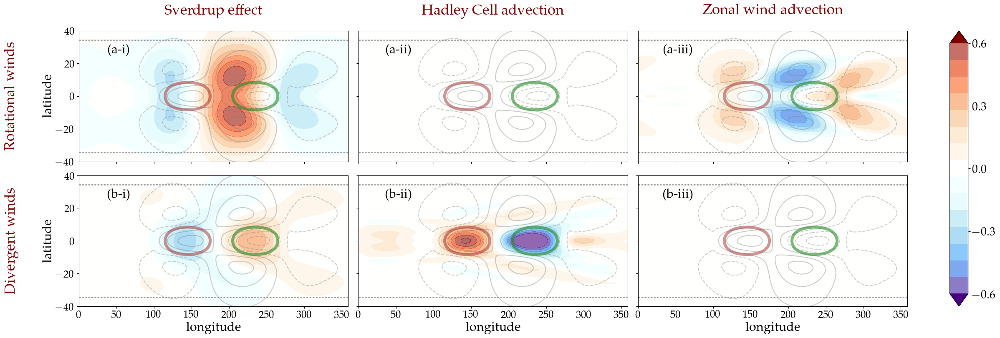

In [143]:
plot_divergence_budget_decomposition_rot_div(dicti = master_dict['500_0'], umax=[60], \
                                     filename='div_eddies_decomp_rot_div_500_60ms.pdf', \
                                     save=True, N=19, figsize=(24,8), vector=False, )

In [74]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

def plot_div_budget_line_plots(dicti = master_dict['500_0'], step=4, filename='div_line_500.pdf', save=False, mid=22, N=19, figsize=(28,8)):

        grav = 9.8
        R = 6371e3 
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "maroon", "darkorange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])
        
        fig, axs = py.subplots(2, 4, figsize=figsize, constrained_layout=True, sharex=True)

        axss = axs.flatten()
        
        umax_values = np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())]) #[start:end][::step]
        H0_values   = np.sort([int(np.max(dicti['raw_field_dict'][str(key)]['phi_T']/grav)) for key in umax_values])

        
        
        
        keys     = ['ZETA_a_D', 'beta_term', 'hadley_term', 'zonal_wind_term']
        alphabet = list(string.ascii_lowercase)
        roman_numerals = ['i', 'ii', 'iii', 'iv']
        
        labels = []
        for alpha in alphabet :
            for rn in roman_numerals:
                labels.append( '('+alpha+'-'+rn+')' ) # [('('+alpha+')') for alpha in alphabet]
    
        deno = '/'+dicti['vrt_var_name']['ZETA_a']
        var_name = ['Eddy divergence', 'Sverdrup effect', 'Hadley Cell advection', 'Zonal wind advection' ] #. ##[r'$R \overrightarrow{\nabla}.{\overrightarrow{u}}^{*}$', r'$R ({du^{*}}/{dx})$', r'$R ({dv^{*}}/{dy})$']
        units    = [r'$m/s$', r'$m/s$', r'$m/s$', r'$m/s$']        
        

        cmap2=py.get_cmap("rainbow")

        def plot_lines( UMAX = umax_values, AX0=axs[0,:]):
        
                R= 6371e3
                c = -1
                for key in tqdm(keys):  
                    c = c+1       
                    AX = AX0[c]   
                    for Umax, H0 in zip(UMAX, H0_values) :
                        ds     = dicti['raw_field_dict'][str(Umax)]
                        de     = dicti['vrt_budget_dict'][str(Umax)]
                        SCALE  = R
                        LRANGE = np.arange(-0.3, 0.32, 0.02); 

                        norm = float(Umax)/np.max(umax_values)

                        field  = SCALE*eddy(de[key]/de['ZETA_a'])
                        smooth_field = savgol_filter(field, N, 3, axis=0)   
                        
                        div_min, div_max = np.min(SCALE*eddy(de['div'])), np.max(SCALE*eddy(de['div']))     
                        plotting_field = forcing_region( smooth_field , ds['phi_forcing'], sign=1, scale=1000)   

                        im = AX.plot( ds['lat'],  np.nanmean(plotting_field, axis=-1), c = cmap2(norm), lw=4) 

                    AX.set_xlim(-20,20)
#                     AX.set_ylim(div_min, div_max)
#                     AX.set_ylim(-0.3, 0.3, div_max)
                    AX.tick_params(labelsize=18)
                    AX.set_xlabel(None, size=22,  labelpad=0.9)
                    AX.set_ylabel(None, size=22,  labelpad=0.6)
                    AX.axhline(0, color='k')
                                        
        
        plot_lines( UMAX = umax_values[0 :mid][::step], AX0=axs[0,:])        
        plot_lines( UMAX = umax_values[mid:-1][::step], AX0=axs[1,:])
        
        c=-1
        for AX in axss:
            c=c+1
            AX.text(0.1, 0.9, labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22)
        for AX, vname in zip(axs[0,:], var_name):
            AX.set_ylim(-0.15, 0.15)
            AX.text(0.5,1.15, vname, horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=25, rotation=0, color='maroon')
        for AX in axs[1,:]:
            AX.set_ylim(-0.25, 0.25)
            
        axs[0,0].text(-0.25, 0.5, 'Weak jet',   horizontalalignment='center', verticalalignment='center', transform = axs[0,0].transAxes, fontsize=25, rotation=90, color='maroon')
        axs[1,0].text(-0.25, 0.5, 'Strong jet', horizontalalignment='center', verticalalignment='center', transform = axs[1,0].transAxes, fontsize=25, rotation=90, color='maroon')
            
    
        #######################################
        ## Add a colorbar for line plots ##
        value          = umax_values[::4]
        dvalue         = np.diff(value)[0]
        TICKS          = np.arange(value.min()+(dvalue/2), value.max()+(dvalue/2)+dvalue, dvalue)
        TICKS_mappable = np.arange(value.min()           , value.max()+dvalue*2         , dvalue)
        TICKS_STR      = ['%1d'%(v) for v in TICKS-dvalue/2]
                
        sm   = mpl.cm.ScalarMappable(cmap=cmap2, norm=mpl.colors.BoundaryNorm(TICKS_mappable, cmap2.N))
        cbar = fig.colorbar(sm, ax=axs.ravel().tolist(), location='right', aspect=40, shrink=1, ticks = value, pad=0.009)
        cbar.set_ticks(TICKS)
        cbar.set_ticklabels(TICKS_STR)
        #######################################
                
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(20)
        ## Add a colorbar ##

        ### To set common x and y axis ###
        py.setp(axs[1,:],  xlabel='latitude',)
        py.setp(axs[:,0],  ylabel='m/s',)

        cbar.set_label(r'$U_{\textrm{jet}} \ [m/s]$', \
                       y=1.05, rotation=0, fontsize=22, color='k')

        fig.show()
        
        if save:
            h5saveload.make_sure_path_exists(('./%s_figures/'%(today_date)))
            py.savefig(('./%s_figures/'%(today_date))+filename, pad_inches=0.5, bbox_inches='tight')


100%|██████████| 4/4 [00:00<00:00, 10.51it/s]


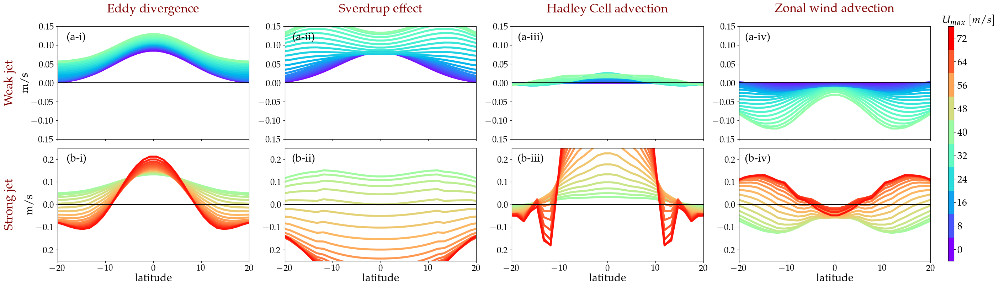

In [75]:
plot_div_budget_line_plots(dicti = master_dict['500_0'], step=1, filename='div_line_500.pdf', save=True, mid=22, N=19, figsize=(28,8))

In [71]:
master_dict['500_0']['vrt_budget_rot_div_dict']['0'].keys()

dict_keys(['D', 'ZETA_a', 'ZETA_a_D', 'beta_term_div', 'beta_term_rot', 'hadley_term_div', 'hadley_term_rot', 'lat', 'lon', 'zonal_wind_term_div', 'zonal_wind_term_rot'])

In [76]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

def plot_div_budget_line_plots_rot_div(dicti = master_dict['500_0'], step=4, filename='div_line_500.pdf', save=False, mid=22, N=19, figsize=(28,8), jet='weak'):

        grav = 9.8
        R = 6371e3 
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "maroon", "darkorange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])
        
        fig, axs = py.subplots(2, 3, figsize=figsize, constrained_layout=True, sharex=True, sharey=True)

        axss = axs.flatten()
        
        umax_values = np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())]) #[start:end][::step]
        H0_values   = np.sort([int(np.max(dicti['raw_field_dict'][str(key)]['phi_T']/grav)) for key in umax_values])

    
        keys     = ['beta_term_rot', 'hadley_term_rot', 'zonal_wind_term_rot', 'beta_term_div', 'hadley_term_div', 'zonal_wind_term_div']
        alphabet = list(string.ascii_lowercase)
        roman_numerals = ['i', 'ii', 'iii', 'iv']
        
        labels = []
        for alpha in alphabet :
            for rn in roman_numerals:
                labels.append( '('+alpha+'-'+rn+')' ) # [('('+alpha+')') for alpha in alphabet]
    
        deno = '/'+dicti['vrt_var_name']['ZETA_a']
        var_name = ['Sverdrup effect', 'Hadley Cell advection', 'Zonal wind advection' ] #. ##[r'$R \overrightarrow{\nabla}.{\overrightarrow{u}}^{*}$', r'$R ({du^{*}}/{dx})$', r'$R ({dv^{*}}/{dy})$']
        units    = [r'$m/s$', r'$m/s$', r'$m/s$', r'$m/s$']        
        

        cmap2=py.get_cmap("rainbow")

        def plot_lines( UMAX = umax_values, AX0=axss):
        
                R= 6371e3
                c = -1
                for key in tqdm(keys):  
                    c = c+1       
                    AX = AX0[c]   
                    for Umax, H0 in zip(UMAX, H0_values) :
                        ds     = dicti['raw_field_dict'][str(Umax)]
                        de     = dicti['vrt_budget_rot_div_dict'][str(Umax)]
                        SCALE  = R
                        LRANGE = np.arange(-0.3, 0.32, 0.02); 

                        norm = float(Umax)/np.max(umax_values)

                        field  = SCALE*eddy(de[key]/de['ZETA_a'])
                        smooth_field = savgol_filter(field, N, 3, axis=0)   
                           
                        plotting_field = forcing_region( smooth_field , ds['phi_forcing'], sign=1, scale=1000)   

                        im = AX.plot( ds['lat'],  np.nanmean(plotting_field, axis=-1), c = cmap2(norm), lw=4) 

                    AX.set_xlim(-20,20)
#                     AX.set_ylim(-0.3, 0.3, div_max)
                    AX.tick_params(labelsize=18)
                    AX.set_xlabel(None, size=22,  labelpad=0.9)
                    AX.set_ylabel(None, size=22,  labelpad=0.6)
                    AX.axhline(0, color='k')
                                        
        
        if jet == 'weak':
            plot_lines( UMAX = umax_values[0 :mid][::step], AX0=axss) 
            for AX in axss:
                AX.set_ylim(-0.28, 0.28)
        if jet == 'strong':
            plot_lines( UMAX = umax_values[mid:-1][::step], AX0=axss)
            
            # plot_lines( UMAX = umax_values[mid:-1][::step], AX0=axs[1,:])
        
        c=-1
        for AX in axss:
            c=c+1
            AX.text(0.1, 0.9, labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22)
        for AX, vname in zip(axs[0,:], var_name):
            AX.text(0.5,1.15, vname, horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=25, rotation=0, color='maroon')
            
        axs[0,0].text(-0.25, 0.5, 'Rotational winds',   horizontalalignment='center', verticalalignment='center', transform = axs[0,0].transAxes, fontsize=25, rotation=90, color='maroon')
        axs[1,0].text(-0.25, 0.5, 'Divergent winds', horizontalalignment='center', verticalalignment='center', transform = axs[1,0].transAxes, fontsize=25, rotation=90, color='maroon')
            
    
        #######################################
        ## Add a colorbar for line plots ##
        value          = umax_values[::4]
        dvalue         = np.diff(value)[0]
        TICKS          = np.arange(value.min()+(dvalue/2), value.max()+(dvalue/2)+dvalue, dvalue)
        TICKS_mappable = np.arange(value.min()           , value.max()+dvalue*2         , dvalue)
        TICKS_STR      = ['%1d'%(v) for v in TICKS-dvalue/2]
                
        sm   = mpl.cm.ScalarMappable(cmap=cmap2, norm=mpl.colors.BoundaryNorm(TICKS_mappable, cmap2.N))
        cbar = fig.colorbar(sm, ax=axs.ravel().tolist(), location='right', aspect=40, shrink=1, ticks = value, pad=0.009)
        cbar.set_ticks(TICKS)
        cbar.set_ticklabels(TICKS_STR)
        #######################################
                
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(20)
        ## Add a colorbar ##

        ### To set common x and y axis ###
        py.setp(axs[1,:],  xlabel='latitude',)
        py.setp(axs[:,0],  ylabel='m/s',)

        cbar.set_label(r'$U_{\textrm{jet}} \ [m/s]$', \
                       y=1.05, rotation=0, fontsize=22, color='k')

        fig.show()
        
        if save:
            h5saveload.make_sure_path_exists(('./%s_figures/'%(today_date)))
            py.savefig(('./%s_figures/'%(today_date))+filename, pad_inches=0.5, bbox_inches='tight')


100%|██████████| 6/6 [00:00<00:00,  8.94it/s]


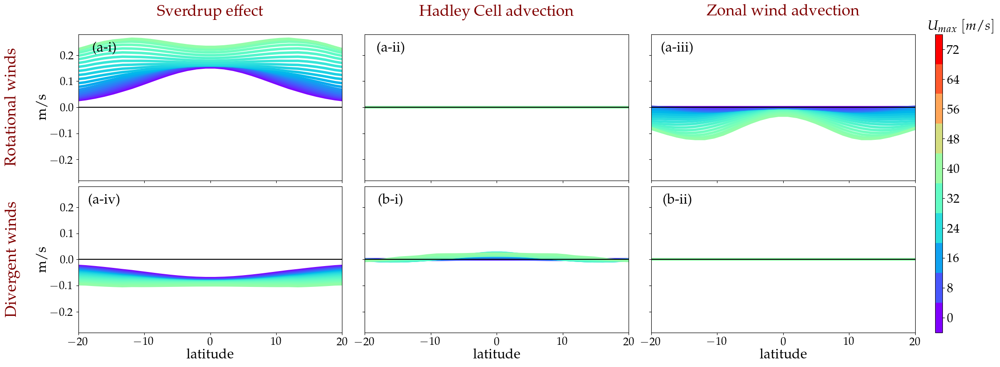

In [77]:
plot_div_budget_line_plots_rot_div(dicti = master_dict['500_0'], step=1, filename='div_line_500.pdf', save=False, mid=22, N=19, figsize=(22,8), jet='weak')

100%|██████████| 6/6 [00:00<00:00, 11.15it/s]


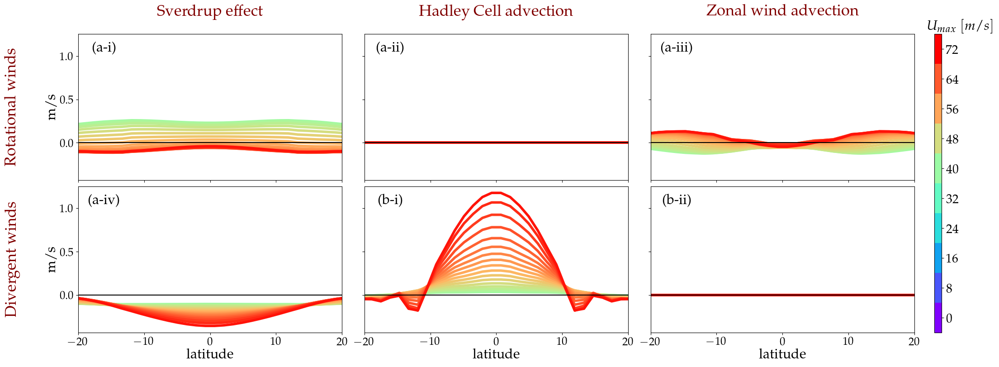

In [78]:
plot_div_budget_line_plots_rot_div(dicti = master_dict['500_0'], step=1, filename='div_line_500.pdf', save=True, mid=22, N=19, figsize=(22,8), jet='strong')

In [ ]:
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "maroon", "darkorange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])


fig, axs = py.subplots(2, 3, figsize=(22,12), sharey=True, sharex=True, constrained_layout=True)

UMAX = [0.5, 5, 10, 15, 20, 25, 30, 35, 40, 45,] ##45, 50, 55, 60, 65, 70, 75, 80, 83

UMAX_master = [0.5, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 83]


keys = ['beta_term_rot', 'hadley_term_rot', 'zonal_wind_term_rot', \
        'beta_term_div', 'hadley_term_div', 'zonal_wind_term_div']

var_name = {}
var_name['ZETA_a_D']             = r'$\left(D^{*}\right)$'
var_name['beta_term_rot']        = r'$-{v_{r}}^{*}\left(\partial_y{\overline{\zeta_a}}\right)/ \overline{\zeta_a}$'
var_name['beta_term_div']        = r'$-{v_{d}}^{*}\left(\partial_y{\overline{\zeta_a}}\right)/ \overline{\zeta_a}$'

var_name['hadley_term_rot']      = r'$-\partial_y\left({\overline{{V_{r}}}\zeta^{*}}\right)  / \overline{\zeta_a}$'
var_name['hadley_term_div']      = r'$-\partial_y\left({\overline{{V_{d}}}\zeta^{*}}\right)  / \overline{\zeta_a}$'

var_name['zonal_wind_term_rot']  = r'$-\partial_x\left({\overline{{U_{r}}}\zeta^{*}}\right)  / \overline{\zeta_a}$'
var_name['zonal_wind_term_div']  = r'$-\partial_x\left({\overline{{U_{d}}}\zeta^{*}}\right)  / \overline{\zeta_a}$'
  
cmap2=py.get_cmap("rainbow")

R= 6371e3
c = -1
for AX in tqdm(axs.flat):  
    c = c+1       
    key = keys[c]   
    for Umax in (UMAX) :
        ds  = return_fields_FOR_U(UMAX = Umax)
        dUV = return_fields_FOR_UV_decomp(UMAX=Umax)
        de  = vorticity_budget_new_rot_div(ds, dUV)
        
        SCALE  = R
        norm = float(Umax)/np.max(UMAX_master)
        forcing_region_field = forcing_region( SCALE*eddy(de[key])/de['ZETA_a'], ds['phi_forcing'], sign=1, scale=1000)
        im = AX.plot( ds['lat'],  np.nanmean(forcing_region_field, axis=-1), c = cmap2(norm), lw=4)   
    AX.axhline(0, color='k')
    AX.set_xlim(-20,20)
    AX.tick_params(labelsize=15)
    AX.set_xlabel(None, size=20,  labelpad=0.9)
    AX.set_ylabel(None, size=20,  labelpad=0.6)
    AX.set_title(var_name[key], fontsize=22)

## Add a colorbar ##
sm = mpl.cm.ScalarMappable(cmap=cmap2, norm=mpl.colors.BoundaryNorm(UMAX_master, cmap2.N))  
cbar = fig.colorbar(sm, ax=axs.ravel().tolist(), location='bottom', aspect=30, shrink=0.5)
for t in cbar.ax.get_xticklabels():
    t.set_fontsize(20)
## Add a colorbar ##
    
### To set common x and y axis ###
py.setp(axs[-1, :],  xlabel='latitude',)
py.setp(axs[ :, 0],  ylabel=r'[$ms^{-1}$]',)

### To set common x and y axis ###

### To set a label for color bar ###
cbar.set_label(r'U$_{\textrm{jet}}$ [$ms^{-1}$, colors]', \
               loc = 'center', labelpad=-90, y=1.05, rotation=0, fontsize=22, color='k')
fig.suptitle('Vorticity budget ', fontsize=22)
fig.show()


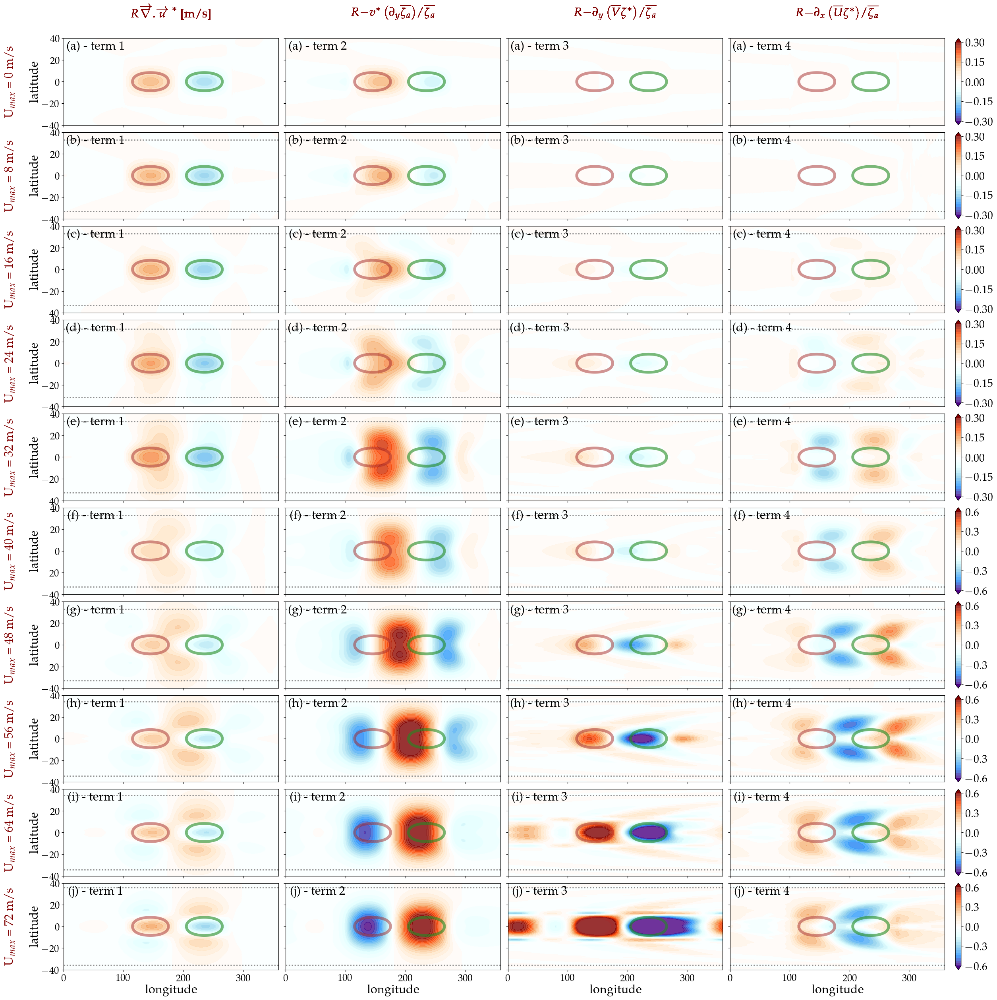

In [344]:
# plot_divergence_budget_decomposition(dicti = master_dict['500_0'], step=4, filename='raw_eddies_500.pdf', save=False, start=0, end=-1, N=19, figsize=(25,25))

In [ ]:
def plot_regimes_vorticity_terms(KEY = 'hadley_term'):
    
    py.figure(figsize=(20,6))

    py.subplot(1,2,1)
    umax_key = '10'
    modes_dict = u_v_phi_decomposed[umax_key]
    ds         = raw_field_dict[umax_key]
    de         = vorticity_budget_new(ds)
    de_modes   = vorticity_budget_with_modes_decomposition(ds, modes_dict)

    lrange = np.arange(-0.15, 0.18, 0.03)
    py.contourf(modes_dict['lon'], modes_dict['lat'], R*(de_modes[KEY]/de_modes['ZETA_a']).sum(axis=0), \
                lrange, cmap=cmap, extend='both', alpha=0.9); colorbar(25)
    c = py.contour (modes_dict['lon'], modes_dict['lat'], R*de_modes['div'].sum(axis=0), \
                lrange[::2], linewidths=2, colors='k'); #colorbar() #cmap=py.cm.seismic,
    py.clabel(c, lrange[::2],fmt='%1.2f', inline_spacing=0.5, fontsize=22)
    py.ylim(-20,20)
    py.tick_params(labelsize=25)
    py.xlabel('longitude', fontsize=25)
    py.ylabel('latitude', fontsize=25)

    py.subplot(1,2,2)
    umax_key = '70'
    modes_dict = u_v_phi_decomposed[umax_key]
    ds         = raw_field_dict[umax_key]
    de         = vorticity_budget_new(ds)
    de_modes   = vorticity_budget_with_modes_decomposition(ds, modes_dict)

    lrange = np.arange(-0.7, 0.8, 0.1)[::2]
    py.contourf(modes_dict['lon'], modes_dict['lat'], R*(de_modes[KEY]/de_modes['ZETA_a']).sum(axis=0), \
                lrange, cmap=cmap, extend='both', alpha=0.9, linewidths=2); colorbar(25)
    c=py.contour (modes_dict['lon'], modes_dict['lat'], R*de_modes['div'].sum(axis=0), \
                lrange,  linewidths=2, colors='k'); #colorbar() #cmap=py.cm.seismic,
    py.clabel(c, lrange,fmt='%1.2f',inline_spacing=2, fontsize=22)
    py.ylim(-20,20)
    py.tick_params(labelsize=25)
    py.xlabel('longitude', fontsize=25)
    py.ylabel('latitude', fontsize=25)
    
    py.tight_layout()
    
    py.savefig(KEY, dpi=300)
    
    

In [103]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      ["maroon", "orangered", "sandybrown", "bisque",  "white", "lightcyan", "skyblue", "dodgerblue", "indigo"][::-1])

R = 6371e3
def rms_near_equator(lat, lon, field, lat_bnd=20):
    forcing_region_field = tropical_mask(lat, lon, field,  0, lat_bnd)
    rms_div              = np.sqrt(np.nanmean(np.nanmean((forcing_region_field**2), axis=-1), axis=-1))
    return rms_div

def forcing_region(field, forcing, sign = 1, scale=4):    
    max_phi = np.max(forcing)/scale
    field   = ma.masked_where( sign*forcing < max_phi, field)
    return np.nanmean(field.filled(np.nan))

def plot_divergence_change_with_Umax(dicti = master_dict['500_0'], step=4, filename='raw_eddies_500.pdf', save=False):
    
    
        grav = 9.8
        R = 6371e3 
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              ["indianred", "orange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])
        
        umax_values = np.sort([int(i) for i in list(dicti['raw_field_dict'].keys())])[::step]
        H0_values   = np.sort([int(np.max(dicti['raw_field_dict'][str(key)]['phi_T']/grav)) for key in umax_values])

        col = 2
        row = 1
        fig, axss = py.subplots(row, col, figsize=(12,4), constrained_layout=True, sharex=True, sharey=False)

        axs = axss.T.flatten()

        UMAX = umax_values
        alphabet = list(string.ascii_lowercase)
        labels   = [('('+alpha+')') for alpha in alphabet]
        grav = 10

        R= 6371e3
        
        DIV_rms  = []
        DIVx_rms = []
        DIVy_rms = []
        
        DIV_force  = []
        DIVx_force = []
        DIVy_force = []
        
        DIV_force = []        
        c = -1
        for Umax in (UMAX) :
            
            var_name = r'U$_{\textrm{jet}}$ = %1d m/s'%(Umax)    
            ds       = dicti['raw_field_dict'][str(Umax)]
            de       = dicti['vrt_budget_dict'][str(Umax)]
            
            SCALE    = R 
            
            forcing  = ds['phi_forcing']
            field    = SCALE*eddy(de['div']) 
            DIV_rms.append( rms_near_equator(ds['lat'], ds['lon'], field) )
            DIV_force.append( forcing_region(field, forcing, sign = 1, scale=4)  )
            
            field    = SCALE*eddy(de['div_x'])
            DIVx_rms.append( rms_near_equator(ds['lat'], ds['lon'], field) )  
            DIVx_force.append( forcing_region(field, forcing, sign = 1, scale=4)  )

            field   = SCALE*eddy(de['div_y'])
            DIVy_rms.append( rms_near_equator(ds['lat'], ds['lon'], field) ) 
            DIVy_force.append( forcing_region(field, forcing, sign = 1, scale=4)  )

    
        c  = c+1
        AX = axs[c]
        
        DIV_rms = np.stack(DIV_rms)    
        AX.plot(UMAX,  DIV_rms, 'k-')  
        
        AX1 = AX.twinx()
        DIVx_rms = np.stack(DIVx_rms)    
        AX1.plot(UMAX,  DIVx_rms, 'r-') 
        
        DIVy_rms = np.stack(DIVy_rms)    
        AX1.plot(UMAX,  DIVy_rms, 'b-') 
        
        AX.text(0.03, 1.05,labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22)
        AX.tick_params(labelsize=18)
        
        c  = c+1
        AX = axs[c]
        
        DIV_force = np.stack(DIV_force)    
        AX.plot(UMAX,  DIV_force, 'k-')  
        
        AX2 = AX #.twinx()
        DIVx_force = np.stack(DIVx_force)    
        AX2.plot(UMAX,  DIVx_force, 'r-') 
        
        DIVy_force = np.stack(DIVy_force)    
        AX2.plot(UMAX,  DIVy_force, 'b-') 
            
#         AX.set_ylim(-60,60)
        AX.text(0.03, 1.05,labels[c], horizontalalignment='center', verticalalignment='center', transform = AX.transAxes, fontsize=22)
        AX.tick_params(labelsize=18)
#         AX.set_xlabel(None, size=22,  labelpad=0.9)
#         AX.set_ylabel(None, size=22,  labelpad=0.6)
#         AX.set_title(var_name, fontsize=22, color='maroon')
            
#       ### To set common x and y axis ###
#       py.setp(axss[row-1,:],  xlabel='longitude',)
#       py.setp(axss[:,0],      ylabel='latitude',)

        fig.show()
        
        if save:
            h5saveload.make_sure_path_exists('./Final_figures/')
            py.savefig('./Final_figures/'+filename, pad_inches=0.5, bbox_inches='tight')


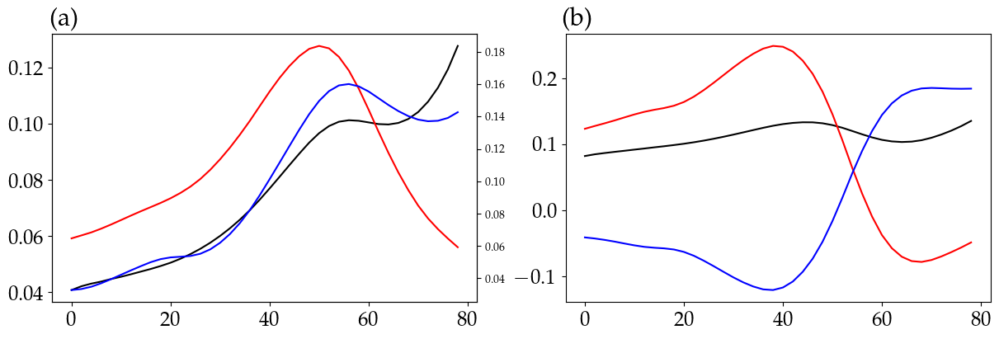

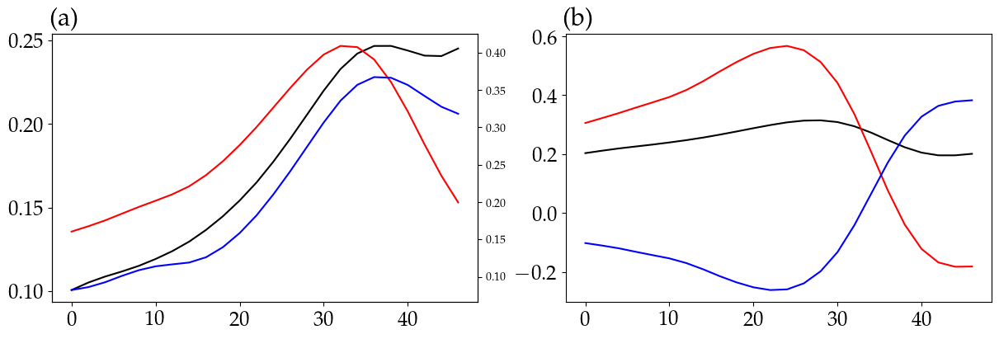

In [104]:
plot_divergence_change_with_Umax(dicti = master_dict['500_0'], step=1, filename='raw_eddies_500.pdf', save=False)

plot_divergence_change_with_Umax(dicti = master_dict['200_0'], step=1, filename='raw_eddies_500.pdf', save=False)

In [53]:
master_dict['500_0']['mode_decomposition']['0']['div_x'].shape

(128, 256)

## Look at vorticity budget and change in divergence

In [189]:
py.rcParams.update( {   "text.usetex": False,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

def plot_divergence_decomposition(dicti = master_dict['500_0']):

        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "maroon", "darkorange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])

        fig, axs = py.subplots(1, 3, figsize=(20,6), sharey=True, sharex=True, constrained_layout=True)

        umax_values = np.sort([int(i) for i in dicti['raw_field_dict'].keys()])
        # umax_str = [str(u) for u in umax_values]

        UMAX = umax_values
        keys = ['div', 'div_x', 'div_y', ]

        var_name = dicti['vrt_var_name']

        cmap2=py.get_cmap("rainbow")

        R= 6371e3
        c = -1
        for key in tqdm(keys):  
            c = c+1       
            AX = axs[c]   
            for Umax in (UMAX) :
                ds     = dicti['raw_field_dict'][str(Umax)]
                de     = dicti['vrt_budget_dict'][str(Umax)]
                SCALE  = R
                LRANGE = np.arange(-0.3, 0.32, 0.02); # lrange(de[key]*SCALE) 

                norm = float(Umax)/np.max(umax_values)
                forcing_region_field = forcing_region( SCALE*eddy(de[key]), ds['phi_forcing'], sign=1, scale=1000)
                im = AX.plot( ds['lat'],  np.nanmean(forcing_region_field, axis=-1), c = cmap2(norm), lw=)   
            AX.axhline(0, color='k')
            AX.set_xlim(-20,20)
            AX.tick_params(labelsize=15)
            AX.set_xlabel(None, size=20,  labelpad=0.9)
            AX.set_ylabel(None, size=20,  labelpad=0.6)
            AX.set_title(var_name[key], fontsize=22)

            # sm = py.cm.ScalarMappable(cmap=cmap2, norm=mpl.colors.BoundaryNorm(UMAX, cmap2.N))  
            # colorbar2(fontsize=20, im=sm, AX=AX, fig=fig, )

        ## Add a colorbar ##
        sm = mpl.cm.ScalarMappable(cmap=cmap2, norm=mpl.colors.BoundaryNorm(UMAX, cmap2.N))  
        cbar = fig.colorbar(sm, ax=axs.ravel().tolist(), location='bottom', aspect=30, shrink=0.5)
        for t in cbar.ax.get_xticklabels():
            t.set_fontsize(20)
        ## Add a colorbar ##

        ### To set common x and y axis ###
        py.setp(axs[:],  xlabel='latitude',)
        py.setp(axs[0],  ylabel='Scaled Divergence \n near forcing',)
        ### To set common x and y axis ###

        ### To set a label for color bar ###
        cbar.set_label(r'U$_{\textrm{jet}}$ [$ms^{-1}$, colors]', \
                       loc = 'center', labelpad=-90, y=1.05, rotation=0, fontsize=22, color='k')
        fig.show()


100%|██████████| 3/3 [00:00<00:00, 16.08it/s]
findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'serif' not found because none of the following families were found: Palatino
findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'serif' not found because none of the following families were found: Palatino
findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'serif' not found because none of the following families were found: Palatino


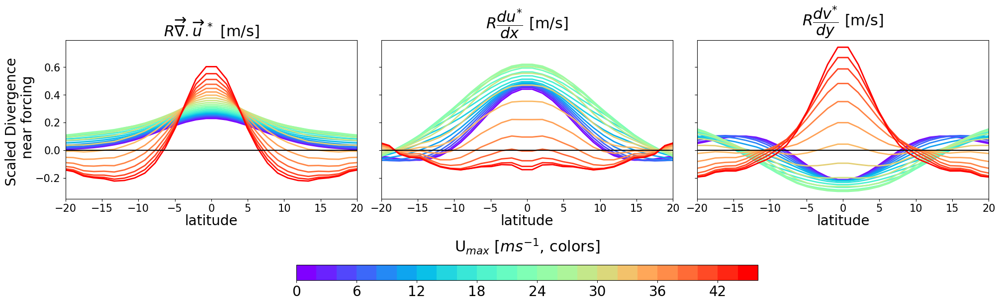

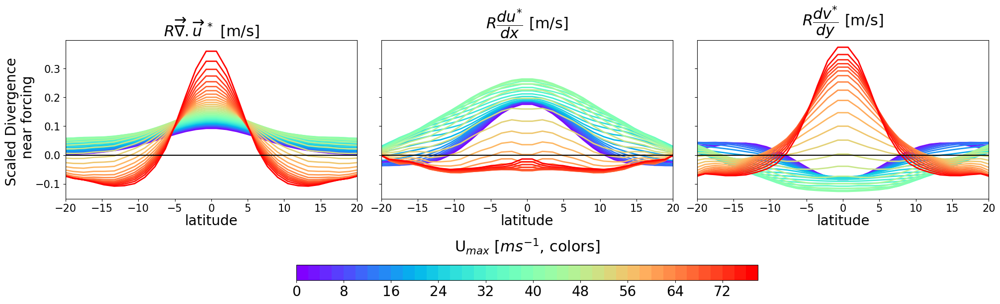

In [190]:
plot_divergence_decomposition(dicti = master_dict['200_0'])
plot_divergence_decomposition(dicti = master_dict['500_0'])

100%|██████████| 3/3 [00:00<00:00, 20.17it/s]


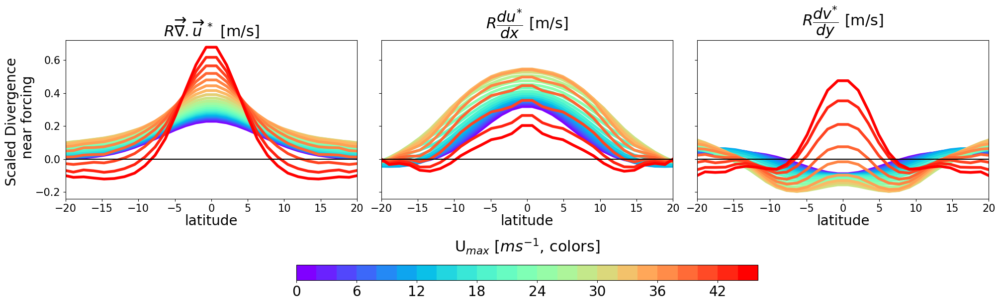

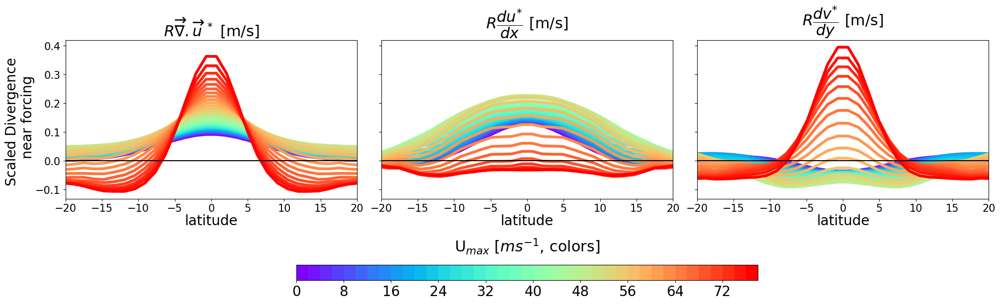

In [102]:
plot_divergence_decomposition(dicti = master_dict['200_5'])
plot_divergence_decomposition(dicti = master_dict['500_5'])

In [177]:
master_dict['200_0']['vrt_var_name']['zonal_wind_term']

'$-\\partial_x\\left({\\overline{U}\\zeta^{*}}\\right)$'

In [216]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

def plot_vrt_budget_regime1(dicti = master_dict['200_0']):

        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "maroon", "darkorange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])

        fig, axs = py.subplots(1, 5, figsize=(25,6), sharey=True, sharex=True, constrained_layout=True)

        umax_values = np.sort([int(i) for i in dicti['raw_field_dict'].keys()])
        umax_values = umax_values[:len(umax_values)//2]
        UMAX = umax_values

        keys = ['ZETA_a_D', 'beta_term', 'hadley_term', 'zonal_wind_term', 'cf_term']

        var_name            = dicti['vrt_var_name']
        var_name['cf_term'] = '$\\partial_x\\left({{c_f}\\zeta^{*}}\\right)$'
        
        cmap2=py.get_cmap("rainbow")

        R= 6371e3
        c = -1
        for key in tqdm(keys):  
            c = c+1       
            AX = axs[c]   
            for Umax in (UMAX) :
                ds     = dicti['raw_field_dict'][str(Umax)]
                de     = dicti['vrt_budget_dict'][str(Umax)]
                SCALE  = R
                LRANGE = np.arange(-0.3, 0.32, 0.02); # lrange(de[key]*SCALE) 

                norm = float(Umax)/np.max(umax_values)
                forcing_region_field = forcing_region( SCALE*eddy(de[key])/de['ZETA_a'], ds['phi_forcing'], sign=1, scale=1000)
                im = AX.plot( ds['lat'],  np.nanmean(forcing_region_field, axis=-1), c = cmap2(norm), lw=4)   
            AX.axhline(0, color='k')
            AX.set_xlim(-20,20)
            AX.tick_params(labelsize=15)
            AX.set_xlabel(None, size=20,  labelpad=0.9)
            AX.set_ylabel(None, size=20,  labelpad=0.6)
            AX.set_title(var_name[key]+'$/\overline{\zeta_a}$', fontsize=22)

            # sm = py.cm.ScalarMappable(cmap=cmap2, norm=mpl.colors.BoundaryNorm(UMAX, cmap2.N))  
            # colorbar2(fontsize=20, im=sm, AX=AX, fig=fig, )

        ## Add a colorbar ##
        sm = mpl.cm.ScalarMappable(cmap=cmap2, norm=mpl.colors.BoundaryNorm(UMAX, cmap2.N))  
        cbar = fig.colorbar(sm, ax=axs.ravel().tolist(), location='bottom', aspect=30, shrink=0.5)
        for t in cbar.ax.get_xticklabels():
            t.set_fontsize(20)
        ## Add a colorbar ##

        ### To set common x and y axis ###
        py.setp(axs[:],  xlabel='latitude',)
        py.setp(axs[0],  ylabel='Scaled Divergence \n near forcing',)
        ### To set common x and y axis ###

        ### To set a label for color bar ###
        cbar.set_label(r'U$_{\textrm{jet}}$ [$ms^{-1}$, colors]', \
                       loc = 'center', labelpad=-90, y=1.05, rotation=0, fontsize=22, color='k')
        fig.show()


100%|██████████| 5/5 [00:00<00:00, 35.16it/s]


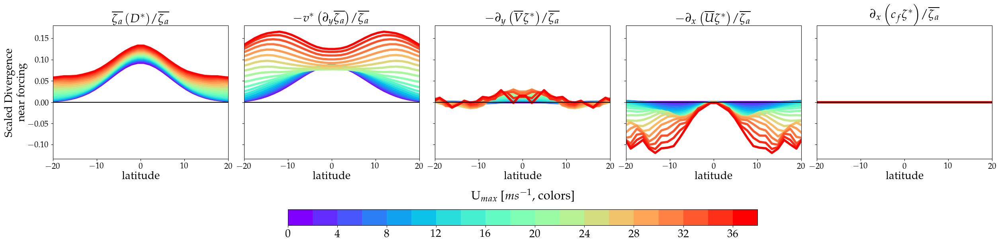

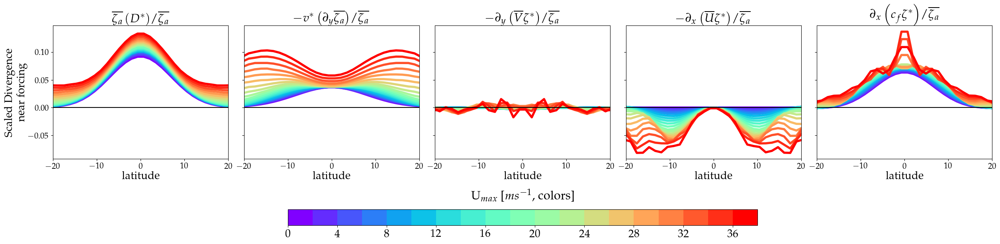

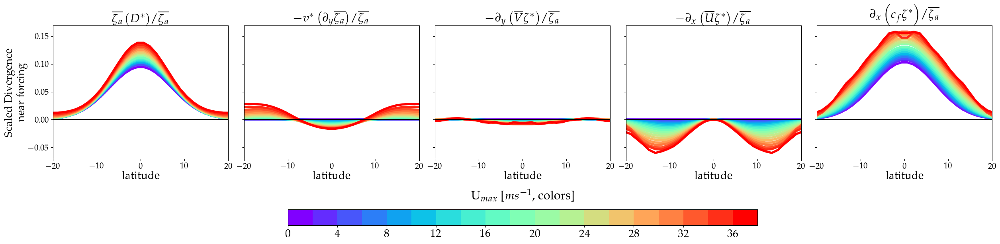

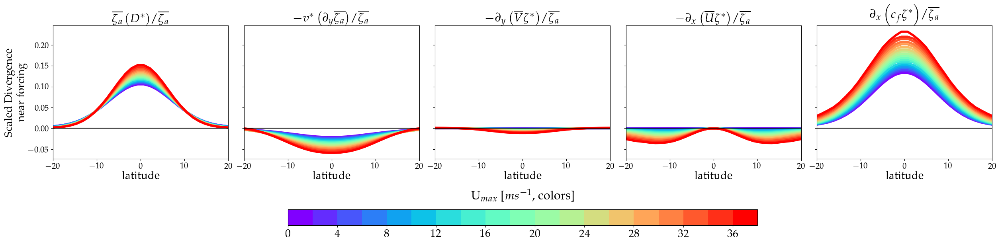

In [217]:
plot_vrt_budget_regime1(dicti =   master_dict['500_0'])
plot_vrt_budget_regime1(dicti =   master_dict['500_5'])
plot_vrt_budget_regime1(dicti =  master_dict['500_15'])
plot_vrt_budget_regime1(dicti =  master_dict['500_30'])

100%|██████████| 5/5 [00:00<00:00, 67.75it/s]


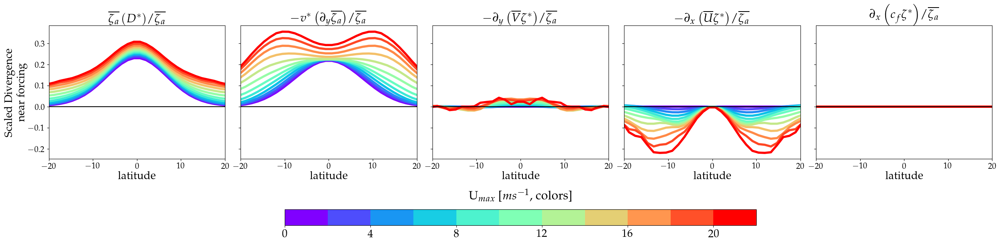

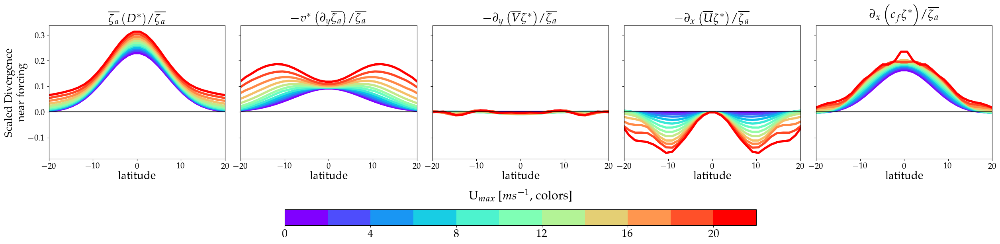

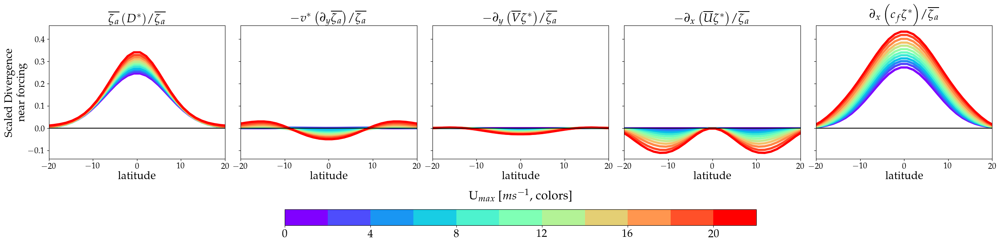

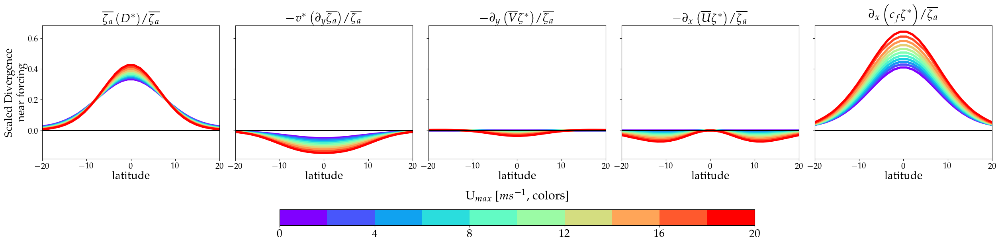

In [183]:
plot_vrt_budget_regime1(dicti =  master_dict['200_0'])
plot_vrt_budget_regime1(dicti =  master_dict['200_5'])
plot_vrt_budget_regime1(dicti = master_dict['200_15'])
plot_vrt_budget_regime1(dicti = master_dict['200_30'])

In [211]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

def plot_vrt_budget_regime2(dicti = master_dict['200_0'], yl=1):

        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "maroon", "darkorange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])

        fig, axs = py.subplots(1, 5, figsize=(25,6), sharey=True, sharex=True, constrained_layout=True)

        umax_values = np.sort([int(i) for i in dicti['raw_field_dict'].keys()])
        umax_values = umax_values[len(umax_values)//2 : ]
        UMAX = umax_values

        keys = ['ZETA_a_D', 'beta_term', 'hadley_term', 'zonal_wind_term', 'cf_term']

        var_name            = dicti['vrt_var_name']
        var_name['cf_term'] = '$\\partial_x\\left({{c_f}\\zeta^{*}}\\right)$'
        
        cmap2=py.get_cmap("rainbow")

        R= 6371e3
        c = -1
        for key in tqdm(keys):  
            c = c+1       
            AX = axs[c]   
            for Umax in (UMAX) :
                ds     = dicti['raw_field_dict'][str(Umax)]
                de     = dicti['vrt_budget_dict'][str(Umax)]
                SCALE  = R
                LRANGE = np.arange(-0.3, 0.32, 0.02); # lrange(de[key]*SCALE) 

                norm = float(Umax)/np.max(umax_values)
                forcing_region_field = forcing_region( SCALE*eddy(de[key])/de['ZETA_a'], ds['phi_forcing'], sign=1, scale=1000)
                im = AX.plot( ds['lat'],  np.nanmean(forcing_region_field, axis=-1), c = cmap2(norm), lw=4)   
            AX.axhline(0, color='k')
            AX.set_ylim(-yl, yl)
            AX.set_xlim(-20,20)
            AX.tick_params(labelsize=15)
            AX.set_xlabel(None, size=20,  labelpad=0.9)
            AX.set_ylabel(None, size=20,  labelpad=0.6)
            AX.set_title(var_name[key]+'$/\overline{\zeta_a}$', fontsize=22)

            # sm = py.cm.ScalarMappable(cmap=cmap2, norm=mpl.colors.BoundaryNorm(UMAX, cmap2.N))  
            # colorbar2(fontsize=20, im=sm, AX=AX, fig=fig, )

        ## Add a colorbar ##
        sm = mpl.cm.ScalarMappable(cmap=cmap2, norm=mpl.colors.BoundaryNorm(UMAX, cmap2.N))  
        cbar = fig.colorbar(sm, ax=axs.ravel().tolist(), location='bottom', aspect=30, shrink=0.5)
        for t in cbar.ax.get_xticklabels():
            t.set_fontsize(20)
        ## Add a colorbar ##

        ### To set common x and y axis ###
        py.setp(axs[:],  xlabel='latitude',)
        py.setp(axs[0],  ylabel='Scaled Divergence \n near forcing',)
        ### To set common x and y axis ###

        ### To set a label for color bar ###
        cbar.set_label(r'U$_{\textrm{jet}}$ [$ms^{-1}$, colors]', \
                       loc = 'center', labelpad=-90, y=1.05, rotation=0, fontsize=22, color='k')
        fig.show()


100%|██████████| 5/5 [00:00<00:00, 37.93it/s]


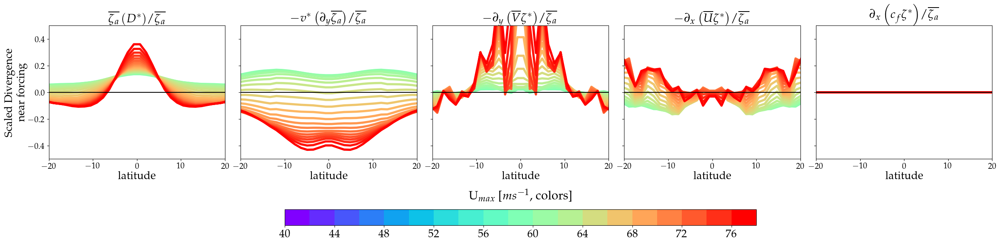

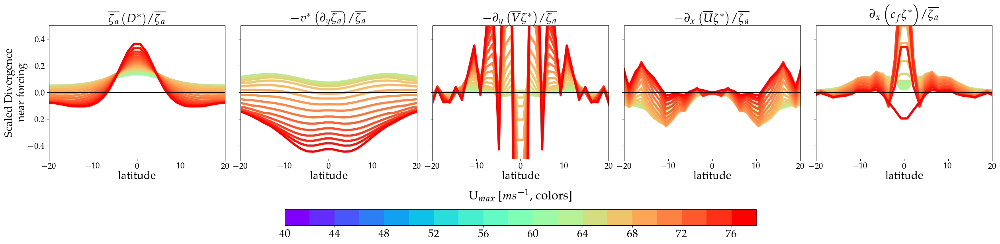

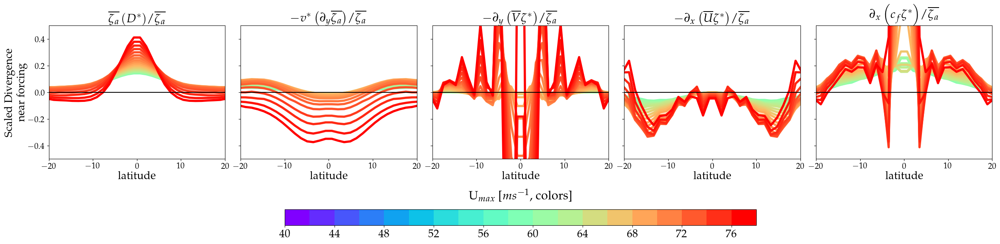

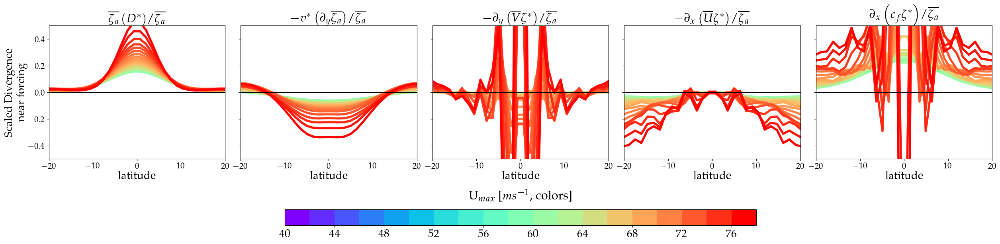

In [212]:
plot_vrt_budget_regime2(dicti =   master_dict['500_0'], yl=0.5)
plot_vrt_budget_regime2(dicti =   master_dict['500_5'], yl=0.5)
plot_vrt_budget_regime2(dicti =  master_dict['500_15'], yl=0.5)
plot_vrt_budget_regime2(dicti =  master_dict['500_30'], yl=0.5)

100%|██████████| 5/5 [00:00<00:00, 50.08it/s]


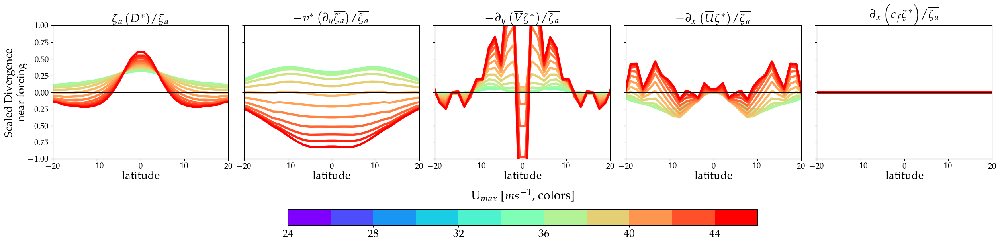

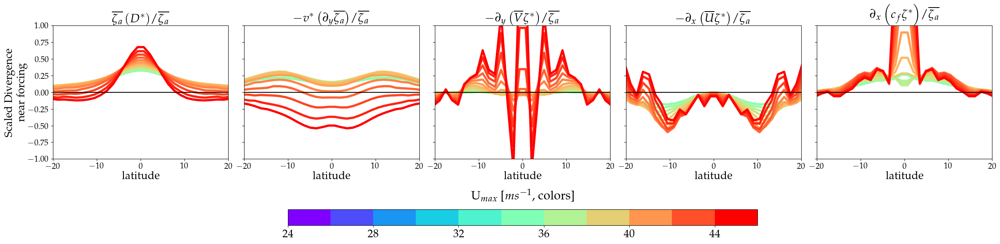

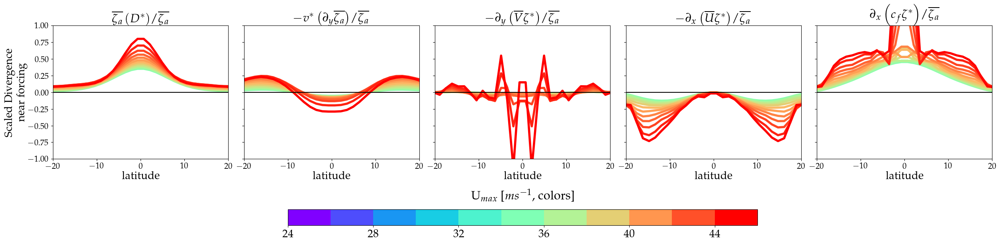

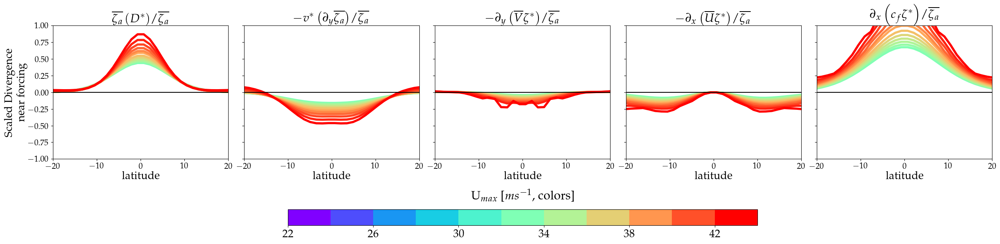

In [213]:
plot_vrt_budget_regime2(dicti =   master_dict['200_0'], yl=1)
plot_vrt_budget_regime2(dicti =   master_dict['200_5'], yl=1)
plot_vrt_budget_regime2(dicti =  master_dict['200_15'], yl=1)
plot_vrt_budget_regime2(dicti =  master_dict['200_30'], yl=1)

In [239]:
dicti['vrt_var_name']['ZETA_a_D']

'$\\overline{\\zeta_a} \\left(D^{*}\\right)$'

In [242]:
py.rcParams.update( {   "text.usetex": True,
                        "font.family": "serif",
                        "font.serif": ["Palatino"] } )

def plot_vrt_budget_regime1_modify(dicti = master_dict['200_0'], yl=0.5):

        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
              [  "maroon", "darkorange", "pink", "white", "white","skyblue", "dodgerblue", "navy"][::-1])

        fig, axs = py.subplots(1, 4, figsize=(25,6), sharey=True, sharex=True, constrained_layout=True)

        umax_values = np.sort([int(i) for i in dicti['raw_field_dict'].keys()])
        umax_values = umax_values[:len(umax_values)//2]
        UMAX = umax_values

        keys = ['ZETA_a_D', 'beta_term', 'hadley_term', 'zonal_wind_term_minus_cf']

        var_name            = dicti['vrt_var_name']
        var_name['zonal_wind_term_minus_cf'] = '$-\\partial_x\\left({   (\\overline{U} - c_f)   \\zeta^{*}}\\right)$'
        
        cmap2=py.get_cmap("rainbow")

        R= 6371e3
        c = -1
        for key in tqdm(keys):  
            c = c+1       
            AX = axs[c]   
            for Umax in (UMAX) :
                ds     = dicti['raw_field_dict'][str(Umax)]
                de     = dicti['vrt_budget_dict'][str(Umax)]
                SCALE  = R
                LRANGE = np.arange(-0.3, 0.32, 0.02); # lrange(de[key]*SCALE) 

                norm = float(Umax)/np.max(umax_values)
                if key == 'zonal_wind_term_minus_cf':
                    plot_field = de['zonal_wind_term'] + de['cf_term']
                else:
                    plot_field = de[key]
                    
                forcing_region_field = forcing_region( SCALE*eddy(plot_field)/de['ZETA_a'], ds['phi_forcing'], sign=1, scale=1000)
                im = AX.plot( ds['lat'],  np.nanmean(forcing_region_field, axis=-1), c = cmap2(norm), lw=4)   
            AX.axhline(0, color='k')
            AX.set_xlim(-20,20)
            AX.tick_params(labelsize=15)
            AX.set_xlabel(None, size=20,  labelpad=0.9)
            AX.set_ylabel(None, size=20,  labelpad=0.6)
            
            if key == 'ZETA_a_D':
                tit = '$\\left(D^{*}\\right)$'
            else:
                tit = var_name[key]+'$/\overline{\zeta_a}$'
            AX.set_title(tit, fontsize=22)

        ## Add a colorbar ##
        sm = mpl.cm.ScalarMappable(cmap=cmap2, norm=mpl.colors.BoundaryNorm(UMAX, cmap2.N))  
        cbar = fig.colorbar(sm, ax=axs.ravel().tolist(), location='bottom', aspect=30, shrink=0.5)
        for t in cbar.ax.get_xticklabels():
            t.set_fontsize(20)
        ## Add a colorbar ##

        ### To set common x and y axis ###
        py.setp(axs[:],  xlabel='latitude',)
        py.setp(axs[0],  ylabel='Scaled Divergence \n near forcing',)
        ### To set common x and y axis ###

        ### To set a label for color bar ###
        cbar.set_label(r'U$_{\textrm{jet}}$ [$ms^{-1}$, colors]', \
                       loc = 'center', labelpad=-90, y=1.05, rotation=0, fontsize=22, color='k')
        fig.show()


100%|██████████| 4/4 [00:00<00:00, 38.17it/s]


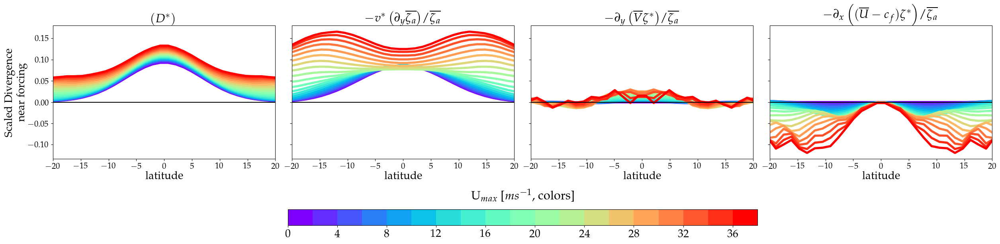

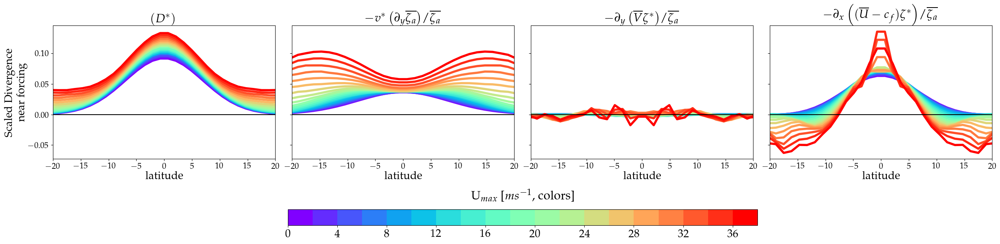

In [ ]:
plot_vrt_budget_regime1_modify(dicti =   master_dict['500_0'], yl=0.5)
plot_vrt_budget_regime1_modify(dicti =   master_dict['500_5'], yl=0.5)
plot_vrt_budget_regime1_modify(dicti =  master_dict['500_15'], yl=0.5)
plot_vrt_budget_regime1_modify(dicti =  master_dict['500_30'], yl=0.5)